# Embedding and train process

In [ ]:
# Check GPU
!nvidia-smi

# Core libs (GPU-ready)
%pip -q install -U torch --index-url https://download.pytorch.org/whl/cu121
%pip -q install -U sentence-transformers open-clip-torch pillow tqdm huggingface_hub

# Index backends (FAISS preferred; hnswlib as fallback)
%pip -q install -U faiss-cpu hnswlib

Thu Sep 11 00:14:13 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   76C    P0             32W /   70W |    2974MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from pathlib import Path
BASE = Path("/content/drive/MyDrive/NLP/HW3")

In [ ]:
JSON_IN = BASE / "athlete_merged_with_bios_imaged_crawled.json"
IMG_DIR = BASE / "athlete_images"

OUT_DIR    = BASE / "rag_out"
OUT_DIR.mkdir(parents=True, exist_ok=True)

TEXT_INDEX = OUT_DIR / "faiss_text.idx"
IMG_INDEX  = OUT_DIR / "faiss_image.idx"
DOCS_MAP   = OUT_DIR / "docs.jsonl"

print("JSON exists:", JSON_IN.exists(), JSON_IN)
print("IMG_DIR exists:", IMG_DIR.exists(), IMG_DIR)
print("OUT_DIR:", OUT_DIR)

JSON exists: True /content/drive/MyDrive/NLP/HW3/athlete_merged_with_bios_imaged_crawled.json
IMG_DIR exists: True /content/drive/MyDrive/NLP/HW3/athlete_images
OUT_DIR: /content/drive/MyDrive/NLP/HW3/rag_out


In [ ]:
import json, re
from pathlib import Path
from PIL import Image

In [ ]:
def sanitize_filename(s: str) -> str:
    s = (str(s) or "").strip()
    s = re.sub(r"\s+", "_", s)
    s = re.sub(r"[^\w\-.]+", "", s)
    return s or "image"

def keep_priority_key(name: str) -> tuple:
    # _crawled > _imageN (lower N) > _image.<ext> > lexicographic
    m = re.search(r"_image(\d+)\b", name.lower())
    n = int(m.group(1)) if m else 10**9
    return (0 if "_crawled" in name.lower() else 1,
            n,
            0 if "_image." in name.lower() else 1,
            name.lower())

In [ ]:
def normalize_name_field(x):
    # For names: prefer the first non-empty string if list, else str() fallback
    if isinstance(x, list):
        for v in x:
            if isinstance(v, str) and v.strip():
                return v
        return ""  # no usable string
    if isinstance(x, str):
        return x
    if x is None:
        return ""
    return str(x)

def normalize_text_field(x):
    # For summaries/other text: join lists/dicts, else str() fallback
    if isinstance(x, str):
        return x
    if isinstance(x, list):
        parts = [v.strip() for v in x if isinstance(v, str) and v.strip()]
        return " | ".join(parts)
    if isinstance(x, dict):
        parts = []
        for v in x.values():
            s = normalize_text_field(v)
            if s:
                parts.append(s)
        return " | ".join(parts)
    if x is None:
        return ""
    return str(x)

In [ ]:
with JSON_IN.open("r", encoding="utf-8") as f:
    records = json.load(f)

IMG_EXTS = {".jpg",".jpeg",".png",".webp",".gif",".bmp",".tif",".tiff"}
all_imgs = [p for p in IMG_DIR.glob("*") if p.is_file() and p.suffix.lower() in IMG_EXTS]
all_lower = [(p.name.lower(), p) for p in all_imgs]

enriched = []
missing_images = 0
for i, r in enumerate(records):
    name = r.get("name") or f"record_{i}"
    safe = sanitize_filename(name)
    needle = safe.lower()

    matches = [p for (lower_name, p) in all_lower if needle in lower_name]
    if matches:
        matches = sorted(matches, key=lambda p: keep_priority_key(p.name))
        image_path = str(matches[0])
    else:
        image_path = ""
        missing_images += 1

    out = dict(r)
    out["safe_name"] = safe
    out["image_path"] = image_path
    enriched.append(out)

print(f"Total: {len(enriched)} | with image_path: {len(enriched)-missing_images} | without: {missing_images}")

Total: 3082 | with image_path: 2133 | without: 949


In [ ]:
import os, torch
from tqdm import tqdm
from huggingface_hub import snapshot_download
from sentence_transformers import SentenceTransformer
import open_clip
import numpy as np

In [ ]:
assert torch.cuda.is_available(), "CUDA not visible in this Colab runtime."
device = "cuda"

In [ ]:
os.environ["HF_HUB_ENABLE_HF_TRANSFER"] = "1"
os.environ["OPENCLIP_HOME"] = str(OUT_DIR / "openclip_cache")

In [ ]:
E5_DIR = snapshot_download(
    repo_id="intfloat/multilingual-e5-base",
    local_dir=str(OUT_DIR / "m-e5-base"),
    local_dir_use_symlinks=False,
    resume_download=True,
)
CLIP_REPO = "laion/CLIP-ViT-B-32-laion2B-s34B-b79K"
_ = snapshot_download(
    repo_id=CLIP_REPO,
    local_dir=str(OUT_DIR / "openclip-b32"),
    local_dir_use_symlinks=False,
    resume_download=True,
)

Fetching 22 files:   0%|          | 0/22 [00:00<?, ?it/s]

Fetching 14 files:   0%|          | 0/14 [00:00<?, ?it/s]

In [ ]:
text_model = SentenceTransformer(E5_DIR, device=device)
CLIP_TAG = "laion2b_s34b_b79k"

try:
    clip_model, _, clip_preprocess = open_clip.create_model_and_transforms(
        "ViT-B-32", pretrained=CLIP_TAG
    )
except Exception as e:
    print("open_clip tag failed, falling back to 'openai':", e)
    clip_model, _, clip_preprocess = open_clip.create_model_and_transforms(
        "ViT-B-32", pretrained="openai"
    )

clip_model = clip_model.to(device).eval()
tokenizer = open_clip.get_tokenizer("ViT-B-32")

In [ ]:
texts = []
for r in enriched:
    name = normalize_name_field(r.get("name"))
    summary = normalize_text_field(r.get("summary"))
    # join cleanly even if one part is empty
    txt = " | ".join(p for p in (name.strip(), summary.strip()) if p)
    texts.append(f"passage: {txt}")

# unchanged encode call
text_vecs = text_model.encode(
    texts, batch_size=64, convert_to_numpy=True,
    normalize_embeddings=True, show_progress_bar=True
).astype("float32")

Batches:   0%|          | 0/49 [00:00<?, ?it/s]

In [ ]:
img_vecs = []
img_rows = []
batch = []
batch_rows = []
B = 32  # image batch size

for i, r in enumerate(tqdm(enriched, desc="Image embed")):
    ipath = r.get("image_path") or ""
    if not ipath or not Path(ipath).exists():
        continue
    try:
        img = Image.open(ipath).convert("RGB")
        tensor = clip_preprocess(img).unsqueeze(0)  # (1,3,H,W)
        batch.append(tensor)
        batch_rows.append(i)
        if len(batch) == B:
            with torch.no_grad():
                batch_tensor = torch.cat(batch, dim=0).to(device)
                e = clip_model.encode_image(batch_tensor)
                e = e / e.norm(dim=-1, keepdim=True)
            img_vecs.append(e.detach().cpu().numpy())
            img_rows.extend(batch_rows)
            batch, batch_rows = [], []
    except Exception:
        pass

Image embed:  56%|█████▌    | 1732/3082 [02:05<00:23, 57.07it/s]/usr/local/lib/python3.12/dist-packages/PIL/Image.py:3452: DecompressionBombWarning: Image size (129134070 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
Image embed:  71%|███████▏  | 2201/3082 [02:20<00:14, 59.58it/s]/usr/local/lib/python3.12/dist-packages/PIL/Image.py:3452: DecompressionBombWarning: Image size (92657295 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(
Image embed: 100%|██████████| 3082/3082 [02:45<00:00, 18.58it/s]


In [ ]:
if batch:
    with torch.no_grad():
        batch_tensor = torch.cat(batch, dim=0).to(device)
        e = clip_model.encode_image(batch_tensor)
        e = e / e.norm(dim=-1, keepdim=True)
    img_vecs.append(e.detach().cpu().numpy())
    img_rows.extend(batch_rows)

if img_vecs:
    img_vecs = np.vstack(img_vecs).astype("float32")
else:
    img_vecs = np.zeros((0,512), dtype="float32")  # CLIP-B/32 = 512d

print("Emb shapes:", text_vecs.shape, img_vecs.shape)

Emb shapes: (3082, 768) (2133, 512)


In [ ]:
USE_FAISS = False
USE_HNSW  = False
try:
    import faiss
    USE_FAISS = True
    print("Using FAISS (CPU) for indexing.")
except Exception:
    import hnswlib
    USE_HNSW = True
    print("FAISS not available, using hnswlib.")

Using FAISS (CPU) for indexing.


In [ ]:
def build_index(vectors: np.ndarray, out_path: Path, metric: str = "ip"):
    n, d = vectors.shape
    if n == 0:
        return None
    if USE_FAISS:
        index = faiss.IndexFlatIP(d) if metric == "ip" else faiss.IndexFlatL2(d)
        index.add(vectors)
        faiss.write_index(index, str(out_path))
        return index
    else:
        index = hnswlib.Index(space=("cosine" if metric=="ip" else "l2"), dim=d)
        index.init_index(max_elements=n, ef_construction=200, M=16)
        index.add_items(vectors, np.arange(n))
        index.set_ef(64)
        index.save_index(str(out_path).replace(".idx",".bin"))
        return index

text_index = build_index(text_vecs, TEXT_INDEX, metric="ip")
img_index  = build_index(img_vecs,  IMG_INDEX,  metric="ip") if img_vecs.shape[0] else None

In [ ]:
with DOCS_MAP.open("w", encoding="utf-8") as f:
    for i, r in enumerate(enriched):
        row = {
            "doc_id": f"{i}_{r['safe_name']}",
            "name": r.get("name",""),
            "summary": r.get("summary",""),
            "image_path": r.get("image_path",""),
            "safe_name": r["safe_name"],
            "text_row": i,
        }
        if i in img_rows:
            row["image_row"] = img_rows.index(i)
        json.dump(row, f, ensure_ascii=False)
        f.write("\n")

print("Saved:")
print("  ", TEXT_INDEX)
print("  ", IMG_INDEX if img_index is not None else "(no image index)")
print("  ", DOCS_MAP)

Saved:
   /content/drive/MyDrive/NLP/HW3/rag_out/faiss_text.idx
   /content/drive/MyDrive/NLP/HW3/rag_out/faiss_image.idx
   /content/drive/MyDrive/NLP/HW3/rag_out/docs.jsonl


In [ ]:
def load_index(path: Path, dim: int, metric="ip"):
    if path.exists():
        if USE_FAISS:
            return faiss.read_index(str(path))
        else:
            index = hnswlib.Index(space=("cosine" if metric=="ip" else "l2"), dim=dim)
            index.load_index(str(path).replace(".idx",".bin"))
            index.set_ef(64)
            return index
    return None

text_index = load_index(TEXT_INDEX, text_vecs.shape[1], metric="ip")
img_index  = load_index(IMG_INDEX,  img_vecs.shape[1],  metric="ip") if img_vecs.shape[0] else None

In [ ]:
img_row_to_doc = {}
if img_index is not None and len(img_rows):
    for pos, doc_i in enumerate(img_rows):
        img_row_to_doc[pos] = doc_i

In [ ]:
docs = [json.loads(line) for line in DOCS_MAP.open("r", encoding="utf-8")]

def knn(index, q, k=10, metric="ip"):
    if index is None:
        # Always return empty arrays so callers don't crash
        return np.array([], dtype=np.float32), np.array([], dtype=np.int64)
    if USE_FAISS:
        D, I = index.search(q.reshape(1,-1).astype("float32"), k)
        return D[0], I[0]
    else:
        I, D = index.knn_query(q.reshape(1,-1).astype("float32"), k)
        if metric == "ip":
            return (1.0 - D[0]), I[0]  # cosine sim
        else:
            return (-D[0]), I[0]

In [ ]:
def search(query: str, k=5, alpha=0.6):
    # Always return a list (possibly empty)
    results: list = []

    # 1) Guard: if no indexes are loaded, return empty
    no_text = (text_index is None)
    no_image = (img_index is None or not img_rows)
    if no_text and no_image:
        print("⚠️ No text or image index loaded. Returning empty results.")
        return results

    # 2) Text-side retrieval
    q_t = text_model.encode(f"query: {query}",
                            convert_to_numpy=True,
                            normalize_embeddings=True).astype("float32")
    D_t, I_t = knn(text_index, q_t, k=k*5, metric="ip")
    text_hits = [(int(i), float(s)) for i, s in zip(I_t, D_t) if np.isfinite(s)]

    # 3) Image-side retrieval (text→image via CLIP)
    image_hits = []
    if not no_image:
        with torch.no_grad():
            tok = tokenizer([query]).to(device)
            q_i = clip_model.encode_text(tok)
            q_i = q_i / q_i.norm(dim=-1, keepdim=True)
        q_i = q_i.detach().cpu().numpy().astype("float32")
        D_i, I_i = knn(img_index, q_i[0], k=k*5, metric="ip")
        # map image-index rows back to doc indices
        img_row_to_doc = {pos: doc_i for pos, doc_i in enumerate(img_rows)}
        image_hits = [
            (int(img_row_to_doc.get(int(i), -1)), float(s))
            for i, s in zip(I_i, D_i)
            if np.isfinite(s) and int(i) in img_row_to_doc
        ]

    # 4) Normalize + fuse (NumPy 2.x safe)
    def norm(hits):
        if not hits:
            return {}
        arr = np.asarray([s for _, s in hits], dtype=np.float32)
        rng = float(np.ptp(arr)) 
        if rng == 0.0 or not np.isfinite(rng):
            scaled = np.ones_like(arr)
        else:
            mn = float(np.min(arr))
            scaled = (arr - mn) / rng
        return {int(i): float(v) for (i, _), v in zip(hits, scaled)}

    nt = norm(text_hits)
    ni = norm(image_hits)

    from collections import defaultdict
    combined = defaultdict(float)
    for i, v in nt.items():
        combined[i] += alpha * v
    for i, v in ni.items():
        combined[i] += (1 - alpha) * v

    # 5) If nothing combined, return empty list (not None)
    if not combined:
        return results

    # 6) Rank and build output (filter any OOB indices defensively)
    top = sorted(combined.items(), key=lambda x: x[1], reverse=True)[:k]
    for i, _ in top:
        if 0 <= i < len(docs):
            results.append(docs[i])

    return results

In [ ]:
q = "قهرمان مشهور کشتی آزاد ایران"
for r in search(q, k=5):
    print("—", r["name"], "| img:", bool(r["image_path"]), "|", r["image_path"])

— احمد وفادار | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/175_احمد_وفادار_image.jpg
— مرتضی خوشبخت  | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/2317_مرتضی_خوشبخت_image.jpg
— حسین تهامی | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/734_حسین_تهامی__value.jpg
— ولی اکبر | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/2849_ولی_اکبر_image.jpg
— مهدی تاج | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/2456_مهدی_تاج__value.jpg


In [ ]:
# small helper to run & display queries nicely
def run_queries(queries, k=5):
    for q in queries:
        print("\n" + "—"*100)
        print("Q:", q)
        try:
            hits = search(q, k=k)
            if not hits:
                print("  (no results)")
                continue
            for r in hits:
                print("  —", r.get("name","<no name>"),
                      "| img:", bool(r.get("image_path")),
                      "|", r.get("image_path",""))
        except Exception as e:
            print("  ERROR:", e)

# Query set 1 — sport/attribute style (Persian)
attr_queries = [
    "قهرمان مشهور کشتی آزاد ایران",
    "قهرمان المپیک ایران در وزنه‌برداری",
    "ملی‌پوش سرشناس والیبال ایران",
    "دارنده بیشترین مدال تکواندو ایران",
    "چهره مطرح کاراته ایران",
    "ستاره دوومیدانی ایران",
    "بازیکن نامدار فوتسال ایران",
    "دروازه‌بان تیم ملی فوتبال ایران",
    "کاپیتان سابق تیم ملی فوتبال ایران",
    "قهرمان جهان در کشتی فرنگی ایران",
]

# Query set 2 — named lookups (could test name matching)
name_queries = [
    "غلامرضا تختی",
    "حسن یزدانی",
    "علیرضا دبیر",
    "هادی ساعی",
    "کیمیا علیزاده",
    "سعید مولایی",
    "سردار آزمون",
    "مهدی طارمی",
    "علی دایی",
    "الهه احمدی",
]

# Query set 4 — fuzzy & variants (spelling/spacing/Arabic vs Persian chars)
fuzzy_queries = [
    "کشتي آزاد ايران",           # ی/ي normalization
    "قهرمان كشتی فرنگی ايران",   # Arabic k/kaf + hamza issues
    "هادی ساعي",                 # different yaa/hamza
    "كيميا عليزاده",             # Arabic Kaf/Ya forms
    "حسن یزدانی چهره",
    "تختی قهرمان کشتی",
    "دبیر کشتی ایران",
    "بانوی تیراندازی ایران",      # generic + gender
    "وزنه بردار طلایی ایران",
    "مدال‌آور پارالمپیک ایران",
]

print("### Running attribute-style queries")
run_queries(attr_queries, k=5)

print("\n\n### Running name queries")
run_queries(name_queries, k=5)

print("\n\n### Running fuzzy/variant queries")
run_queries(fuzzy_queries, k=5)

### Running attribute-style queries

————————————————————————————————————————————————————————————————————————————————————————————————————
Q: قهرمان مشهور کشتی آزاد ایران
  — احمد وفادار | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/175_احمد_وفادار_image.jpg
  — مرتضی خوشبخت  | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/2317_مرتضی_خوشبخت_image.jpg
  — حسین تهامی | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/734_حسین_تهامی__value.jpg
  — ولی اکبر | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/2849_ولی_اکبر_image.jpg
  — مهدی تاج | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/2456_مهدی_تاج__value.jpg

————————————————————————————————————————————————————————————————————————————————————————————————————
Q: قهرمان المپیک ایران در وزنه‌برداری
  — محسن بهرام‌زاده | img: False | 
  — سید ایوب موسوی | img: False | 
  — علیرضا یوسفی | img: True | /content/drive/MyDrive/NLP/HW3/athlete_images/1672_علیرضا_یوسفی_image.jpg
  — سجاد ا

In [ ]:
MCQ_JSON = BASE / "mcq_questions_full.json"

with MCQ_JSON.open("r", encoding="utf-8") as f:
    mcq = json.load(f)
print(f"Loaded {len(mcq)} MCQs from {MCQ_JSON.name}")

Loaded 48 MCQs from mcq_questions_full.json


In [ ]:
ARABIC_TO_PERSIAN = str.maketrans({
    "ي":"ی","ك":"ک","ة":"ه","ۀ":"ه","ؤ":"و","إ":"ا","أ":"ا","ٱ":"ا","ى":"ی"
})
# Eastern (Persian/Arabic) digits -> ASCII 0-9
EASTERN_DIGITS = str.maketrans({
    "۰":"0","۱":"1","۲":"2","۳":"3","۴":"4","۵":"5","۶":"6","۷":"7","۸":"8","۹":"9",
    "٠":"0","١":"1","٢":"2","٣":"3","٤":"4","٥":"5","٦":"6","٧":"7","٨":"8","٩":"9",
})

PUNCT_RE = re.compile(r"[\u200c\u200f\u202a-\u202e\s\-\_]+")  # ZWNJ/ZWNJ-like + spaces/hyphens/underscores

def normalize_text(s: str) -> str:
    if not isinstance(s, str):
        s = "" if s is None else str(s)
    s = s.translate(ARABIC_TO_PERSIAN)
    s = unicodedata.normalize("NFKC", s)
    s = s.translate(EASTERN_DIGITS)
    s = PUNCT_RE.sub(" ", s).strip().casefold()
    return s

def normalize_name_field(x):
    if isinstance(x, list):
        for v in x:
            if isinstance(v, str) and v.strip():
                return v
        return ""
    if isinstance(x, str):
        return x
    return "" if x is None else str(x)

def normalize_text_field(x):
    if isinstance(x, str):
        return x
    if isinstance(x, list):
        parts = [v.strip() for v in x if isinstance(v, str) and v.strip()]
        return " | ".join(parts)
    if isinstance(x, dict):
        parts = []
        for v in x.values():
            s = normalize_text_field(v)
            if s:
                parts.append(s)
        return " | ".join(parts)
    return "" if x is None else str(x)

In [ ]:
import unicodedata

In [ ]:
try:
    docs  # noqa
except NameError:
    DOCS_MAP = BASE / "rag_out" / "docs.jsonl"
    docs = [json.loads(line) for line in DOCS_MAP.open("r", encoding="utf-8")]

# Precompute normalized names for fast matching
doc_norm_names = [(i, normalize_text(normalize_name_field(d.get("name")))) for i, d in enumerate(docs)]
name_set = {n for _, n in doc_norm_names if n}

In [ ]:
def find_target_doc_indices(question_norm: str):
    """
    Heuristic: find docs whose normalized name is a substring of the normalized question.
    Return a list of candidate indices, preferring the longest matches first.
    """
    matches = []
    for i, nname in doc_norm_names:
        if nname and nname in question_norm:
            matches.append((i, len(nname)))
    # sort by descending length (longest match first)
    matches.sort(key=lambda x: x[1], reverse=True)
    return [i for i, _ in matches]

In [ ]:
def hits_at_k(hits_list, ks=(1,3,5,10)):
    out = {}
    n = len(hits_list)
    if n == 0:
        return {k: 0.0 for k in ks}
    for k in ks:
        out[k] = float(np.mean([1.0 if any(h[:k]) else 0.0 for h in hits_list]))
    return out

def evaluate_mcq(mcq, k_values=(1,3,5,10), alpha=0.6):
    entity_hits_lists = []     # each element: list of booleans per rank up to max(k)
    answer_hits_lists = []
    skipped_no_entity = 0
    answer_not_checkable = 0

    maxk = max(k_values)

    # small helper: does normalized answer appear in normalized doc text?
    def answer_in_docs(ans_norm: str, docs_list):
        joined = " || ".join([
            normalize_text(normalize_name_field(d.get("name"))) + " | " +
            normalize_text(normalize_text_field(d.get("summary")))
            for d in docs_list
        ])
        return ans_norm and ans_norm in joined

    for ex in mcq:
        q = ex.get("question","")
        ans = ex.get("answer","") or ""
        q_norm = normalize_text(q)
        ans_norm = normalize_text(ans)

        # 1) Get retrieval results
        try:
            retrieved = search(q, k=maxk) or []
        except Exception as e:
            print("search() error; skipping:", e)
            retrieved = []

        # 2) ENTITY Hit@k (needs us to detect target doc(s) from the question)
        target_idxs = find_target_doc_indices(q_norm)
        if not target_idxs:
            entity_hits_lists.append([False]*maxk)
            skipped_no_entity += 1
        else:
            # Build a boolean list B where B[j] tells if top-(j+1) contains any target
            bools = []
            for cut in range(1, maxk+1):
                top = retrieved[:cut]
                # map result docs -> their original index (by name match)
                # robust: normalize names and compare with our precomputed mapping
                top_norm_names = {normalize_text(normalize_name_field(d.get("name"))): True for d in top}
                # hit if any of the target names present in top names
                is_hit = False
                for ti in target_idxs:
                    tname = doc_norm_names[ti][1]
                    if tname in top_norm_names:
                        is_hit = True
                        break
                bools.append(is_hit)
            entity_hits_lists.append(bools)

        # 3) ANSWER-string Hit@k (does the correct option appear in text within top-k?)
        # Some answers may be numeric/ambiguous; we still do string presence.
        if not retrieved:
            answer_hits_lists.append([False]*maxk)
        else:
            bools = []
            for cut in range(1, maxk+1):
                if answer_in_docs(ans_norm, retrieved[:cut]):
                    bools.append(True)
                else:
                    bools.append(False)
            answer_hits_lists.append(bools)

    entity_scores = hits_at_k(entity_hits_lists, ks=k_values)
    answer_scores = hits_at_k(answer_hits_lists, ks=k_values)

    report = {
        "num_questions": len(mcq),
        "entity_detection_skipped": skipped_no_entity,
        "entity_hit_at_k": {f"hit@{k}": round(entity_scores[k], 3) for k in k_values},
        "answer_hit_at_k": {f"hit@{k}": round(answer_scores[k], 3) for k in k_values},
    }
    return report

In [ ]:
report = evaluate_mcq(mcq, k_values=(1,3,5,10))
print("\n" + "="*70)
print("MCQ RETRIEVAL EVALUATION (Hit@k)")
print("="*70)
print(f"Total questions               : {report['num_questions']}")
print(f"Questions w/o detectable entity in Q: {report['entity_detection_skipped']}")
print("-"*70)
print("Entity Hit@k (did we retrieve the person?)")
for k, v in report["entity_hit_at_k"].items():
    print(f"  {k:<6}: {v:.3f}")
print("-"*70)
print("Answer-string Hit@k (did top-k context contain the correct option?)")
for k, v in report["answer_hit_at_k"].items():
    print(f"  {k:<6}: {v:.3f}")
print("="*70)


MCQ RETRIEVAL EVALUATION (Hit@k)
Total questions               : 48
Questions w/o detectable entity in Q: 0
----------------------------------------------------------------------
Entity Hit@k (did we retrieve the person?)
  hit@1 : 0.979
  hit@3 : 1.000
  hit@5 : 1.000
  hit@10: 1.000
----------------------------------------------------------------------
Answer-string Hit@k (did top-k context contain the correct option?)
  hit@1 : 0.812
  hit@3 : 0.833
  hit@5 : 0.833
  hit@10: 0.833


In [ ]:
def show_examples(mcq, n=5):
    shown = 0
    for ex in mcq:
        if shown >= n: break
        q = ex["question"]
        ans = ex["answer"]
        hits = search(q, k=3)
        names = [d.get("name","") for d in (hits or [])]
        print("\nQ:", q)
        print("A:", ans)
        print("Top-3:", names)
        shown += 1

show_examples(mcq[:10], n=5)


Q: حبیب‌الله بلور در کدام رشته ورزشی فعالیت داشت؟
A: کشتی
Top-3: ['حبیب\u200cالله بلور', 'ایمان انصاری', 'باشگاه فوتبال زنان ملی\u200cپوشان شهرکرد']

Q: بهاره قادریان در چه سالی متولد شده است؟
A: ۲۰۱۳
Top-3: ['بهاره قادریان', 'باشگاه فوتبال زنان ملی\u200cپوشان شهرکرد', 'یوسف قادریان']

Q: ترانه احمدی در کدام رشته ورزشی مدال جهانی کسب کرده است؟
A: اسکیت
Top-3: ['ترانه احمدی', 'ایمان انصاری', 'باشگاه فوتبال زنان ملی\u200cپوشان شهرکرد']

Q: لوون کورکچیان مدال طلای خود را در کدام رقابت کسب کرده است؟
A: بازی‌های آسیایی ۱۹۵۱ دهلی نو
Top-3: ['لوون کورکچیان', 'ایمان انصاری', 'باشگاه فوتبال زنان ملی\u200cپوشان شهرکرد']

Q: فرشاد علیزاده در چه سالی متولد شده است؟
A: ۱۳۶۴
Top-3: ['فرشاد علیزاده', 'مصطفی مکری', 'فرشاد احمدزاده']


In [ ]:
import random

In [ ]:
BASE      = Path("/content/drive/MyDrive/NLP/HW3")
OUT_DIR   = BASE / "rag_out"
OUT_DIR.mkdir(parents=True, exist_ok=True)
CLIP_TEXT_INDEX = OUT_DIR / "clip_text.idx"
CLIP_TEXT_MAP   = OUT_DIR / "clip_text_rows.json"
IMG_MCQ_JSON    = OUT_DIR / "athlete_image_mcq.json"

In [ ]:
def assert_ready():
    needed = ["clip_model", "tokenizer", "device"]
    for n in needed:
        if n not in globals():
            raise RuntimeError(f"Missing `{n}`. Load models first.")
    if "img_vecs" not in globals() or "img_rows" not in globals():
        raise RuntimeError("Missing `img_vecs` / `img_rows`. Run the embedding step first.")
    if img_vecs.shape[0] == 0:
        raise RuntimeError("No image embeddings found.")
assert_ready()

In [ ]:
def normalize_name_field(x):
    if isinstance(x, list):
        for v in x:
            if isinstance(v, str) and v.strip():
                return v
        return ""
    if isinstance(x, str):
        return x
    return "" if x is None else str(x)

In [ ]:
USE_FAISS = False
USE_HNSW  = False
try:
    import faiss
    USE_FAISS = True
except Exception:
    import hnswlib
    USE_HNSW = True

def build_index(vectors: np.ndarray, out_path: Path, metric: str = "ip"):
    n, d = vectors.shape
    if n == 0: return None
    if USE_FAISS:
        index = faiss.IndexFlatIP(d) if metric == "ip" else faiss.IndexFlatL2(d)
        index.add(vectors.astype("float32"))
        faiss.write_index(index, str(out_path))
        return index
    else:
        index = hnswlib.Index(space=("cosine" if metric=="ip" else "l2"), dim=d)
        index.init_index(max_elements=n, ef_construction=200, M=16)
        index.add_items(vectors.astype("float32"), np.arange(n))
        index.set_ef(64)
        index.save_index(str(out_path).replace(".idx",".bin"))
        return index

def load_index(path: Path, dim: int, metric="ip"):
    if not path.exists(): return None
    if USE_FAISS:
        return faiss.read_index(str(path))
    else:
        index = hnswlib.Index(space=("cosine" if metric=="ip" else "l2"), dim=dim)
        index.load_index(str(path).replace(".idx",".bin"))
        index.set_ef(64)
        return index

def knn(index, q, k=10, metric="ip"):
    if index is None:
        return np.array([], dtype=np.float32), np.array([], dtype=np.int64)
    if USE_FAISS:
        D, I = index.search(q.reshape(1,-1).astype("float32"), k)
        return D[0], I[0]
    else:
        I, D = index.knn_query(q.reshape(1,-1).astype("float32"), k)
        return (1.0 - D[0]) if metric=="ip" else (-D[0]), I[0]

In [ ]:
try:
    docs  # noqa
except NameError:
    DOCS_MAP = OUT_DIR / "docs.jsonl"
    docs = [json.loads(line) for line in DOCS_MAP.open("r", encoding="utf-8")]

In [ ]:
doc_prompts = []
valid_doc_indices = []
for i, d in enumerate(docs):
    name = normalize_name_field(d.get("name","")).strip()
    if not name:
        continue
    doc_prompts.append(f"{name} چهره")
    valid_doc_indices.append(i)

In [ ]:
with torch.no_grad():
    all_vecs = []
    B = 256
    for start in range(0, len(doc_prompts), B):
        batch = doc_prompts[start:start+B]
        tok = tokenizer(batch).to(device)
        t = clip_model.encode_text(tok)
        t = t / t.norm(dim=-1, keepdim=True)
        all_vecs.append(t.detach().cpu().numpy())
clip_text_vecs = np.vstack(all_vecs).astype("float32") if all_vecs else np.zeros((0,512), dtype="float32")

clip_text_index = build_index(clip_text_vecs, CLIP_TEXT_INDEX, metric="ip")
with CLIP_TEXT_MAP.open("w", encoding="utf-8") as f:
    json.dump({"valid_doc_indices": valid_doc_indices}, f, ensure_ascii=False)

print(f"[CLIP TEXT] indexed {clip_text_vecs.shape[0]} prompts for {len(valid_doc_indices)} docs → {CLIP_TEXT_INDEX.name}")

[CLIP TEXT] indexed 3082 prompts for 3082 docs → clip_text.idx


In [ ]:
def recall_at_k_tp(pos_list, top_lists, ks=(1,3,5,10)):
    # pos_list: true image row index for each query
    # top_lists: list of arrays of returned indices from img_index
    out = {}
    N = len(pos_list)
    for k in ks:
        hits = 0
        for pos, top in zip(pos_list, top_lists):
            hit = (pos in set(top[:min(k, len(top))]))
            hits += 1 if hit else 0
        out[k] = hits / max(1, N)
    return out

In [ ]:
text2img_true_pos = list(range(len(img_rows)))  # true image row positions in img_index
text2img_top = []
with torch.no_grad():
    for pos in range(len(img_rows)):
        doc_i = img_rows[pos]
        name = normalize_name_field(docs[doc_i].get("name","")).strip()
        if not name:
            text2img_top.append(np.array([], dtype=np.int64))
            continue
        prompt = f"{name} چهره"
        tok = tokenizer([prompt]).to(device)
        q = clip_model.encode_text(tok)
        q = q / q.norm(dim=-1, keepdim=True)
        sims, idxs = knn(img_index, q.squeeze(0).detach().cpu().numpy().astype("float32"), k=20, metric="ip")
        text2img_top.append(idxs)

rec_text2img = recall_at_k_tp(text2img_true_pos, text2img_top, ks=(1,3,5,10))
print("\n[Text→Image Recall@K]")
for k,v in rec_text2img.items():
    print(f"  R@{k}: {v:.3f}")


[Text→Image Recall@K]
  R@1: 0.000
  R@3: 0.000
  R@5: 0.002
  R@10: 0.005


In [ ]:
with CLIP_TEXT_MAP.open("r", encoding="utf-8") as f:
    m = json.load(f)
valid_doc_indices = m["valid_doc_indices"]
doc_row_lookup = {row: doc_i for row, doc_i in enumerate(valid_doc_indices)}
rev_lookup = {doc_i: row for row, doc_i in enumerate(valid_doc_indices)}  # needed for ground-truth row

image2text_true_pos = []
image2text_top = []

for pos in range(len(img_rows)):
    doc_i = img_rows[pos]
    if doc_i not in rev_lookup:
        # this doc has no prompt row (no name), skip
        continue
    true_text_row = rev_lookup[doc_i]
    image2text_true_pos.append(true_text_row)

    q = img_vecs[pos]
    sims, idxs = knn(clip_text_index, q.astype("float32"), k=20, metric="ip")
    image2text_top.append(idxs)

rec_image2text = recall_at_k_tp(image2text_true_pos, image2text_top, ks=(1,3,5,10))
print("\n[Image→Text Recall@K]")
for k,v in rec_image2text.items():
    print(f"  R@{k}: {v:.3f}")


[Image→Text Recall@K]
  R@1: 0.000
  R@3: 0.001
  R@5: 0.002
  R@10: 0.002


In [ ]:
random.seed(42)
candidates = [i for i in range(len(docs)) if docs[i].get("image_path")]
names = [normalize_name_field(docs[i].get("name","")).strip() for i in range(len(docs))]

def sample_distractors(correct_i, pool, n=3):
    pool = [j for j in pool if j != correct_i]
    return random.sample(pool, k=min(n, len(pool)))

mcq_items = []
for doc_i in candidates:
    correct_name = names[doc_i]
    if not correct_name:
        continue
    # choose image to ask about: find its position in img_rows
    try:
        pos = img_rows.index(doc_i)
    except ValueError:
        continue
    img_path = docs[doc_i]["image_path"]
    # sample 3 distractors
    ds = sample_distractors(doc_i, candidates, n=3)
    opts = [correct_name] + [names[j] for j in ds]
    random.shuffle(opts)
    mcq_items.append({
        "image_path": img_path,
        "options": opts,
        "answer": correct_name,
        "doc_id": docs[doc_i]["doc_id"],
        "name": correct_name
    })

with IMG_MCQ_JSON.open("w", encoding="utf-8") as f:
    json.dump(mcq_items, f, ensure_ascii=False, indent=2)
print(f"\n[Image-MCQ] built {len(mcq_items)} items → {IMG_MCQ_JSON.name}")


[Image-MCQ] built 2133 items → athlete_image_mcq.json


In [ ]:
correct = 0
total = len(mcq_items)
with torch.no_grad():
    for it in mcq_items:
        try:
            from PIL import Image
            img = Image.open(it["image_path"]).convert("RGB")
        except Exception:
            # skip broken images
            total -= 1
            continue
        img_t = clip_preprocess(img).unsqueeze(0).to(device)
        img_e = clip_model.encode_image(img_t)
        img_e = img_e / img_e.norm(dim=-1, keepdim=True)

        prompts = [f"{opt} چهره" for opt in it["options"]]
        tok = tokenizer(prompts).to(device)
        txt_e = clip_model.encode_text(tok)
        txt_e = txt_e / txt_e.norm(dim=-1, keepdim=True)

        sims = (img_e @ txt_e.T).squeeze(0)  # (num_options,)
        pred_idx = int(torch.argmax(sims).item())
        pred = it["options"][pred_idx]
        if pred == it["answer"]:
            correct += 1

acc = correct / max(1, total)
print(f"[Image-MCQ Accuracy] {correct}/{total} = {acc:.3f}")


[Image-MCQ Accuracy] 551/2133 = 0.258


# Load model and embeddings and use them for **Text questions set**

In [4]:
# Check GPU
!nvidia-smi

# Core libs (GPU-ready)
%pip -q install -U torch --index-url https://download.pytorch.org/whl/cu121
%pip -q install -U sentence-transformers open-clip-torch pillow tqdm huggingface_hub

# Index backends (FAISS preferred; hnswlib as fallback)
%pip -q install -U faiss-cpu hnswlib

Thu Sep 11 13:50:10 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   73C    P0             33W /   70W |    1218MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
# --- Mount & paths ---
from google.colab import drive
drive.mount('/content/drive')

from pathlib import Path
BASE = Path("/content/drive/MyDrive/NLP/HW3")
OUT_DIR = BASE / "rag_out"

TEXT_IDX_FAISS = OUT_DIR / "faiss_text.idx"
IMG_IDX_FAISS  = OUT_DIR / "faiss_image.idx"
TEXT_IDX_HNSW  = OUT_DIR / "faiss_text.bin" 
IMG_IDX_HNSW   = OUT_DIR / "faiss_image.bin"
DOCS_MAP       = OUT_DIR / "docs.jsonl"

print("Exists:", TEXT_IDX_FAISS.exists(), IMG_IDX_FAISS.exists(), DOCS_MAP.exists())

Mounted at /content/drive
Exists: True True True


In [ ]:
# %pip -q install -U sentence-transformers open-clip-torch faiss-cpu hnswlib pillow huggingface_hub

import os, json, re, unicodedata, numpy as np, torch
from PIL import Image

device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device:", device)

Device: cuda


In [ ]:
# Text encoder: multilingual-e5-base
from sentence_transformers import SentenceTransformer
from huggingface_hub import snapshot_download

os.environ["HF_HUB_ENABLE_HF_TRANSFER"] = "1"

E5_DIR = OUT_DIR / "m-e5-base"
if not E5_DIR.exists():
    # fallback pull if cache missing
    E5_DIR = Path(snapshot_download("intfloat/multilingual-e5-base",
                                    local_dir=str(OUT_DIR / "m-e5-base"),
                                    local_dir_use_symlinks=False))
text_model = SentenceTransformer(str(E5_DIR), device=device)

# Image/text (CLIP) for the image-side query encoding
import open_clip
CLIP_TAG = "laion2b_s34b_b79k"
try:
    clip_model, _, clip_preprocess = open_clip.create_model_and_transforms("ViT-B-32", pretrained=CLIP_TAG)
except Exception as e:
    print("Falling back to 'openai' weights:", e)
    clip_model, _, clip_preprocess = open_clip.create_model_and_transforms("ViT-B-32", pretrained="openai")

clip_model = clip_model.to(device).eval()
tokenizer  = open_clip.get_tokenizer("ViT-B-32")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


open_clip_model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

In [6]:
# Try FAISS first; else HNSW
USE_FAISS = False
USE_HNSW  = False
faiss = None

try:
    import faiss
    USE_FAISS = True
except Exception:
    pass

if not USE_FAISS:
    import hnswlib
    USE_HNSW = True

# Known dims (catalog was CLIP-B/32 = 512, e5-base = 768)
TEXT_DIM = 768
IMG_DIM  = 512

def load_index_any(stem_path, dim, metric="ip"):
    """
    stem_path: Path ending with .idx (FAISS). We'll also try .bin (HNSW).
    Returns (index, backend_str) or (None, None).
    """
    idx_path = stem_path
    bin_path = Path(str(stem_path).replace(".idx", ".bin"))

    if USE_FAISS and idx_path.exists():
        return faiss.read_index(str(idx_path)), "faiss"
    if USE_HNSW and bin_path.exists():
        space = "cosine" if metric == "ip" else "l2"
        index = hnswlib.Index(space=space, dim=dim)
        index.load_index(str(bin_path))
        index.set_ef(64)
        return index, "hnsw"
    return None, None

text_index, text_backend = load_index_any(TEXT_IDX_FAISS, TEXT_DIM, metric="ip")
img_index,  img_backend  = load_index_any(IMG_IDX_FAISS,  IMG_DIM,  metric="ip")

print("Text index:", type(text_index).__name__, text_backend)
print("Image index:", type(img_index).__name__ if img_index else None, img_backend)

# Load docs map and rebuild image-row mapping (image_row was stored per-doc)
docs = [json.loads(line) for line in DOCS_MAP.open("r", encoding="utf-8")]
img_row_to_doc = {}
doc_to_img_row = {}
for i, d in enumerate(docs):
    if "image_row" in d:
        r = int(d["image_row"])
        img_row_to_doc[r] = i
        doc_to_img_row[i] = r

print("Docs:", len(docs), "| images indexed:", len(img_row_to_doc))

Text index: IndexFlatIP faiss
Image index: IndexFlatIP faiss
Docs: 3082 | images indexed: 2133


In [7]:
# --- Normalization helpers (Persian-friendly) ---
ARABIC_TO_PERSIAN = str.maketrans({
    "ي":"ی","ك":"ک","ة":"ه","ۀ":"ه","ؤ":"و","إ":"ا","أ":"ا","ٱ":"ا","ى":"ی"
})
EASTERN_DIGITS = str.maketrans({
    "۰":"0","۱":"1","۲":"2","۳":"3","۴":"4","۵":"5","۶":"6","۷":"7","۸":"8","۹":"9",
    "٠":"0","١":"1","٢":"2","٣":"3","٤":"4","٥":"5","٦":"6","٧":"7","٨":"8","٩":"9",
})
PUNCT_RE = re.compile(r"[\u200c\u200f\u202a-\u202e\s\-\_]+")

def normalize_text(s: str) -> str:
    if not isinstance(s, str):
        s = "" if s is None else str(s)
    s = s.translate(ARABIC_TO_PERSIAN)
    s = unicodedata.normalize("NFKC", s)
    s = s.translate(EASTERN_DIGITS)
    s = PUNCT_RE.sub(" ", s).strip().casefold()
    return s

def normalize_name_field(x):
    if isinstance(x, list):
        for v in x:
            if isinstance(v, str) and v.strip():
                return v
        return ""
    if isinstance(x, str):
        return x
    return "" if x is None else str(x)

def normalize_text_field(x):
    if isinstance(x, str): return x
    if isinstance(x, list):
        parts = [v.strip() for v in x if isinstance(v, str) and v.strip()]
        return " | ".join(parts)
    if isinstance(x, dict):
        parts = []
        for v in x.values():
            s = normalize_text_field(v)
            if s: parts.append(s)
        return " | ".join(parts)
    return "" if x is None else str(x)

def knn(index, backend, q, k=10, metric="ip"):
    if index is None: return np.array([], dtype=np.float32), np.array([], dtype=np.int64)
    q = q.reshape(1, -1).astype("float32")
    if backend == "faiss":
        D, I = index.search(q, k)
        return D[0], I[0]
    else:
        I, D = index.knn_query(q, k)
        if metric == "ip":
            return (1.0 - D[0]), I[0]
        return (-D[0]), I[0]

def search(query: str, k=5, alpha=0.6):
    """
    Fuse text (E5) and image-side (CLIP text→image) scores using saved indices.
    alpha: weight for text side.
    """
    results = []

    # If both indices are missing, bail early
    if text_index is None and img_index is None:
        return results

    # Text-side query (E5)
    q_t = text_model.encode(f"query: {query}",
                            convert_to_numpy=True,
                            normalize_embeddings=True).astype("float32")
    D_t, I_t = knn(text_index, text_backend, q_t, k=k*5, metric="ip")
    text_hits = [(int(i), float(s)) for i, s in zip(I_t, D_t) if np.isfinite(s)]

    # Image-side via CLIP (text→image)
    image_hits = []
    if img_index is not None and len(img_row_to_doc):
        with torch.no_grad():
            tok = tokenizer([query]).to(device)
            q_i = clip_model.encode_text(tok)
            q_i = q_i / q_i.norm(dim=-1, keepdim=True)
        q_i = q_i.detach().cpu().numpy().astype("float32")
        D_i, I_i = knn(img_index, img_backend, q_i[0], k=k*5, metric="ip")
        image_hits = [
            (int(img_row_to_doc.get(int(i), -1)), float(s))
            for i, s in zip(I_i, D_i)
            if np.isfinite(s) and int(i) in img_row_to_doc
        ]

    # Score normalization & fusion
    def norm(hits):
        if not hits: return {}
        arr = np.asarray([s for _, s in hits], dtype=np.float32)
        rng = float(np.ptp(arr))
        if rng == 0.0 or not np.isfinite(rng):
            scaled = np.ones_like(arr)
        else:
            mn = float(np.min(arr)); scaled = (arr - mn) / rng
        return {int(i): float(v) for (i, _), v in zip(hits, scaled)}

    nt, ni = norm(text_hits), norm(image_hits)
    from collections import defaultdict
    combined = defaultdict(float)
    for i, v in nt.items(): combined[i] += alpha * v
    for i, v in ni.items(): combined[i] += (1 - alpha) * v

    if not combined:
        return results

    top = sorted(combined.items(), key=lambda x: x[1], reverse=True)[:k]
    for i, _ in top:
        if 0 <= i < len(docs):
            results.append(docs[i])
    return results

In [8]:
MCQ_JSON = BASE / "mcq_questions_full.json"
with MCQ_JSON.open("r", encoding="utf-8") as f:
    mcq = json.load(f)
print(f"Loaded {len(mcq)} MCQs")

# Precompute normalized names for entity detection
doc_norm_names = [(i, normalize_text(normalize_name_field(d.get("name")))) for i, d in enumerate(docs)]

def find_target_doc_indices(question_norm: str):
    matches = []
    for i, nname in doc_norm_names:
        if nname and nname in question_norm:
            matches.append((i, len(nname)))
    matches.sort(key=lambda x: x[1], reverse=True)
    return [i for i, _ in matches]

def hits_at_k(hits_list, ks=(1,3,5,10)):
    n = len(hits_list)
    out = {}
    if n == 0:
        return {k: 0.0 for k in ks}
    for k in ks:
        out[k] = float(np.mean([1.0 if any(h[:k]) else 0.0 for h in hits_list]))
    return out

def evaluate_mcq(mcq, k_values=(1,3,5,10), alpha=0.6):
    entity_hits_lists, answer_hits_lists = [], []
    maxk = max(k_values)
    skipped_no_entity = 0

    def answer_in_docs(ans_norm: str, docs_list):
        joined = " || ".join([
            normalize_text(normalize_name_field(d.get("name"))) + " | " +
            normalize_text(normalize_text_field(d.get("summary")))
            for d in docs_list
        ])
        return ans_norm and ans_norm in joined

    for ex in mcq:
        q = ex.get("question","")
        ans = ex.get("answer","") or ""
        q_norm = normalize_text(q)
        ans_norm = normalize_text(ans)

        retrieved = []
        try:
            retrieved = search(q, k=maxk, alpha=alpha) or []
        except Exception as e:
            print("search() error; skipping:", e)

        # Entity Hit@k
        target_idxs = find_target_doc_indices(q_norm)
        if not target_idxs:
            entity_hits_lists.append([False]*maxk)
            skipped_no_entity += 1
        else:
            bools = []
            for cut in range(1, maxk+1):
                top = retrieved[:cut]
                top_norm_names = {normalize_text(normalize_name_field(d.get("name"))): True for d in top}
                hit = any(doc_norm_names[ti][1] in top_norm_names for ti in target_idxs)
                bools.append(hit)
            entity_hits_lists.append(bools)

        # Answer-string Hit@k
        bools = []
        for cut in range(1, maxk+1):
            bools.append(answer_in_docs(ans_norm, retrieved[:cut]))
        answer_hits_lists.append(bools)

    entity_scores = hits_at_k(entity_hits_lists, ks=k_values)
    answer_scores = hits_at_k(answer_hits_lists, ks=k_values)

    report = {
        "num_questions": len(mcq),
        "entity_detection_skipped": skipped_no_entity,
        "entity_hit_at_k": {f"hit@{k}": round(entity_scores[k], 3) for k in k_values},
        "answer_hit_at_k": {f"hit@{k}": round(answer_scores[k], 3) for k in k_values},
    }
    return report

report = evaluate_mcq(mcq, k_values=(1,3,5,10), alpha=0.6)

print("\n" + "="*70)
print("MCQ RETRIEVAL EVALUATION (Hit@k)")
print("="*70)
print(f"Total questions                       : {report['num_questions']}")
print(f"Questions w/o detectable entity in Q  : {report['entity_detection_skipped']}")
print("-"*70)
print("Entity Hit@k (did we retrieve the person?)")
for k, v in report["entity_hit_at_k"].items():
    print(f"  {k:<6}: {v:.3f}")
print("-"*70)
print("Answer-string Hit@k (did top-k context contain the correct option?)")
for k, v in report["answer_hit_at_k"].items():
    print(f"  {k:<6}: {v:.3f}")
print("="*70)

Loaded 48 MCQs

MCQ RETRIEVAL EVALUATION (Hit@k)
Total questions                       : 48
Questions w/o detectable entity in Q  : 0
----------------------------------------------------------------------
Entity Hit@k (did we retrieve the person?)
  hit@1 : 0.979
  hit@3 : 1.000
  hit@5 : 1.000
  hit@10: 1.000
----------------------------------------------------------------------
Answer-string Hit@k (did top-k context contain the correct option?)
  hit@1 : 0.812
  hit@3 : 0.833
  hit@5 : 0.833
  hit@10: 0.833


In [9]:
def run_queries(queries, k=5):
    for q in queries:
        hits = search(q, k=k, alpha=0.6)
        names = [d.get("name","") for d in (hits or [])]
        print(f"\nQ: {q}\nTop-{k}:", " | ".join(names) if names else "(no results)")

demo = [
    "قهرمان مشهور کشتی آزاد ایران",
    "هادی ساعی",
    "دروازه‌بان تیم ملی فوتبال ایران",
]
run_queries(demo, k=5)


Q: قهرمان مشهور کشتی آزاد ایران
Top-5: احمد وفادار | مرتضی خوشبخت  | حسین تهامی | ولی اکبر | مهدی تاج

Q: هادی ساعی
Top-5: هادی ساعی | ایمان انصاری | محمدحسین جعفری | هادی خناری‌نژاد | حسین ابوذری

Q: دروازه‌بان تیم ملی فوتبال ایران
Top-5: علیرضا حقیقی | فهرست مربیان تیم ملی فوتبال ایران | حجت صدقی | باشگاه فوتبال زنان ملی‌پوشان شهرکرد | ایمان انصاری


In [10]:
MCQ_JSON = BASE / "mcq_questions_full_new.json"
with MCQ_JSON.open("r", encoding="utf-8") as f:
    mcq = json.load(f)
print(f"Loaded {len(mcq)} MCQs")

# Precompute normalized names for entity detection
doc_norm_names = [(i, normalize_text(normalize_name_field(d.get("name")))) for i, d in enumerate(docs)]

def find_target_doc_indices(question_norm: str):
    matches = []
    for i, nname in doc_norm_names:
        if nname and nname in question_norm:
            matches.append((i, len(nname)))
    matches.sort(key=lambda x: x[1], reverse=True)
    return [i for i, _ in matches]

def hits_at_k(hits_list, ks=(1,3,5,10)):
    n = len(hits_list)
    out = {}
    if n == 0:
        return {k: 0.0 for k in ks}
    for k in ks:
        out[k] = float(np.mean([1.0 if any(h[:k]) else 0.0 for h in hits_list]))
    return out

def evaluate_mcq(mcq, k_values=(1,3,5,10), alpha=0.6):
    entity_hits_lists, answer_hits_lists = [], []
    maxk = max(k_values)
    skipped_no_entity = 0

    def answer_in_docs(ans_norm: str, docs_list):
        joined = " || ".join([
            normalize_text(normalize_name_field(d.get("name"))) + " | " +
            normalize_text(normalize_text_field(d.get("summary")))
            for d in docs_list
        ])
        return ans_norm and ans_norm in joined

    for ex in mcq:
        q = ex.get("question","")
        ans = ex.get("answer","") or ""
        q_norm = normalize_text(q)
        ans_norm = normalize_text(ans)

        retrieved = []
        try:
            retrieved = search(q, k=maxk, alpha=alpha) or []
        except Exception as e:
            print("search() error; skipping:", e)

        # Entity Hit@k
        target_idxs = find_target_doc_indices(q_norm)
        if not target_idxs:
            entity_hits_lists.append([False]*maxk)
            skipped_no_entity += 1
        else:
            bools = []
            for cut in range(1, maxk+1):
                top = retrieved[:cut]
                top_norm_names = {normalize_text(normalize_name_field(d.get("name"))): True for d in top}
                hit = any(doc_norm_names[ti][1] in top_norm_names for ti in target_idxs)
                bools.append(hit)
            entity_hits_lists.append(bools)

        # Answer-string Hit@k
        bools = []
        for cut in range(1, maxk+1):
            bools.append(answer_in_docs(ans_norm, retrieved[:cut]))
        answer_hits_lists.append(bools)

    entity_scores = hits_at_k(entity_hits_lists, ks=k_values)
    answer_scores = hits_at_k(answer_hits_lists, ks=k_values)

    report = {
        "num_questions": len(mcq),
        "entity_detection_skipped": skipped_no_entity,
        "entity_hit_at_k": {f"hit@{k}": round(entity_scores[k], 3) for k in k_values},
        "answer_hit_at_k": {f"hit@{k}": round(answer_scores[k], 3) for k in k_values},
    }
    return report

report = evaluate_mcq(mcq, k_values=(1,3,5,10), alpha=0.6)

print("\n" + "="*70)
print("MCQ RETRIEVAL EVALUATION (Hit@k)")
print("="*70)
print(f"Total questions                       : {report['num_questions']}")
print(f"Questions w/o detectable entity in Q  : {report['entity_detection_skipped']}")
print("-"*70)
print("Entity Hit@k (did we retrieve the person?)")
for k, v in report["entity_hit_at_k"].items():
    print(f"  {k:<6}: {v:.3f}")
print("-"*70)
print("Answer-string Hit@k (did top-k context contain the correct option?)")
for k, v in report["answer_hit_at_k"].items():
    print(f"  {k:<6}: {v:.3f}")
print("="*70)

Loaded 48 MCQs

MCQ RETRIEVAL EVALUATION (Hit@k)
Total questions                       : 48
Questions w/o detectable entity in Q  : 0
----------------------------------------------------------------------
Entity Hit@k (did we retrieve the person?)
  hit@1 : 0.979
  hit@3 : 1.000
  hit@5 : 1.000
  hit@10: 1.000
----------------------------------------------------------------------
Answer-string Hit@k (did top-k context contain the correct option?)
  hit@1 : 0.792
  hit@3 : 0.812
  hit@5 : 0.812
  hit@10: 0.812


In [11]:
# --- Build Top-3 results CSV for the MCQ set ---
import json, pandas as pd
from pathlib import Path

OUT_CSV = OUT_DIR / "text_mcq_top3_results.csv"

# Rank-weighted presence scoring of options inside retrieved docs
def option_scores_from_docs(question, options, retrieved_docs, use_top_m_docs=5):
    # Collect normalized joined text for each of the top M docs
    joins, weights = [], []
    for rank, d in enumerate(retrieved_docs[:use_top_m_docs], start=1):
        # name + summary, both normalized
        joined = normalize_text(
            (normalize_name_field(d.get("name","")) or "") + " | " +
            (normalize_text_field(d.get("summary","")) or "")
        )
        joins.append(joined)
        # simple decreasing weights by rank (1, 1/2, 1/3, ...)
        weights.append(1.0 / rank)

    scores = {opt: 0.0 for opt in options}
    if not joins:
        return scores

    for opt in options:
        onorm = normalize_text(str(opt))
        if not onorm:
            continue
        s = 0.0
        for w, jt in zip(weights, joins):
            if onorm and onorm in jt:
                s += w
        scores[opt] = float(s)
    return scores

rows = []
for ex in mcq:
    q     = ex.get("question", "")
    opts  = list(ex.get("options", []))
    gold  = ex.get("answer", "")

    # Retrieve docs (uses your fused text+image search)
    hits  = search(q, k=5, alpha=0.6) or []

    # Top-3 retrieved doc names
    top3_names = [d.get("name","") for d in hits[:3]]
    top1_doc   = hits[0] if hits else {}
    top1_name  = top1_doc.get("name","")
    top1_idx   = top1_doc.get("text_row", "")

    # Score each option by rank-weighted presence in retrieved docs
    scores = option_scores_from_docs(q, opts, hits, use_top_m_docs=5)

    # Sort options by score (stable by original order as tie-breaker)
    sorted_opts = sorted(range(len(opts)),
                         key=lambda i: (-scores.get(opts[i], 0.0), i))
    top3_idx    = sorted_opts[:3]
    top3_opts   = [opts[i] for i in top3_idx]
    top3_scores = [round(float(scores.get(opts[i], 0.0)), 6) for i in top3_idx]

    pred_answer = top3_opts[0] if top3_opts else (opts[0] if opts else "")
    pred_score  = float(scores.get(pred_answer, 0.0))
    is_correct  = 1 if pred_answer == gold else 0
    hit_at_3    = 1 if gold in top3_opts else 0

    rows.append({
        "question": q,
        "gold_answer": gold,
        "pred_answer": pred_answer,
        "pred_score": pred_score,
        "is_correct": is_correct,
        "hit_at_3": hit_at_3,
        "top3_options": json.dumps(top3_opts, ensure_ascii=False),
        "top3_scores": json.dumps(top3_scores, ensure_ascii=False),
        "top3_names": json.dumps(top3_names, ensure_ascii=False),
        "top1_catalog_idx": top1_idx,
        "top1_name": top1_name,
    })

df = pd.DataFrame(rows, columns=[
    "question","gold_answer","pred_answer","pred_score","is_correct","hit_at_3",
    "top3_options","top3_scores","top3_names","top1_catalog_idx","top1_name"
])
df.to_csv(OUT_CSV, index=False, encoding="utf-8")
print(f"Saved CSV → {OUT_CSV}")
print(f"Accuracy: {df['is_correct'].mean():.3f} | Hit@3: {df['hit_at_3'].mean():.3f}")
df.head(10)

Saved CSV → /content/drive/MyDrive/NLP/HW3/rag_out/text_mcq_top3_results.csv
Accuracy: 0.833 | Hit@3: 0.979


,question,gold_answer,pred_answer,pred_score,is_correct,hit_at_3,top3_options,top3_scores,top3_names,top1_catalog_idx,top1_name
0,حبیب‌الله بلور در کدام رشته ورزشی فعالیت داشت؟,کشتی,کشتی,1.750000,1,1,"[""کشتی"", ""فوتبال"", ""وزنه‌برداری""]","[1.75, 0.533333, 0.0]","[""حبیب‌الله بلور"", ""ایمان انصاری"", ""باشگاه فوت...",685,حبیب‌الله بلور
1,بهرنگ صفری در چه سالی متولد شده است؟,۱۳۶۳,۱۳۶۳,1.000000,1,1,"[""۱۳۶۳"", ""۱۳۵۹"", ""۱۳۷۱""]","[1.0, 0.0, 0.0]","[""بهرنگ صفری"", ""مصطفی مکری"", ""ایمان انصاری""]",522,بهرنگ صفری
2,عبدالله موحد چند مدال جهانی کسب کرده است؟,۵,۲,1.700000,0,1,"[""۲"", ""۳"", ""۵""]","[1.7, 1.533333, 1.333333]","[""عبدالله موحد"", ""جلیل ایمری"", ""سید مهدی سیدصا...",1464,عبدالله موحد
3,لوون کورکچیان مدال طلای خود را در کدام رقابت ک...,بازی‌های آسیایی ۱۹۵۱ دهلی نو,بازی‌های آسیایی ۱۹۵۱ دهلی نو,1.000000,1,1,"[""بازی‌های آسیایی ۱۹۵۱ دهلی نو"", ""المپیک ۱۹۵۲ ...","[1.0, 0.0, 0.0]","[""لوون کورکچیان"", ""ایمان انصاری"", ""باشگاه فوتب...",1885,لوون کورکچیان
4,علیرضا حقی در چه ماهی متولد شده است؟,فوریهٔ ۱۹۷۹,فوریهٔ ۱۹۷۹,1.000000,1,1,"[""فوریهٔ ۱۹۷۹"", ""مارس ۱۹۸۲"", ""ژانویه ۱۹۸۸""]","[1.0, 0.0, 0.0]","[""علیرضا حقی"", ""ایمان انصاری"", ""مصطفی مکری""]",1622,علیرضا حقی
5,زوونیمیر سولدو در کدام کشور متولد شده است؟,کرواسی,ایران,0.583333,0,1,"[""ایران"", ""کرواسی"", ""آلمان""]","[0.583333, 0.0, 0.0]","[""زوونیمیر سولدو"", ""باشگاه فوتبال زنان ملی‌پوش...",1068,زوونیمیر سولدو
6,محراب شاهرخی در چه سالی درگذشته است؟,۱۳۷۱,۱۳۷۱,1.000000,1,1,"[""۱۳۷۱"", ""۱۳۸۳"", ""۱۴۰۰""]","[1.0, 0.333333, 0.0]","[""محراب شاهرخی"", ""ایمان انصاری"", ""مصطفی مکری""]",1998,محراب شاهرخی
7,وزن محمد جمشیدی چند کیلوگرم است؟,۸۰,۸۰,1.000000,1,1,"[""۸۰"", ""۷۰"", ""۱۰۰""]","[1.0, 0.0, 0.0]","[""محمد جمشیدی "", ""صادق گودرزی"", ""شجاع خلیل‌زاده""]",2065,محمد جمشیدی
8,مجتبی گلیج در کدام شهر متولد شده است؟,تنکابن,تنکابن,1.000000,1,1,"[""تنکابن"", ""تهران"", ""رشت""]","[1.0, 0.533333, 0.0]","[""مجتبی گلیج"", ""باشگاه فوتبال زنان ملی‌پوشان ش...",1970,مجتبی گلیج
9,قد ایمان موسوی چند است؟,۱/۸۴,۱/۸۴,1.000000,1,1,"[""۱/۸۴"", ""۱/۶۵"", ""۱/۹۴""]","[1.0, 0.0, 0.0]","[""ایمان موسوی"", ""جواد الله‌وردی"", ""علی ایمانی ""]",449,ایمان موسوی


# Multimodal retrieve (Load and use embeddings)

In [12]:
import os, io, json, re, unicodedata, requests, numpy as np, pandas as pd, torch
from PIL import Image
from pathlib import Path

In [13]:
from google.colab import drive
drive.mount('/content/drive')

BASE = Path("/content/drive/MyDrive/NLP/HW3")
OUT_DIR = BASE / "rag_out"
OUT_DIR.mkdir(parents=True, exist_ok=True)

TEXT_IDX_FAISS = OUT_DIR / "faiss_text.idx"
IMG_IDX_FAISS  = OUT_DIR / "faiss_image.idx"
DOCS_MAP       = OUT_DIR / "docs.jsonl"

QA_FILE = BASE / "qa_with_image_new.json"
OUT_CSV = OUT_DIR / "Multimodal_mcq_results_top3.csv"

print("Files exist →",
      "text_idx:", TEXT_IDX_FAISS.exists(), "| img_idx:", IMG_IDX_FAISS.exists(),
      "| docs_map:", DOCS_MAP.exists(), "| qa:", QA_FILE.exists())

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Files exist → text_idx: True | img_idx: True | docs_map: True | qa: True


In [14]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device:", device)

Device: cuda


In [15]:
from huggingface_hub import snapshot_download
from sentence_transformers import SentenceTransformer
import open_clip

In [16]:
os.environ["HF_HUB_ENABLE_HF_TRANSFER"] = "1"

In [17]:
E5_DIR = OUT_DIR / "m-e5-base"
if not E5_DIR.exists():
    E5_DIR = Path(snapshot_download("intfloat/multilingual-e5-base",
                                    local_dir=str(OUT_DIR / "m-e5-base"),
                                    local_dir_use_symlinks=False))
text_model = SentenceTransformer(str(E5_DIR), device=device)

CLIP_TAG = "laion2b_s34b_b79k"
try:
    clip_model, _, clip_preprocess = open_clip.create_model_and_transforms("ViT-B-32", pretrained=CLIP_TAG)
except Exception as e:
    print("Falling back to 'openai' CLIP weights:", e)
    clip_model, _, clip_preprocess = open_clip.create_model_and_transforms("ViT-B-32", pretrained="openai")
clip_model = clip_model.to(device).eval()
tokenizer  = open_clip.get_tokenizer("ViT-B-32")

In [18]:
USE_FAISS = False
USE_HNSW  = False
faiss = None
try:
    import faiss
    USE_FAISS = True
except Exception:
    pass

if not USE_FAISS:
    import hnswlib
    USE_HNSW = True

TEXT_DIM = 768  # e5-base
IMG_DIM  = 512  # CLIP-B/32

In [19]:
def load_index_any(stem_path, dim, metric="ip"):
    idx_path = stem_path
    bin_path = Path(str(stem_path).replace(".idx", ".bin"))
    if USE_FAISS and idx_path.exists():
        return faiss.read_index(str(idx_path)), "faiss"
    if USE_HNSW and bin_path.exists():
        index = hnswlib.Index(space=("cosine" if metric=="ip" else "l2"), dim=dim)
        index.load_index(str(bin_path))
        index.set_ef(64)
        return index, "hnsw"
    return None, None

text_index, text_backend = load_index_any(TEXT_IDX_FAISS, TEXT_DIM, metric="ip")
img_index,  img_backend  = load_index_any(IMG_IDX_FAISS,  IMG_DIM,  metric="ip")

In [20]:
assert text_index is not None, "Text index not found. Make sure faiss_text.idx or faiss_text.bin exists in rag_out/"
assert img_index  is not None, "Image index not found. Make sure faiss_image.idx or faiss_image.bin exists in rag_out/"

print("Backends -> text:", text_backend, "| image:", img_backend)

Backends -> text: faiss | image: faiss


In [21]:
docs = [json.loads(line) for line in DOCS_MAP.open("r", encoding="utf-8")]
img_row_to_doc = {}
doc_to_img_row = {}
for i, d in enumerate(docs):
    if "image_row" in d:
        r = int(d["image_row"])
        img_row_to_doc[r] = i
        doc_to_img_row[i] = r
print("Docs:", len(docs), "| Images indexed:", len(img_row_to_doc))

Docs: 3082 | Images indexed: 2133


In [22]:
ARABIC_TO_PERSIAN = str.maketrans({
    "ي":"ی","ك":"ک","ة":"ه","ۀ":"ه","ؤ":"و","إ":"ا","أ":"ا","ٱ":"ا","ى":"ی"
})
EASTERN_DIGITS = str.maketrans({
    "۰":"0","۱":"1","۲":"2","۳":"3","۴":"4","۵":"5","۶":"6","۷":"7","۸":"8","۹":"9",
    "٠":"0","١":"1","٢":"2","٣":"3","٤":"4","٥":"5","٦":"6","٧":"7","٨":"8","٩":"9",
})
PUNCT_RE = re.compile(r"[\u200c\u200f\u202a-\u202e\s\-\_]+")

def normalize_text(s: str) -> str:
    if not isinstance(s, str):
        s = "" if s is None else str(s)
    s = s.translate(ARABIC_TO_PERSIAN)
    s = unicodedata.normalize("NFKC", s)
    s = s.translate(EASTERN_DIGITS)
    s = PUNCT_RE.sub(" ", s).strip().casefold()
    return s

def normalize_name_field(x):
    if isinstance(x, list):
        for v in x:
            if isinstance(v, str) and v.strip():
                return v
        return ""
    if isinstance(x, str): return x
    return "" if x is None else str(x)

def normalize_text_field(x):
    if isinstance(x, str): return x
    if isinstance(x, list):
        parts = [v.strip() for v in x if isinstance(v, str) and v.strip()]
        return " | ".join(parts)
    if isinstance(x, dict):
        parts = []
        for v in x.values():
            s = normalize_text_field(v)
            if s: parts.append(s)
        return " | ".join(parts)
    return "" if x is None else str(x)

In [23]:
def knn(index, backend, q, k=10, metric="ip"):
    if index is None: return np.array([], dtype=np.float32), np.array([], dtype=np.int64)
    q = q.reshape(1, -1).astype("float32")
    if backend == "faiss":
        D, I = index.search(q, k); return D[0], I[0]
    else:
        I, D = index.knn_query(q, k)
        return (1.0 - D[0]) if metric=="ip" else (-D[0]), I[0]

def reconstruct_img_vec(row_id: int) -> np.ndarray:
    """Return normalized image vector for a given image index row."""
    if img_backend == "faiss":
        if not hasattr(img_index, "reconstruct"):
            raise RuntimeError("FAISS index doesn't support reconstruct().")
        v = img_index.reconstruct(int(row_id)).astype("float32")
    else:
        v = img_index.get_items([int(row_id)])[0].astype("float32")
    # (re-)normalize defensively
    n = np.linalg.norm(v)
    return (v / (n + 1e-12)).astype("float32")

In [24]:
def text_topk_for_option(option_text: str, k=3):
    q = text_model.encode(f"query: {option_text}",
                          convert_to_numpy=True,
                          normalize_embeddings=True).astype("float32")
    D, I = knn(text_index, text_backend, q, k=k, metric="ip")
    # Return list of (doc_idx, text_score)
    return [(int(i), float(d)) for i, d in zip(I, D) if np.isfinite(d) and 0 <= int(i) < len(docs)]

In [25]:
def encode_image_url(url: str) -> np.ndarray:
    r = requests.get(url, timeout=15)
    r.raise_for_status()
    img = Image.open(io.BytesIO(r.content)).convert("RGB")
    with torch.no_grad():
        t = clip_preprocess(img).unsqueeze(0).to(device)
        e = clip_model.encode_image(t)
        e = e / e.norm(dim=-1, keepdim=True)
    return e.squeeze(0).detach().cpu().numpy().astype("float32")

In [26]:
with QA_FILE.open("r", encoding="utf-8") as f:
    qa_items = json.load(f)
print(f"Loaded {len(qa_items)} multimodal MCQs from {QA_FILE.name}")

Loaded 10 multimodal MCQs from qa_with_image_new.json


In [27]:
rows = []
for qi, ex in enumerate(qa_items, start=1):
    q_text  = ex.get("question", "")
    options = list(ex.get("options", []))
    img_url = ex.get("image_url", "")

    # Step A: option → top-3 text matches each
    # Keep (option, doc_idx, doc_name, text_score, img_row) per candidate
    candidates = []
    for opt in options:
        top3 = text_topk_for_option(opt, k=3)
        for doc_idx, s_txt in top3:
            name = normalize_name_field(docs[doc_idx].get("name","")).strip()
            img_row = doc_to_img_row.get(doc_idx, None)
            if img_row is None:
                continue  # skip if this catalog doc has no image embedding
            candidates.append({
                "option": opt,
                "doc_idx": doc_idx,
                "name": name,
                "score_txt": float(s_txt),
                "img_row": int(img_row),
            })

    # Step B: encode query image
    try:
        q_img = encode_image_url(img_url)
    except Exception as e:
        print(f"[WARN] Q{qi}: failed to load image URL ({img_url}): {e}")
        q_img = None

    # Step C: compute image cosine for each candidate (if query image ok)
    ranked = []
    if q_img is not None and len(candidates):
        for c in candidates:
            try:
                v = reconstruct_img_vec(c["img_row"])
                sim_img = float(np.dot(q_img, v))  # cosine since both normalized
                ranked.append({**c, "score_img": sim_img})
            except Exception as e:
                # If reconstruct fails for any reason, skip this candidate
                continue

        ranked.sort(key=lambda x: x["score_img"], reverse=True)

    # Step D: take top-3 overall by image score
    top = ranked[:3] if ranked else []

    # Pad if fewer than 3
    while len(top) < 3:
        top.append({
            "option": "",
            "score_img": 0.0,
            "score_txt": 0.0,
            "name": "",
        })

    # Build CSV row
    out = {
        "question": q_text,
        "input_image_url": img_url,

        "top1_option": top[0]["option"],
        "top1_score_img": round(float(top[0]["score_img"]), 6) if top[0]["name"] else 0.0,
        "top1_score_txt": round(float(top[0]["score_txt"]), 6) if top[0]["name"] else 0.0,
        "top1_name": top[0]["name"],

        "top2_option": top[1]["option"],
        "top2_score_img": round(float(top[1]["score_img"]), 6) if top[1]["name"] else 0.0,
        "top2_score_txt": round(float(top[1]["score_txt"]), 6) if top[1]["name"] else 0.0,
        "top2_name": top[1]["name"],

        "top3_option": top[2]["option"],
        "top3_score_img": round(float(top[2]["score_img"]), 6) if top[2]["name"] else 0.0,
        "top3_score_txt": round(float(top[2]["score_txt"]), 6) if top[2]["name"] else 0.0,
        "top3_name": top[2]["name"],
    }
    rows.append(out)

In [28]:
df = pd.DataFrame(rows, columns=[
    "question","input_image_url",
    "top1_option","top1_score_img","top1_score_txt","top1_name",
    "top2_option","top2_score_img","top2_score_txt","top2_name",
    "top3_option","top3_score_img","top3_score_txt","top3_name"
])
df.to_csv(OUT_CSV, index=False, encoding="utf-8")
print(f"\nSaved → {OUT_CSV}")
print("Preview:")
display(df.head(10))


Saved → /content/drive/MyDrive/NLP/HW3/rag_out/Multimodal_mcq_results_top3.csv
Preview:


,question,input_image_url,top1_option,top1_score_img,top1_score_txt,top1_name,top2_option,top2_score_img,top2_score_txt,top2_name,top3_option,top3_score_img,top3_score_txt,top3_name
0,این چهره ی چه کسی است؟,https://th.bing.com/th/id/R.f19cd7c574fb1ceb37...,علی دایی,0.653640,0.863825,علی دایی,محمد خادم,0.542027,0.825801,رسول خادم,محمد خادم,0.396626,0.858329,محمد خادم
1,این چهره ی چه کسی است؟,https://tse3.mm.bing.net/th/id/OIP.jYgq1FpWPqX...,امیر یاوری,0.554233,0.807763,امیر معماری,آرین سلیمی,0.505430,0.822990,ارسلان مطهری,امید خالدی,0.460512,0.825042,محمّدرضا مهاجری
2,این چهره ی چه کسی است و در چه تیمی بازی کرده است؟,https://tse1.mm.bing.net/th/id/OIP.HWeitJoEEB6...,امیر عابدزاده، پرسپولیس,0.699523,0.829327,امیر عابدزاده,افشین ناظمی، استقلال,0.624306,0.815892,ارسلان مطهری,امیر عابدزاده، پرسپولیس,0.567420,0.819373,احمدرضا عابدزاده
3,این چهره ی چه کسی است و در چه رشته ای فعالیت م...,https://th.bing.com/th/id/R.57c6d4b5dd95b0ab88...,رزیتا علیپور، کاراته,0.607446,0.852112,رزیتا علی‌پور,رزیتا علیپور، کاراته,0.607446,0.850410,رزیتا علیپور,الهه احمدی، تیراندازی,0.523908,0.853690,الهه احمدی
4,این چهره ی چه کسی است و در چه رشته ای فعالیت م...,https://tse3.mm.bing.net/th/id/OIP.1SroD7i6k-t...,حامد حدادی ، بسکتبال,0.836234,0.865004,حامد حدادی,نیما عالمیان ، شنا,0.525533,0.806673,محمّد رویانیان,حامد حدادی ، فوتبال,0.388053,0.823756,زهرا اینچه‌درگاهی
5,این چهره ی چه کسی است و در کجا متولد شده است؟,https://tse1.mm.bing.net/th/id/OIP.nU_OzOvZ6Ym...,بهروز مکوندی، مسجدسلیمان,0.725635,0.884508,بهروز مکوندی,امیرحسین صابری، شیراز,0.537923,0.815265,ارسلان مطهری,بهرام توکلی، تهران,0.537923,0.794804,ارسلان مطهری
6,این فرد چه کسی است و در چه تیمی بازی کرده است؟,https://tse1.mm.bing.net/th/id/OIP.99bDP9MqeM0...,زهره کودایی سپاهان,0.646316,0.862114,زهره کودایی,زهره کودایی سپاهان,0.588092,0.813733,ساره جوانمردی,مریم یوسفی پرسپولیس,0.549197,0.844229,مریم یوسفی
7,این فرد چه کسی است؟,https://th.bing.com/th/id/R.0041d3d9cef0a1d121...,رضا یزدانی,0.724311,0.858299,رضا یزدانی,رضا یزدانی,0.496019,0.849073,رضا یزدان‌دوست,داوود فنایی,0.494640,0.802027,داوود نوشی صوفیانی
8,این فرد چه کسی است و در چه رشته ای بازی میکند؟,https://tse1.mm.bing.net/th/id/OIP.UnmNcdG5ULd...,رضا حقیقی فوتبال,0.759563,0.851324,رضا حقیقی,رضا حقیقی والیبال,0.759563,0.832642,رضا حقیقی,رضا حقیقی والیبال,0.569642,0.848414,رضا صفایی
9,این فرد چه کسی است و در کجا متولد شده است؟,https://th.bing.com/th/id/R.187bbebdf8a9c7f626...,فرشاد احمدزاده ارومیه,0.557478,0.825863,فرشاد احمدزاده,سینا عشوری اصفهان,0.530925,0.805942,محمدرضا سنگ‌ سفیدی,ارسلان مطهری گرمسار,0.488709,0.839858,ارسلان مطهری


# Generative phase for Text questions set

In [1]:
import os, json, re, unicodedata, ast, glob
from pathlib import Path
from typing import List, Dict, Any
import pandas as pd
from tqdm import tqdm
from IPython.display import display, Image as IPImage
from openai import OpenAI

In [8]:
BASE    = Path(os.getcwd() + "/Generative")
OUT_DIR = BASE / "rag_out"
OUT_DIR.mkdir(parents=True, exist_ok=True)

QUESTIONS_JSON = BASE / "mcq_questions_full_new.json"
RETR_CSV       = OUT_DIR / "text_mcq_top3_results.csv"
CAT_JSON       = BASE / "athlete_merged_with_bios_imaged_crawled.json"
IMG_DIR        = BASE / "athlete_images"
OUT_CSV        = OUT_DIR / "Text_set_generative_outputs.csv"

print("Inputs exist:",
      QUESTIONS_JSON.exists(), RETR_CSV.exists(), CAT_JSON.exists(), IMG_DIR.exists())

Inputs exist: True True True True


In [9]:
GAPGPT_API_KEY = "sk-vtrEXcBxhTAD0nJhr5zD7C0r9HGTscObM1EIQRkbPs195hza"
client = OpenAI(base_url="https://api.gapgpt.app/v1", api_key=GAPGPT_API_KEY)
MODEL  = "gpt-4o-mini"

In [10]:
response = client.chat.completions.create(
    model="gpt-4o",
    messages=[
        {"role": "user", "content": "سلام!"}
    ]
)

print(response.choices[0].message.content)

سلام! چطور می‌توانم کمکتان کنم؟ 😊


In [22]:
ARABIC_TO_PERSIAN = str.maketrans({
    "ي":"ی","ك":"ک","ة":"ه","ۀ":"ه","ؤ":"و","إ":"ا","أ":"ا","ٱ":"ا","ى":"ی"
})
EASTERN_DIGITS = str.maketrans({
    "۰":"0","۱":"1","۲":"2","۳":"3","۴":"4","۵":"5","۶":"6","۷":"7","۸":"8","۹":"9",
    "٠":"0","١":"1","٢":"2","٣":"3","٤":"4","٥":"5","٦":"6","٧":"7","٨":"8","٩":"9",
})
PUNCT_RE = re.compile(r"[\u200c\u200f\u202a-\u202e\s\-\_]+")

def normalize_text(s: str) -> str:
    if not isinstance(s, str):
        s = "" if s is None else str(s)
    s = s.translate(ARABIC_TO_PERSIAN)
    s = unicodedata.normalize("NFKC", s)
    s = s.translate(EASTERN_DIGITS)
    s = PUNCT_RE.sub(" ", s).strip().casefold()
    return s

def norm_name(s: str) -> str:
    return normalize_text(s)

In [23]:
questions: List[Dict[str, Any]] = json.loads(QUESTIONS_JSON.read_text(encoding="utf-8"))
retr_df: pd.DataFrame           = pd.read_csv(RETR_CSV)
catalog: List[Dict[str, Any]]   = json.loads(CAT_JSON.read_text(encoding="utf-8"))

In [24]:
q2retr = {row["question"]: row for _, row in retr_df.iterrows()}

# name -> summary (first non-empty)
name2summary: Dict[str, str] = {}
for r in catalog:
    nm = r.get("name", "")
    if not nm:
        continue
    summ = r.get("summary", "")
    if isinstance(summ, list):
        summ = " | ".join([x for x in summ if isinstance(x,str) and x.strip()])
    elif isinstance(summ, dict):
        summ = " | ".join([str(v) for v in summ.values() if str(v).strip()])
    summ = str(summ or "").strip()
    # keep the longest non-empty seen
    if summ:
        prev = name2summary.get(nm, "")
        if len(summ) > len(prev):
            name2summary[nm] = summ

In [25]:
IMG_EXTS = {".jpg",".jpeg",".png",".webp",".gif",".bmp",".tif",".tiff"}
all_imgs = [p for p in IMG_DIR.iterdir() if p.is_file() and p.suffix.lower() in IMG_EXTS]
img_name_index = [(norm_name(p.stem), p) for p in all_imgs]

In [ ]:
import re, unicodedata, difflib
from pathlib import Path

ARABIC_TO_PERSIAN = str.maketrans({
    "ي":"ی","ك":"ک","ة":"ه","ۀ":"ه","ؤ":"و","إ":"ا","أ":"ا","ٱ":"ا","ى":"ی"
})
EASTERN_DIGITS = str.maketrans({
    "۰":"0","۱":"1","۲":"2","۳":"3","۴":"4","۵":"5","۶":"6","۷":"7","۸":"8","۹":"9",
    "٠":"0","١":"1","٢":"2","٣":"3","٤":"4","٥":"5","٦":"6","٧":"7","٨":"8","٩":"9",
})
CTRL_RE   = re.compile(r"[\u200c\u200d\u200e\u202a-\u202e]")     # ZWNJ/ZWS/RTL marks
SEP_RE    = re.compile(r"[ \t\-\_]+")
NONAR_RE  = re.compile(r"[^0-9A-Za-z\u0600-\u06FF]+")            # keep Arabic+ASCII digits/letters
LATJUNK_RE= re.compile(r"\b(image|img|photo|avatar|value|crawled|face)\b", flags=re.I)

def norm_persian(s: str) -> str:
    if not isinstance(s, str): s = "" if s is None else str(s)
    s = s.translate(ARABIC_TO_PERSIAN)
    s = unicodedata.normalize("NFKC", s)
    s = s.translate(EASTERN_DIGITS)
    s = CTRL_RE.sub("", s)          # remove bidi/zwnj controls
    s = LATJUNK_RE.sub(" ", s)      # drop common latin junk tokens in filenames
    s = SEP_RE.sub(" ", s).strip()
    return s

def squeeze_letters(s: str) -> str:
    # remove everything except Arabic letters & digits; also keep ASCII digits
    s = NONAR_RE.sub("", s)
    return s

def tokens_ar(s: str):
    return [t for t in s.split() if t]

def build_image_index(img_dir: Path):
    IMG_EXTS = {".jpg",".jpeg",".png",".webp",".gif",".bmp",".tif",".tiff"}
    files = [p for p in Path(img_dir).iterdir() if p.is_file() and p.suffix.lower() in IMG_EXTS]
    index = []
    for p in files:
        stem = p.stem
        # strip leading numeric id segments like "685_"
        stem_core = re.sub(r"^\d+[ _-]*", "", stem)
        nstem = norm_persian(stem_core)
        nstem_sq = squeeze_letters(nstem)
        index.append({
            "path": str(p),
            "stem_norm": nstem,
            "stem_sq": nstem_sq,
            "tokens": set(tokens_ar(nstem)),
        })
    return index

def make_query_variants(name: str):
    n = norm_persian(name)
    toks = tokens_ar(n)
    variants = set()
    for i, t in enumerate(toks):
        if t == "الله" and i > 0:
            variants.add(toks[i-1] + "الله")
    return {
        "norm": n,
        "sq": squeeze_letters(n),
        "tokens": set(toks) | variants | ({squeeze_letters("".join(toks))} if toks else set()),
    }

def score_match(qv, cand):
    """Return (rank, ratio) where lower rank is better; higher ratio is better."""
    # 0) exact squeeze equality
    if qv["sq"] and qv["sq"] == cand["stem_sq"]:
        return (0, 1.0)
    # 1) squeeze substring either way
    if qv["sq"] and (qv["sq"] in cand["stem_sq"] or cand["stem_sq"] in qv["sq"]):
        return (1, len(qv["sq"]) / max(1, len(cand["stem_sq"])))
    # 2) token subset (query tokens ⊆ candidate tokens)
    if qv["tokens"] and qv["tokens"].issubset(cand["tokens"]):
        return (2, len(qv["tokens"]) / max(1, len(cand["tokens"])))
    # 3) fuzzy ratio on squeezed strings
    ratio = difflib.SequenceMatcher(None, qv["sq"], cand["stem_sq"]).ratio()
    if ratio >= 0.65:
        return (3, ratio)
    return (9, ratio)

def find_image_for_name(name: str, img_index):
    qv = make_query_variants(name)
    best = None
    for cand in img_index:
        rk, rt = score_match(qv, cand)
        if best is None or (rk, rt, len(cand["stem_sq"])) < (best["rk"], best["rt"], len(best["stem_sq"])):
            best = {"rk": rk, "rt": rt, **cand}
    # accept only if reasonably strong
    if best and best["rk"] <= 2 or (best and best["rk"] == 3 and best["rt"] >= 0.8):
        return best["path"]
    return ""  # not confident

IMG_INDEX = build_image_index(IMG_DIR)

C:\Users\sinab\Desktop\NLP\HW3\Generative\athlete_images\685_حبیبالله_بلور_image.jpg


In [ ]:
def trim(s: str, max_chars: int = 1400) -> str:
    s = s.strip()
    return s if len(s) <= max_chars else (s[:max_chars] + "…")

def build_prompt_persian(question: str, options: List[str], ctxs: List[Dict[str,str]]) -> List[Dict[str,str]]:
    """
    ctxs: list of dicts like [{"name": "...", "summary": "..."}, ...] length up to 3
    Produces a chat message list with a strict JSON-only response requirement.
    """
    task = (
        "وظیفه:\n"
        "شما سه متن زمینه دربارهٔ چهره‌های ورزشی دارید. یکی از این متون حاوی سرنخی است که پاسخِ درستِ سؤال را نشان می‌دهد.\n"
        "کار شما این است که با اتکا به همین متون:\n"
        "1) نام همان چهره‌ای را که متنِ درست به آن تعلق دارد گزارش کنید (target_name).\n"
        "2) همان بخش/جملهٔ دقیق از متن را که پاسخِ درست را نشان می‌دهد، عیناً استخراج کنید (evidence_span).\n"
        "3) گزینهٔ صحیح را دقیقاً یکی از چهار گزینهٔ داده‌شده انتخاب کنید (predicted_option).\n\n"
        "خروجی باید فقط یک JSON با ساختار زیر باشد و هیچ توضیح اضافه‌ای ندهید:\n"
        "{\n"
        '  "target_name": "نام کامل",\n'
        '  "predicted_option": "یکی از گزینه‌ها به‌صورت دقیق",\n'
        '  "evidence_span": "بخش نقل‌قول‌شده از متن"\n'
        "}\n"
        "توجه: predicted_option باید دقیقاً برابر با یکی از گزینه‌ها باشد. evidence_span باید تکه‌ای از یکی از سه متن زمینه باشد."
    )

    q_block = "سؤال:\n" + question.strip() + "\n\nگزینه‌ها:\n" + "\n".join([f"- {o}" for o in options])

    ctx_lines = []
    for i, c in enumerate(ctxs, 1):
        nm = c.get("name","").strip()
        sm = trim(c.get("summary","").strip() or "—")
        ctx_lines.append(f"متن {i} — نام: {nm}\n{sm}")
    ctx_block = "\n\n".join(ctx_lines) if ctx_lines else "هیچ متنی موجود نیست."

    user_content = f"{task}\n\n{q_block}\n\n---\nمتون زمینه:\n{ctx_block}\n\nفقط JSON پاسخ بده."
    # System primer to enforce JSON
    msgs = [
        {"role":"system","content":"You are a helpful assistant. Answer ONLY in JSON. If unsure, make the best choice based on evidence."},
        {"role":"user","content": user_content}
    ]
    return msgs

def call_model(messages: List[Dict[str,str]]) -> Dict[str,Any]:
    """Call GAPGPT and parse JSON. Falls back to raw text parse if needed."""
    try:
        resp = client.chat.completions.create(
            model=MODEL,
            messages=messages,
            temperature=0,
            response_format={"type":"json_object"}
        )
        txt = resp.choices[0].message.content
    except Exception as e:
        # retry once without response_format
        resp = client.chat.completions.create(
            model=MODEL,
            messages=messages,
            temperature=0
        )
        txt = resp.choices[0].message.content

    txt = (txt or "").strip()
    if txt.startswith("```"):
        txt = re.sub(r"^```(?:json)?\s*|\s*```$", "", txt, flags=re.DOTALL)

    try:
        obj = json.loads(txt)
    except Exception:
        m = re.search(r"\{.*\}", txt, flags=re.DOTALL)
        obj = json.loads(m.group(0)) if m else {"target_name":"","predicted_option":"","evidence_span":txt}
    # ensure keys exist
    obj.setdefault("target_name","")
    obj.setdefault("predicted_option","")
    obj.setdefault("evidence_span","")
    return obj

In [29]:
def get_top3_names(row) -> List[str]:
    v = row.get("top3_names", "[]")
    if isinstance(v, str):
        try:
            return list(ast.literal_eval(v))
        except Exception:
            try:
                return json.loads(v)
            except Exception:
                return []
    if isinstance(v, list):
        return v
    return []

def build_contexts_for_question(qtext: str) -> List[Dict[str,str]]:
    row = q2retr.get(qtext)
    if row is None:
        return []
    names = get_top3_names(row)
    ctxs = []
    for nm in names[:3]:
        summ = name2summary.get(nm, "")
        ctxs.append({"name": nm, "summary": summ})
    return ctxs

In [ ]:
QUESTION_LIMIT = 3
subset = questions[:QUESTION_LIMIT]

out_rows = []
for ex in tqdm(subset, desc=f"Generating (first {QUESTION_LIMIT})"):
    question = ex.get("question","").strip()
    options  = list(ex.get("options", []))
    ctxs     = build_contexts_for_question(question) or [{"name":"", "summary":""}]

    messages = build_prompt_persian(question, options, ctxs)
    result   = call_model(messages)

    target_name      = str(result.get("target_name","")).strip()
    predicted_option = str(result.get("predicted_option","")).strip()
    evidence_span    = str(result.get("evidence_span","")).strip()

    if predicted_option not in options:
        opts_norm = [normalize_text(o) for o in options]
        po_norm   = normalize_text(predicted_option)
        if po_norm in opts_norm:
            predicted_option = options[opts_norm.index(po_norm)]
        else:
            # leave as-is; downstream can inspect
            pass

    # Find an image file for the target name
    image_path = find_image_for_name(target_name, IMG_INDEX)

    out_rows.append({
        "question": question,
        "target_name": target_name,
        "predicted_option": predicted_option,
        "evidence_span": evidence_span,
        "image_path": image_path
    })

Generating (first 3): 100%|██████████████████████████████████████████████████████████████| 3/3 [00:05<00:00,  1.93s/it]


In [32]:
out_df = pd.DataFrame(out_rows, columns=["question","target_name","predicted_option","evidence_span","image_path"])
out_df.to_csv(OUT_CSV, index=False, encoding="utf-8-sig")
print(f"\nSaved → {OUT_CSV}")


Saved → C:\Users\sinab\Desktop\NLP\HW3\Generative\rag_out\Text_set_generative_outputs.csv



——————————————————————————————————————————————————————————————————————————————————————————
سؤال: حبیب‌الله بلور در کدام رشته ورزشی فعالیت داشت؟
نام انتخاب‌شده: حبیب‌الله بلور
گزینهٔ پیش‌بینی‌شده: کشتی
شاهد (بخش استخراج‌شده):
حبیب‌الله بلور، ورزشکار کشتی، در تاریخ ۵ فروردین ۱۲۹۲ در تهران متولد شده است، در تاریخ ۲۳ فروردین ۱۳۶۱ درگذشته است.


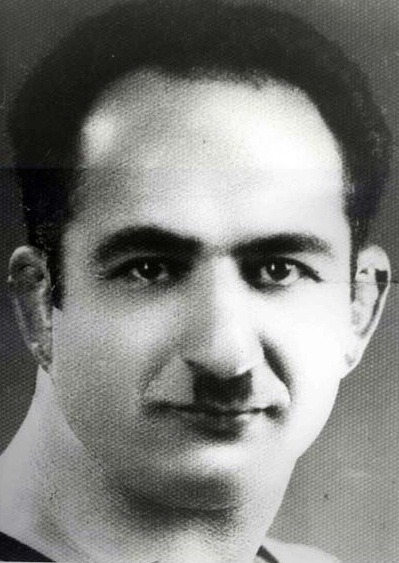


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: بهرنگ صفری در چه سالی متولد شده است؟
نام انتخاب‌شده: بهرنگ صفری
گزینهٔ پیش‌بینی‌شده: ۱۳۶۳
شاهد (بخش استخراج‌شده):
بهرنگ صفری، ورزشکار فوتبال، در تاریخ ۲۰ بهمن ۱۳۶۳(سن:۴۰ سال) در تهران،ایران متولد شده است، قد ایشان ۱٫۸۴ متر است.


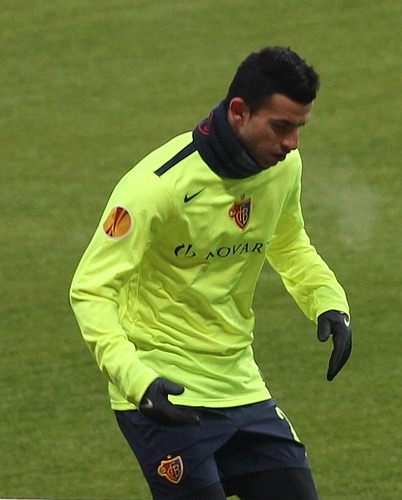


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: عبدالله موحد چند مدال جهانی کسب کرده است؟
نام انتخاب‌شده: عبدالله موحد
گزینهٔ پیش‌بینی‌شده: ۵
شاهد (بخش استخراج‌شده):
او ۵ مدال جهانی، ۲ مدال منطقه‌ای، و یک مدال المپیک کسب کرده است.


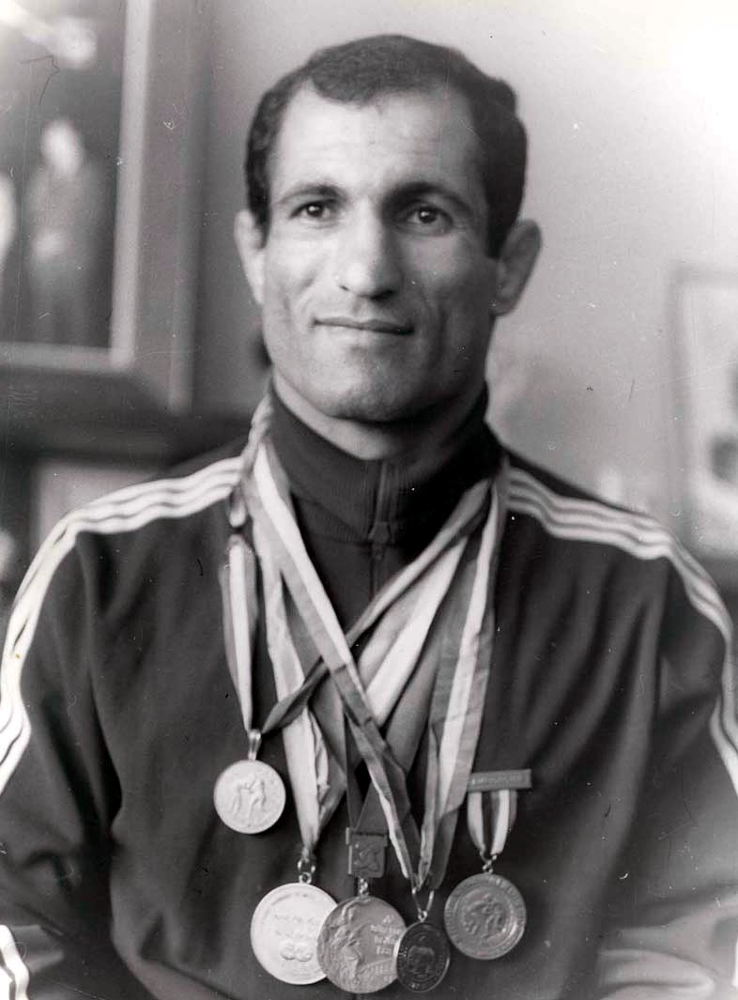

In [33]:
for r in out_rows:
    print("\n" + "—"*90)
    print("سؤال:", r["question"])
    print("نام انتخاب‌شده:", r["target_name"])
    print("گزینهٔ پیش‌بینی‌شده:", r["predicted_option"])
    print("شاهد (بخش استخراج‌شده):")
    print(r["evidence_span"] if r["evidence_span"] else "—")
    if r["image_path"]:
        try:
            display(IPImage(filename=r["image_path"]))
        except Exception:
            print(f"[تصویر در دسترس نیست] {r['image_path']}")
    else:
        print("[تصویر یافت نشد]")

In [34]:
out_rows = []
for ex in tqdm(questions, desc=f"Generating "):
    question = ex.get("question","").strip()
    options  = list(ex.get("options", []))
    ctxs     = build_contexts_for_question(question) or [{"name":"", "summary":""}]

    messages = build_prompt_persian(question, options, ctxs)
    result   = call_model(messages)

    target_name      = str(result.get("target_name","")).strip()
    predicted_option = str(result.get("predicted_option","")).strip()
    evidence_span    = str(result.get("evidence_span","")).strip()

    # Ensure predicted_option is one of the options
    if predicted_option not in options:
        # naive rescue: try exact after trimming spaces/digits normalization
        opts_norm = [normalize_text(o) for o in options]
        po_norm   = normalize_text(predicted_option)
        if po_norm in opts_norm:
            predicted_option = options[opts_norm.index(po_norm)]
        else:
            # leave as-is; downstream can inspect
            pass

    # Find an image file for the target name
    image_path = find_image_for_name(target_name, IMG_INDEX)

    out_rows.append({
        "question": question,
        "target_name": target_name,
        "predicted_option": predicted_option,
        "evidence_span": evidence_span,
        "image_path": image_path
    })

Generating : 100%|█████████████████████████████████████████████████████████████████████| 48/48 [02:10<00:00,  2.73s/it]


In [35]:
out_df = pd.DataFrame(out_rows, columns=["question","target_name","predicted_option","evidence_span","image_path"])
out_df.to_csv(OUT_CSV, index=False, encoding="utf-8-sig")
print(f"\nSaved → {OUT_CSV}")


Saved → C:\Users\sinab\Desktop\NLP\HW3\Generative\rag_out\Text_set_generative_outputs.csv



——————————————————————————————————————————————————————————————————————————————————————————
سؤال: حبیب‌الله بلور در کدام رشته ورزشی فعالیت داشت؟
نام انتخاب‌شده: حبیب‌الله بلور
گزینهٔ پیش‌بینی‌شده: کشتی
شاهد (بخش استخراج‌شده):
حبیب‌الله بلور، ورزشکار کشتی، در تاریخ ۵ فروردین ۱۲۹۲ در تهران متولد شده است، در تاریخ ۲۳ فروردین ۱۳۶۱ درگذشته است.


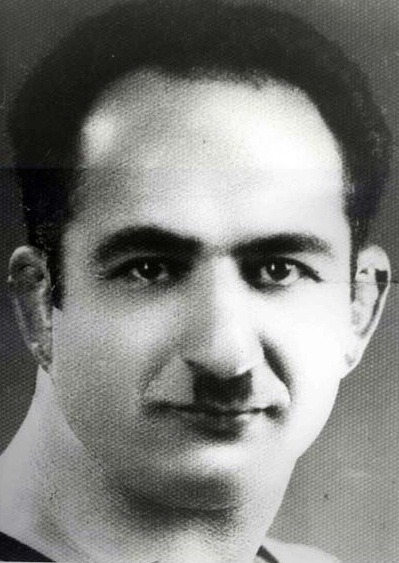


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: بهرنگ صفری در چه سالی متولد شده است؟
نام انتخاب‌شده: بهرنگ صفری
گزینهٔ پیش‌بینی‌شده: ۱۳۶۳
شاهد (بخش استخراج‌شده):
بهرنگ صفری، ورزشکار فوتبال، در تاریخ ۲۰ بهمن ۱۳۶۳(سن:۴۰ سال) در تهران،ایران متولد شده است، قد ایشان ۱٫۸۴ متر است.


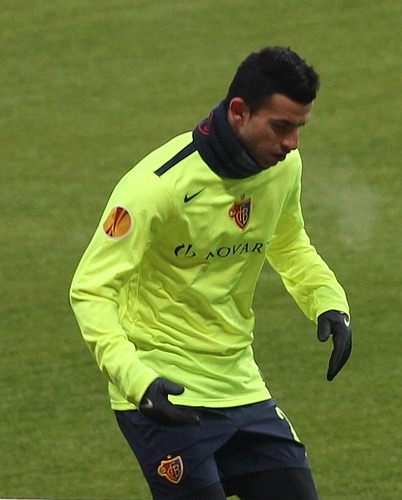


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: عبدالله موحد چند مدال جهانی کسب کرده است؟
نام انتخاب‌شده: عبدالله موحد
گزینهٔ پیش‌بینی‌شده: ۵
شاهد (بخش استخراج‌شده):
او ۵ مدال جهانی، ۲ مدال منطقه‌ای، و یک مدال المپیک کسب کرده است.


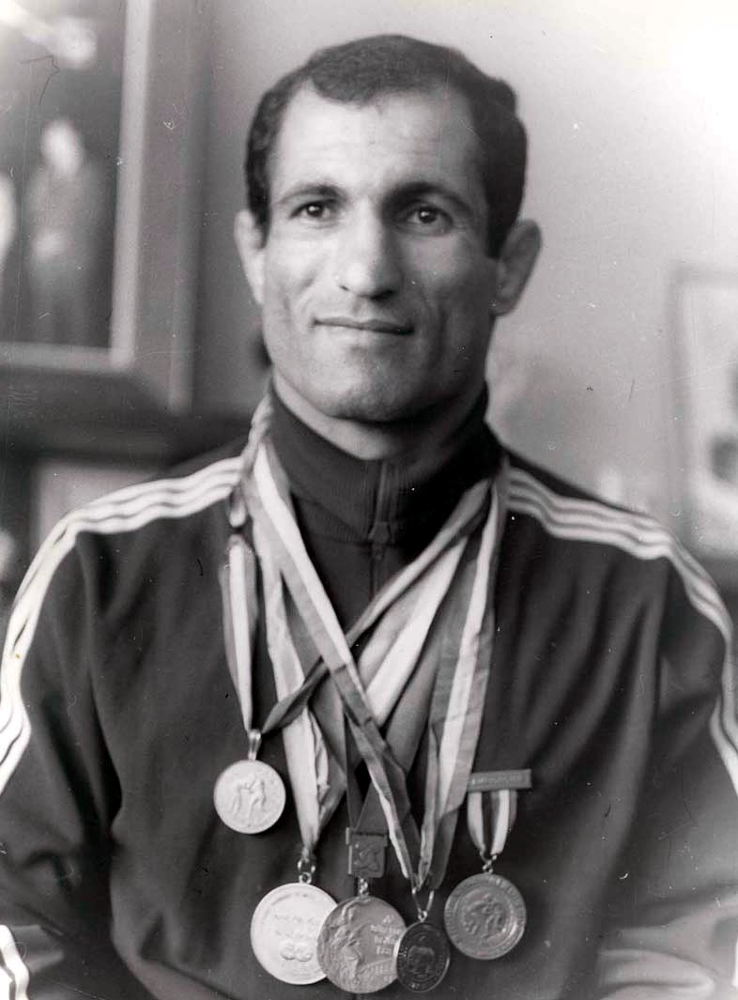


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: لوون کورکچیان مدال طلای خود را در کدام رقابت کسب کرده است؟
نام انتخاب‌شده: لوون کورکچیان
گزینهٔ پیش‌بینی‌شده: بازی‌های آسیایی ۱۹۵۱ دهلی نو
شاهد (بخش استخراج‌شده):
افتخار مدال طلا بازی‌های آسیایی ۱۹۵۱ دهلی نو را کسب کرده است.


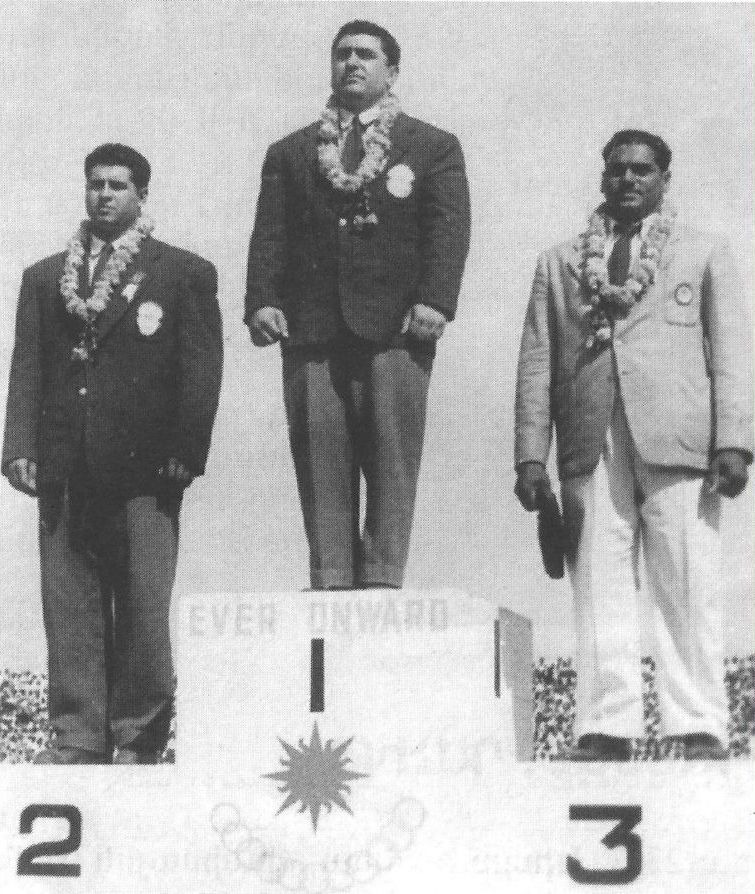


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: علیرضا حقی در چه ماهی متولد شده است؟
نام انتخاب‌شده: علیرضا حقی
گزینهٔ پیش‌بینی‌شده: فوریهٔ ۱۹۷۹
شاهد (بخش استخراج‌شده):
علیرضا حقی، ورزشکار دوچرخه‌سواری، در تاریخ ۸ فوریهٔ ۱۹۷۹ ( در ۴۶ سال) متولد شده است


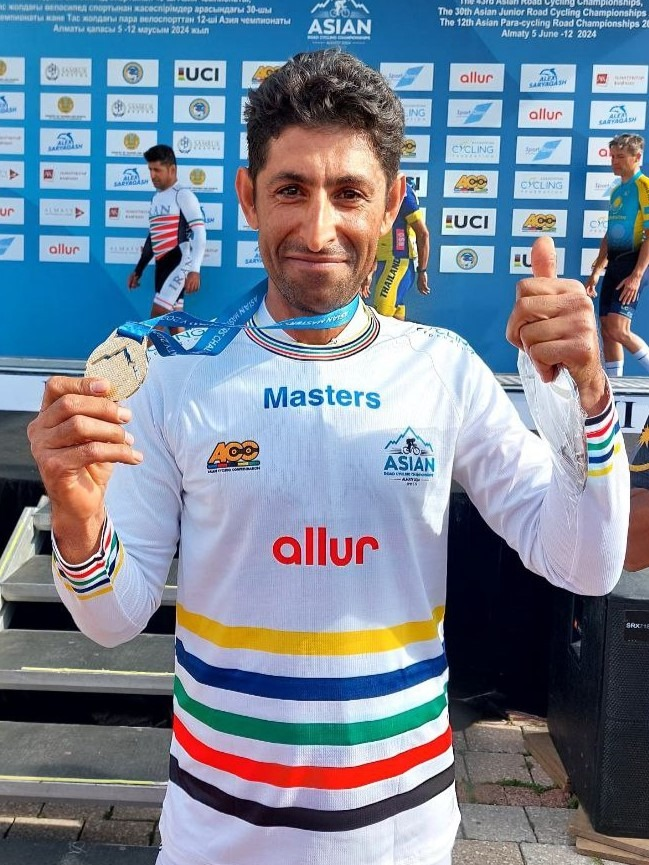


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: زوونیمیر سولدو در کدام کشور متولد شده است؟
نام انتخاب‌شده: زوونیمیر سولدو
گزینهٔ پیش‌بینی‌شده: کرواسی
شاهد (بخش استخراج‌شده):
زوونیمیر سولدو، ورزشکار فوتبال، در تاریخ ۲ نوامبر ۱۹۶۷ (۵۷ سال) متولد شده است


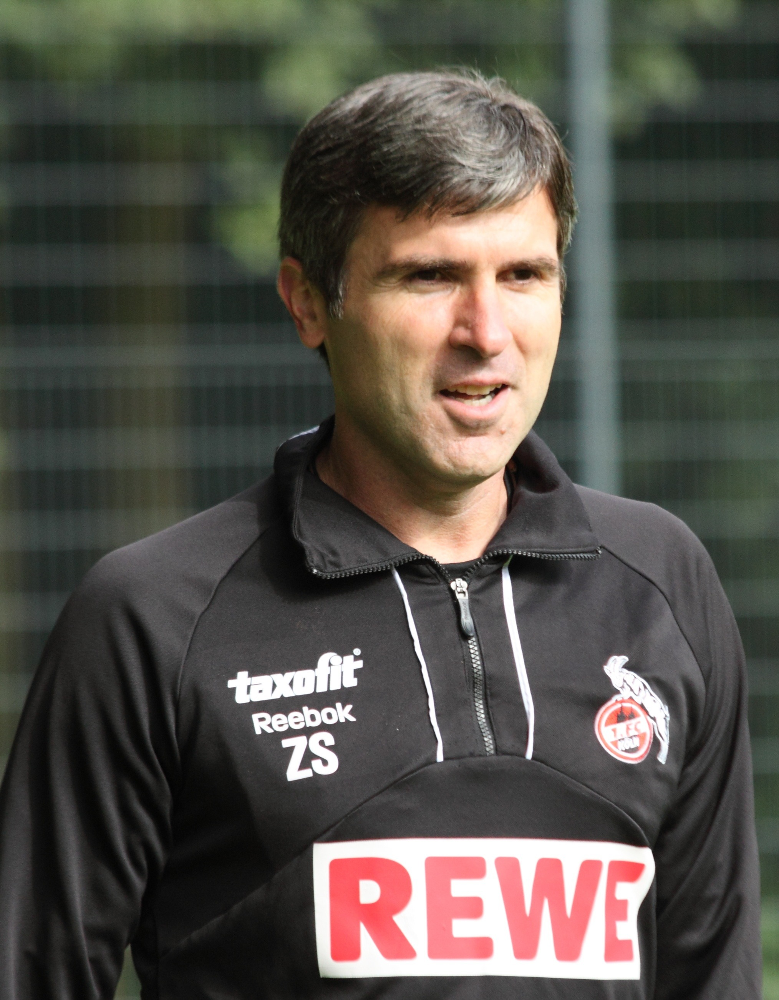


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: محراب شاهرخی در چه سالی درگذشته است؟
نام انتخاب‌شده: محراب شاهرخی
گزینهٔ پیش‌بینی‌شده: ۱۳۷۱
شاهد (بخش استخراج‌شده):
در تاریخ ۱۲ بهمن ۱۳۷۱ درگذشته است


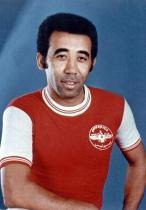


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: وزن محمد جمشیدی چند کیلوگرم است؟
نام انتخاب‌شده: محمد جمشیدی
گزینهٔ پیش‌بینی‌شده: ۸۰
شاهد (بخش استخراج‌شده):
وزن ایشان ۸۰ کیلوگرم (۱۷۶ پوند) است.


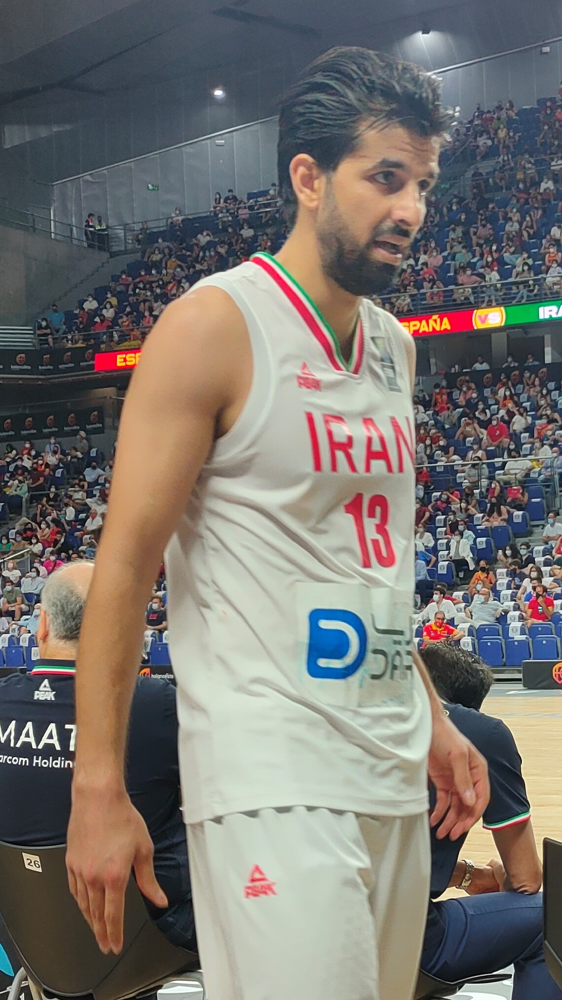


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: مجتبی گلیج در کدام شهر متولد شده است؟
نام انتخاب‌شده: مجتبی گلیج
گزینهٔ پیش‌بینی‌شده: تنکابن
شاهد (بخش استخراج‌شده):
مجتبی گلیج، ورزشکار کشتی، در تاریخ ۳ بهمن ۱۳۷۵ (۲۸ سال) در تنکابن متولد شده است


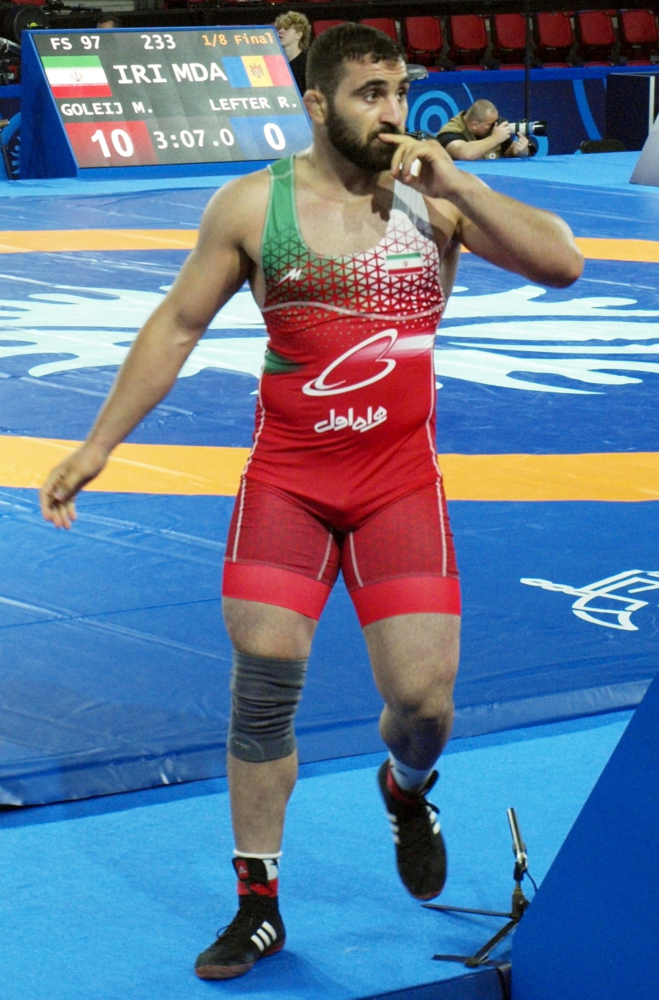


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: قد ایمان موسوی چند است؟
نام انتخاب‌شده: ایمان موسوی
گزینهٔ پیش‌بینی‌شده: ۱/۸۴
شاهد (بخش استخراج‌شده):
قد ایشان ۱/۸۴ است


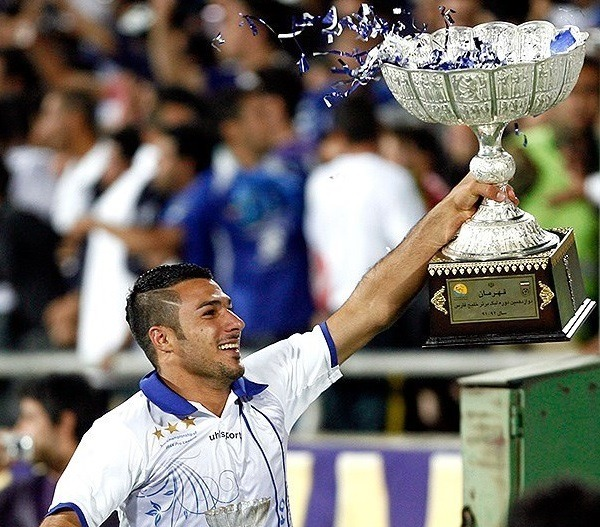


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: الهام فلاح در چه رشته‌ای فعالیت دارد؟
نام انتخاب‌شده: الهام فلاح
گزینهٔ پیش‌بینی‌شده: والیبال
شاهد (بخش استخراج‌شده):
الهام فلاح، ورزشکار والیبال، در تاریخ ۲۵ فروردین ۱۳۷۳ (۳۱ سال)شیراز در تیم ملی بزرگسالان ایران متولد شده است


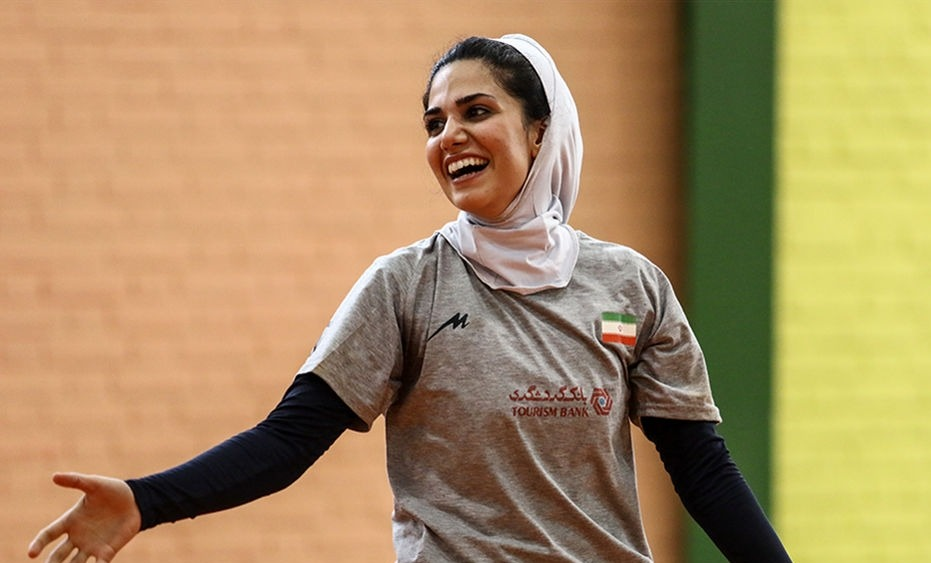


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: ناصر حجازی در کدام تیم ها بازی کرده است؟
نام انتخاب‌شده: ناصر حجازی
گزینهٔ پیش‌بینی‌شده: استقلال و منچستر یونایتد
شاهد (بخش استخراج‌شده):
در تیم‌های نادر تهران، تاج، شهباز، استقلال، محمدان و منچستر یونایتد بازی کرده است.


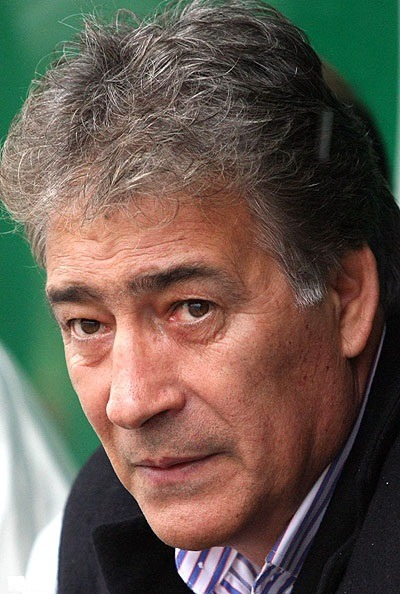


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: امیرعلی صادقی در کدام تیم‌ها بازی کرده است؟
نام انتخاب‌شده: امیرعلی صادقی
گزینهٔ پیش‌بینی‌شده: سایپا و استقلال
شاهد (بخش استخراج‌شده):
او با شماره ۹۹ برای استقلال بازی می‌کند


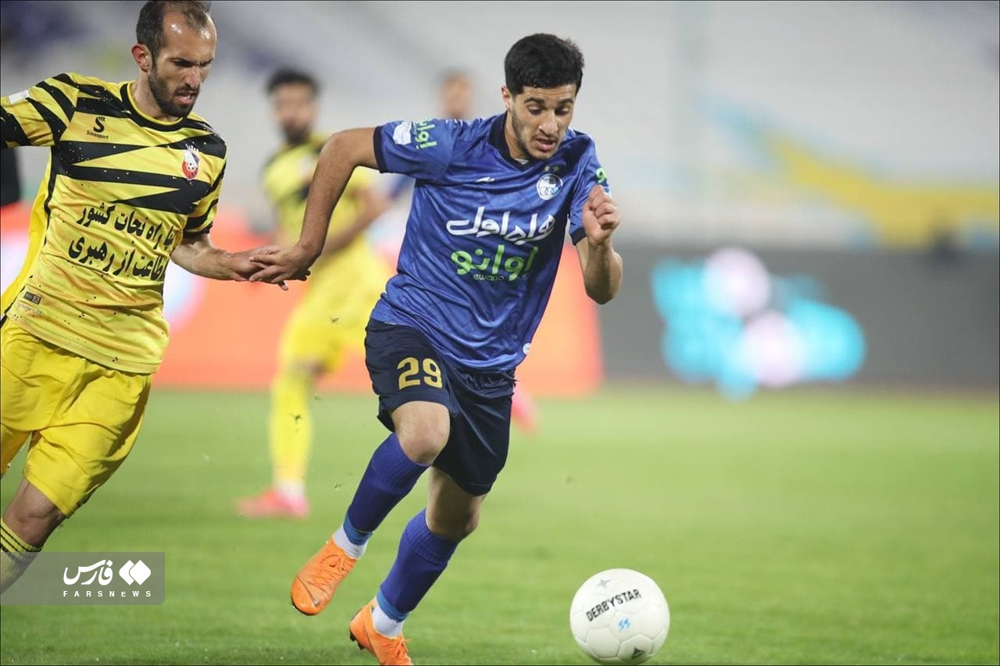


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: مهتاب رحمانی ورزشکار کدام رشته است؟
نام انتخاب‌شده: مهتاب رحمانی
گزینهٔ پیش‌بینی‌شده: والیبال
شاهد (بخش استخراج‌شده):
مهتاب رحمانی، ورزشکار والیبال، در تاریخ ۳ شهریور ۱۳۷۱ (۳۲ سال)کرمانشاه در تیم ملی بزرگسالان ایران متولد شده است،


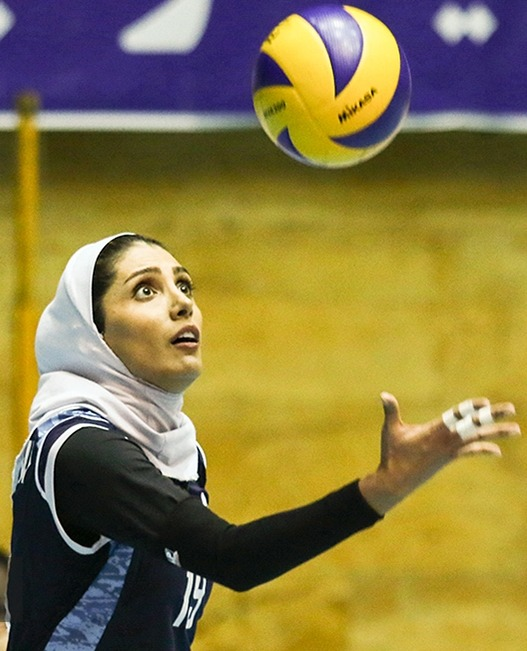


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: بهتاش فریبا در چه شهری متولد شده است؟
نام انتخاب‌شده: بهتاش فریبا
گزینهٔ پیش‌بینی‌شده: تهران
شاهد (بخش استخراج‌شده):
بهتاش فریبا، ورزشکار فوتبال، در تاریخ ۲۲ بهمن ۱۳۳۴ (۶۹ سال) در تهران،ایران متولد شده است.


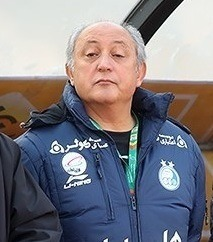


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: صمد پورسیدی در چه رشته‌ای فعالیت دارد؟
نام انتخاب‌شده: صمد پورسیدی
گزینهٔ پیش‌بینی‌شده: دوچرخه‌سواری
شاهد (بخش استخراج‌شده):
صمد پورسیدی، ورزشکار دوچرخه‌سواری، در تاریخ ۲۳ مهر ۱۳۶۴ (سن: در ۳۹ سال) متولد شده است.


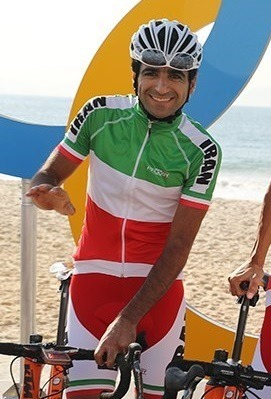


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: عبدالواحد خنجی در کدام شهر و کشور متولد شده است؟
نام انتخاب‌شده: عبدالواحد خنجی
گزینهٔ پیش‌بینی‌شده: منامه بحرین
شاهد (بخش استخراج‌شده):
عبدالواحد خنجی، ورزشکار دوچرخه‌سواری، در تاریخ ۱۷ بهمن ۱۳۰۷ در منامه متولد شده است


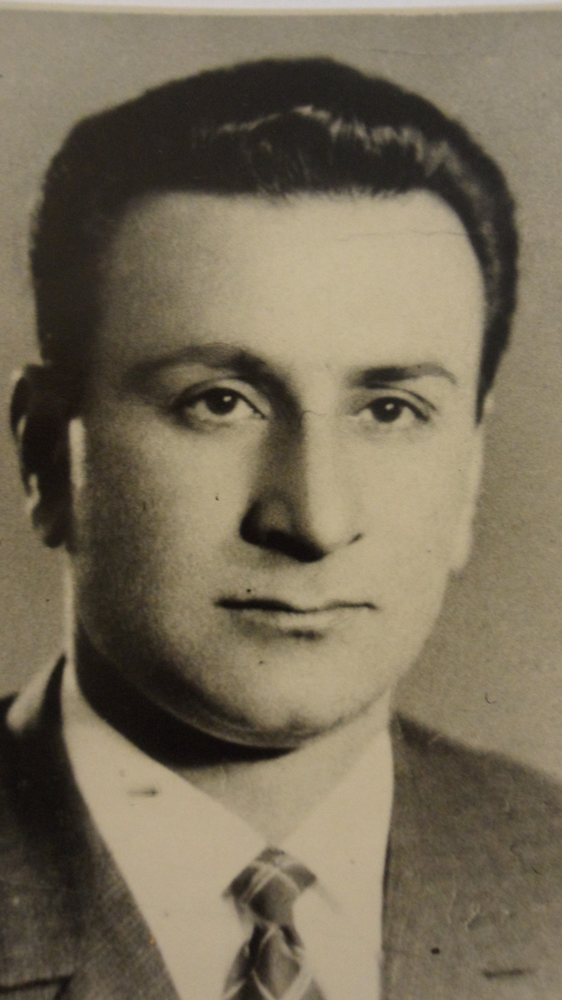


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: بیژن طاهری بازیکن کدام رشته است؟
نام انتخاب‌شده: بیژن طاهری
گزینهٔ پیش‌بینی‌شده: فوتبال
شاهد (بخش استخراج‌شده):
بیژن طاهری، ورزشکار فوتبال، در تاریخ ۱ فروردین ۱۳۴۰ (سن:۶۴ سال) در تهران،ایران متولد شده است.


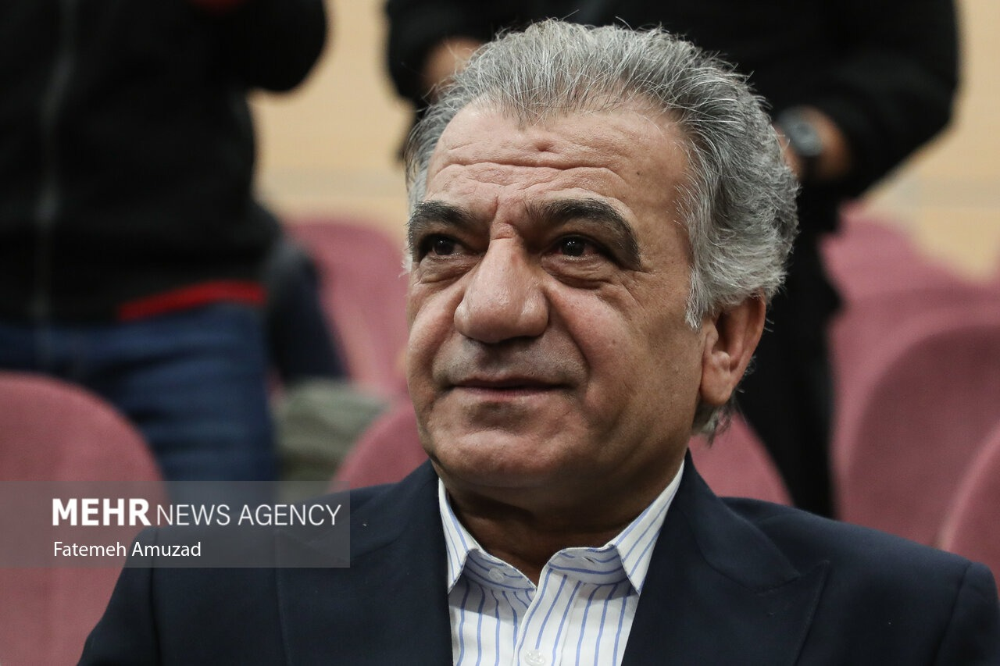


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: علی مرادی در چه رشته‌ای ورزشکار است؟
نام انتخاب‌شده: علی مرادی
گزینهٔ پیش‌بینی‌شده: وزنه‌برداری
شاهد (بخش استخراج‌شده):
علی مرادی، متولد ۱۳۴۱ در ایران، فعال در حوزه وزنه‌برداری است


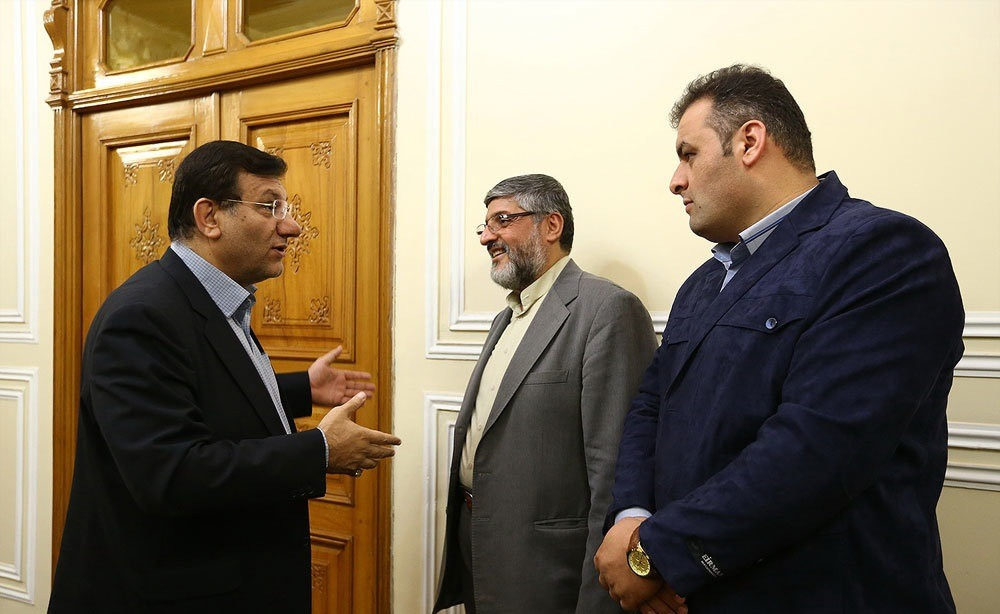


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: رضا علی‌پور ورزشکار کدام رشته است؟
نام انتخاب‌شده: رضا علی‌پور
گزینهٔ پیش‌بینی‌شده: سنگ‌نوردی
شاهد (بخش استخراج‌شده):
رضا علی‌پور، ورزشکار سنگ‌نورد، در تاریخ ۹ اردیبهشت ۱۳۷۳ ( در ۳۱ سال) متولد شده است.


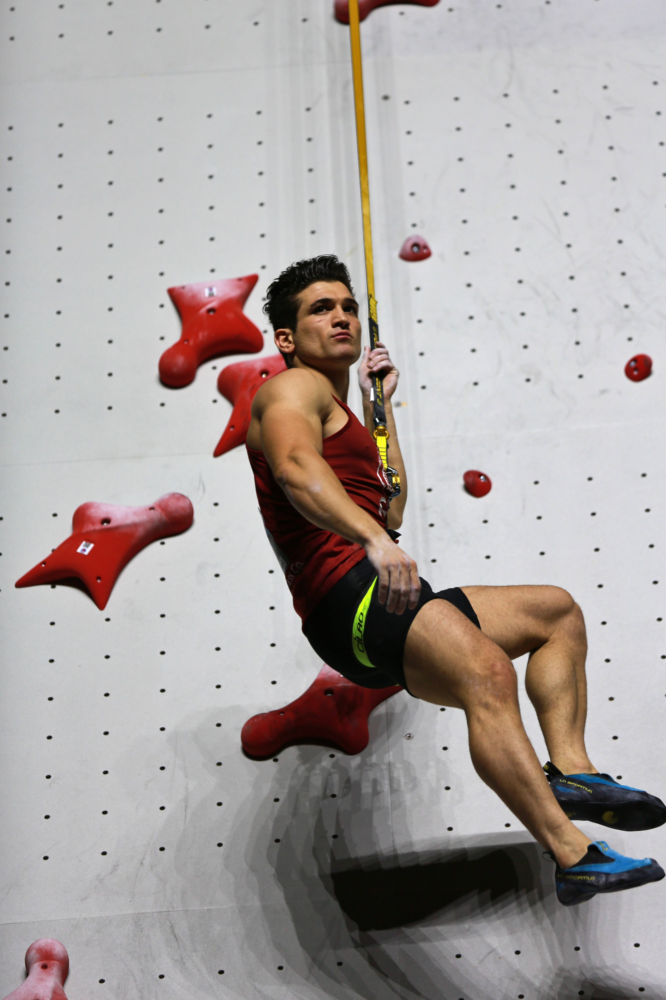


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: وحید گل‌خندان در جام جهانی ریودوژانیرو ۲۰۲۲ کدام مدال را کسب کرده است؟
نام انتخاب‌شده: وحید گل‌خندان
گزینهٔ پیش‌بینی‌شده: نقره
شاهد (بخش استخراج‌شده):
مدال نقره جام جهانی ریودوژانیرو ۲۰۲۲


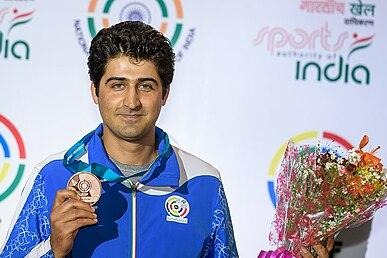


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: وحید سرلک در چه رشته‌ای شناخته می‌شود؟
نام انتخاب‌شده: وحید سرلک
گزینهٔ پیش‌بینی‌شده: رزمی
شاهد (بخش استخراج‌شده):
وحید سرلک، ورزشکار رزمی، در تاریخ ۳۰ دی ۱۳۵۹ در ایران متولد شده است.


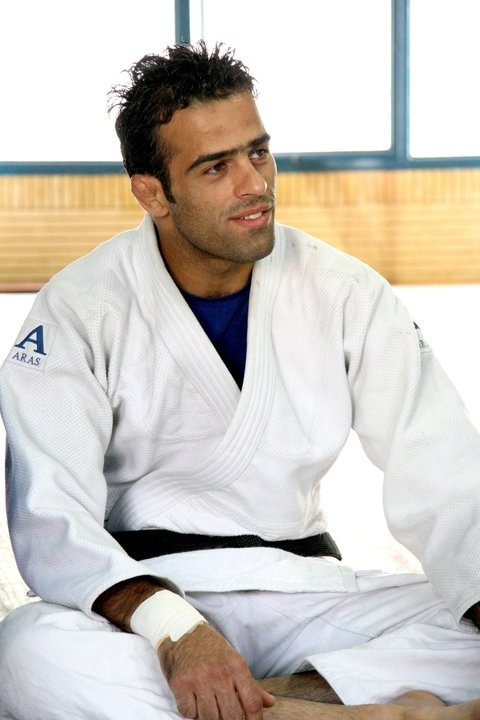


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: یوسف وکیا بازیکن کدام تیم‌ها بوده است؟
نام انتخاب‌شده: یوسف وکیا
گزینهٔ پیش‌بینی‌شده: فولاد و نفت مسجدسلیمان
شاهد (بخش استخراج‌شده):
در تیم‌های فولاد، نفت مسجدسلیمان، گل‌گهر، پدیده، خیبر خرم‌آباد، فجر سپاسی، صنعت نفت آبادان و بعثت کرمانشاه بازی کرده است.


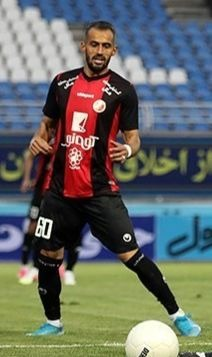


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: هاروتیون آبراهامیان اهل کدام کشور است؟
نام انتخاب‌شده: هاروتیون آبراهامیان
گزینهٔ پیش‌بینی‌شده: ارمنستان
شاهد (بخش استخراج‌شده):
هاروتیون آبراهامیان، ورزشکار فوتبال، در تاریخ ۴ دسامبر ۱۹۶۹ (۵۵ سال) در ایروان،ارمنستان متولد شده است


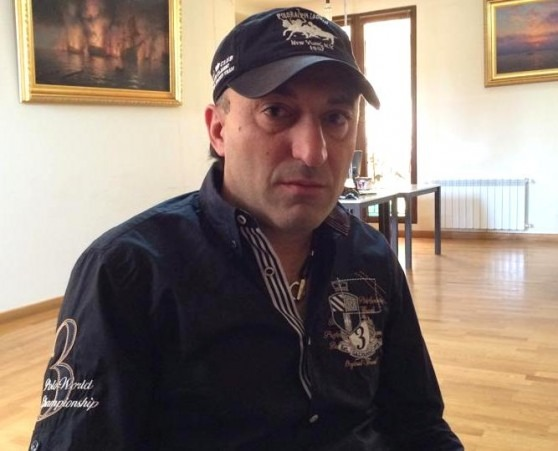


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: جمشید نصیری در کدام شهر ایران متولد شده است؟
نام انتخاب‌شده: جمشید نصیری
گزینهٔ پیش‌بینی‌شده: خرمشهر
شاهد (بخش استخراج‌شده):
جمشید نصیری، ورزشکار فوتبال، در تاریخ ۲۳ فوریهٔ ۱۹۵۹ (۶۶ سال) در بندر خرمشهر,ایران متولد شده است


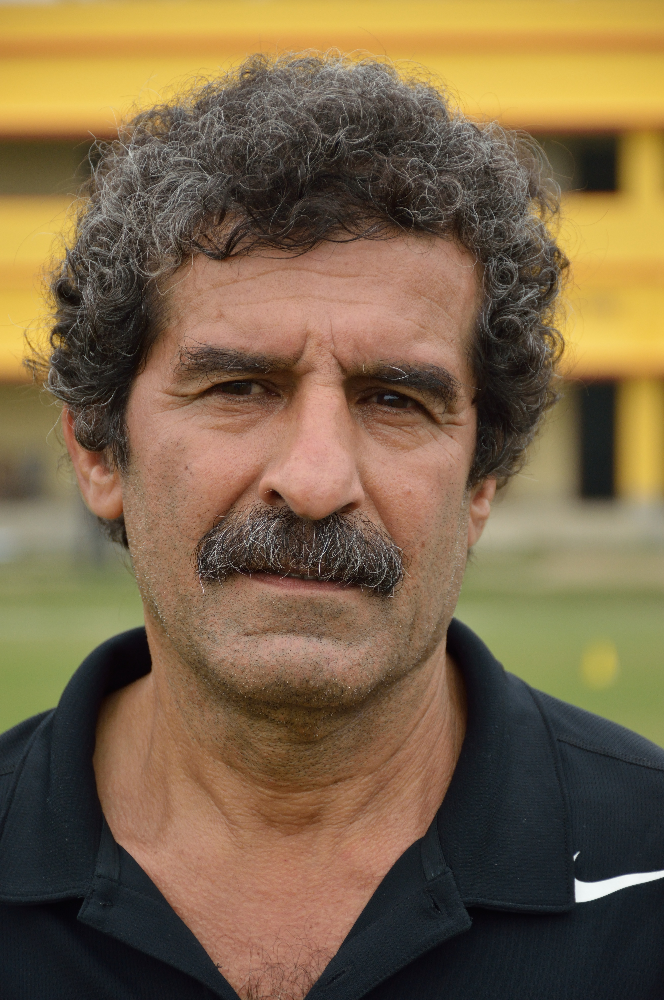


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: رضا افتخاری در کدام رشته ورزشی شناخته می‌شود؟
نام انتخاب‌شده: رضا افتخاری
گزینهٔ پیش‌بینی‌شده: فوتبال
شاهد (بخش استخراج‌شده):
رضا افتخاری، ورزشکار فوتبال.


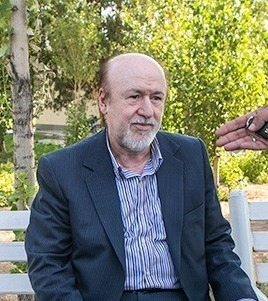


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: پوریا امینی در چه استانی متولد شده است؟
نام انتخاب‌شده: پوریا امینی
گزینهٔ پیش‌بینی‌شده: گیلانغرب
شاهد (بخش استخراج‌شده):
پوریا امینی، ورزشکار فوتبال، در تاریخ ۸ اسفند ۱۳۷۳ (۳۰ سال) در گیلانغرب،ایران متولد شده است،


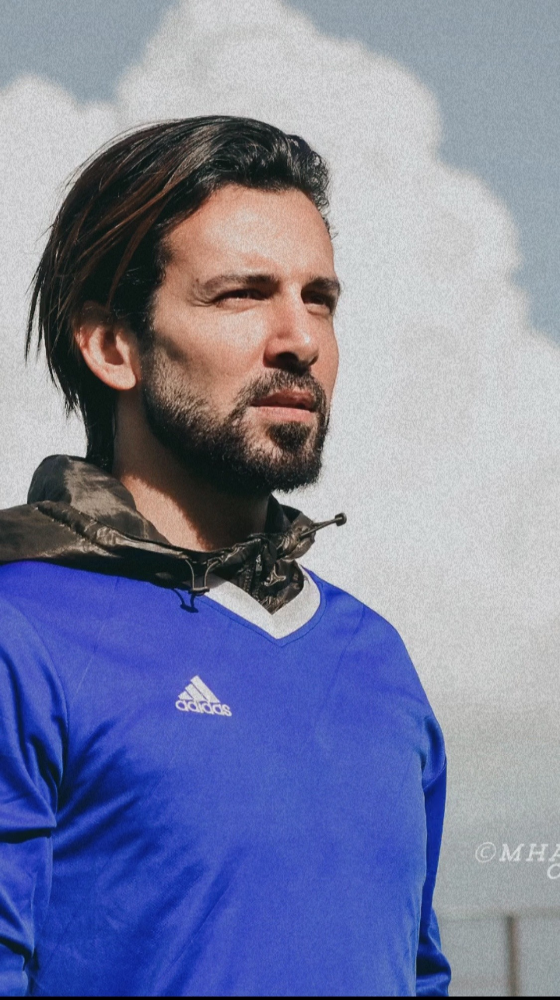


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: حسن حبیبی در کدام شهر متولد شده است؟
نام انتخاب‌شده: حسن حبیبی
گزینهٔ پیش‌بینی‌شده: کرمان
شاهد (بخش استخراج‌شده):
حسن حبیبی، ورزشکار فوتبال، در تاریخ ۱۸ بهمن ۱۳۱۸ (۸۵ سال) در کرمان،ایران متولد شده است.


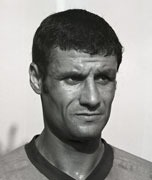


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: زینب گیوه بازیکن والیبال ایرانی در کدام پست فعالیت می‌کند؟
نام انتخاب‌شده: زینب گیوه
گزینهٔ پیش‌بینی‌شده: دریافت‌کننده قدرتی
شاهد (بخش استخراج‌شده):
در پست دریافت‌کننده قدرتی فعالیت می‌کند.


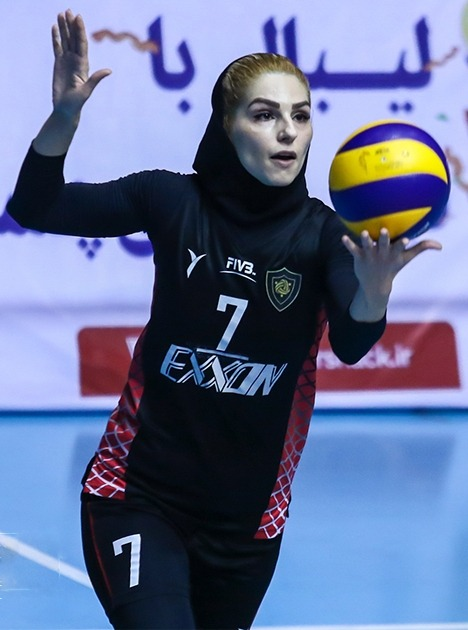


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: حسین مهربان بازیکن کدام تیم‌ها بوده است؟
نام انتخاب‌شده: حسین مهربان
گزینهٔ پیش‌بینی‌شده: پدیده و فجر سپاسی
شاهد (بخش استخراج‌شده):
در تیم‌های پدیده، فجر سپاسی، مس رفسنجان و هوادار بازی کرده است.


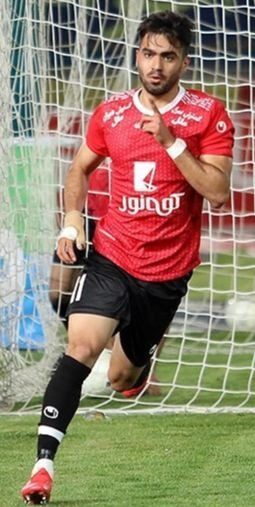


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: علی پاکدامن در جام جهانی گرجستان ۲۰۲۴ کدام مدال را کسب کرده است؟
نام انتخاب‌شده: علی پاکدامن
گزینهٔ پیش‌بینی‌شده: نقره
شاهد (بخش استخراج‌شده):
مدال نقره جام جهانی گرجستان ۲۰۲۴ را کسب کرده است.


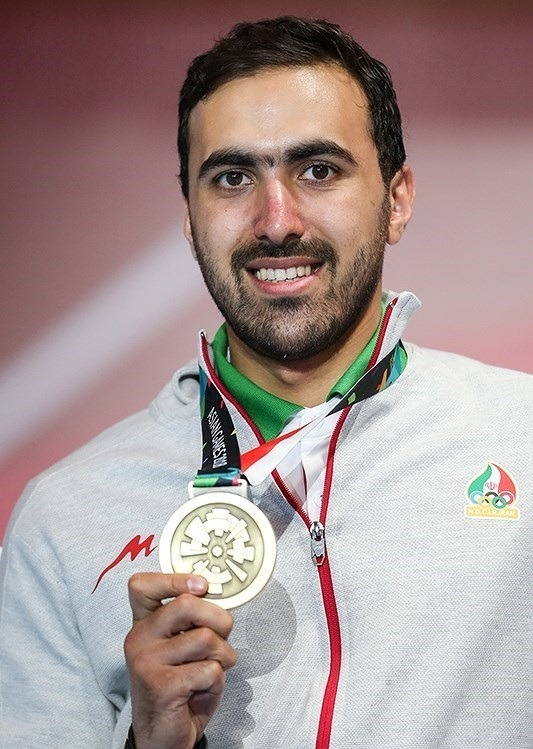


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: الهام حسینی در چه رشته‌ای فعالیت دارد؟
نام انتخاب‌شده: الهام حسینی
گزینهٔ پیش‌بینی‌شده: وزنه‌برداری
شاهد (بخش استخراج‌شده):
الهام حسینی، ورزشکار وزنه‌برداری، در تاریخ ۱۶ سپتامبر ۱۹۸۸ ( در ۳۶ سال) متولد شده است، وزن ایشان ۸۷ کیلوگرم (۱۹۲ پوند) است.


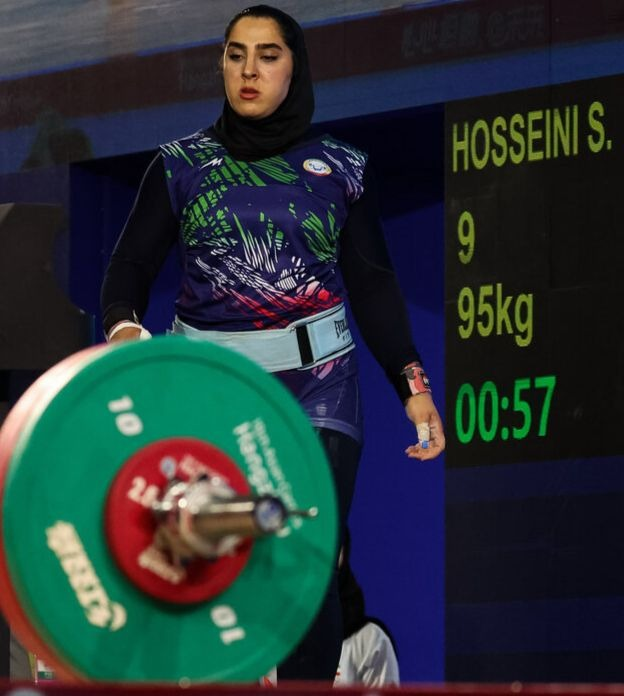


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: رضا مؤمنی در کدام شهر متولد شده است؟
نام انتخاب‌شده: رضا مؤمنی
گزینهٔ پیش‌بینی‌شده: قائمشهر
شاهد (بخش استخراج‌شده):
در تاریخ قائمشهر در ، متولد شده است.


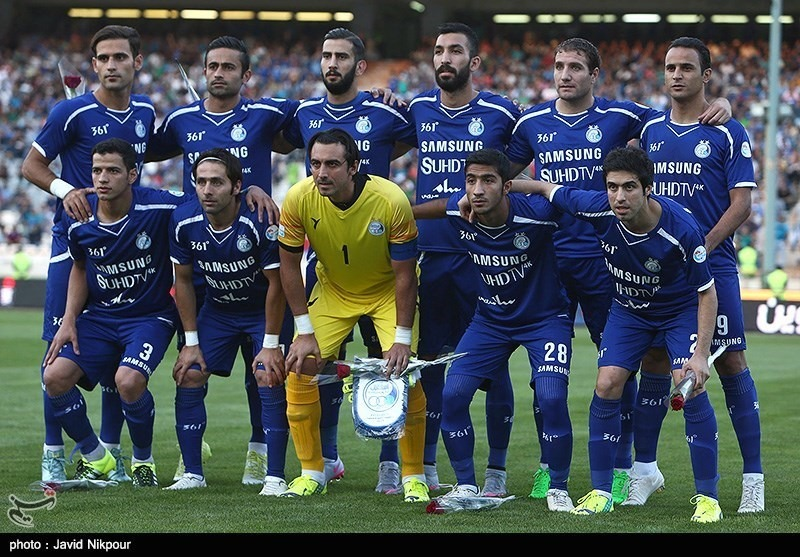


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: رضا نوروزی در چه شهری متولد شده است؟
نام انتخاب‌شده: رضا نوروزی
گزینهٔ پیش‌بینی‌شده: ایذه
شاهد (بخش استخراج‌شده):
در تاریخ ۳۰ شهریور ۱۳۶۱ (۴۲ سال) در ایذه،ایران متولد شده است


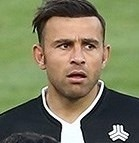


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: مجید ترکان ورزشکار کدام رشته است؟
نام انتخاب‌شده: مجید ترکان
گزینهٔ پیش‌بینی‌شده: کشتی
شاهد (بخش استخراج‌شده):
مجید ترکان، ورزشکار کشتی، در تاریخ ۲۱ آذر ۱۳۴۴ ( در ۶۰ سال) متولد شده است


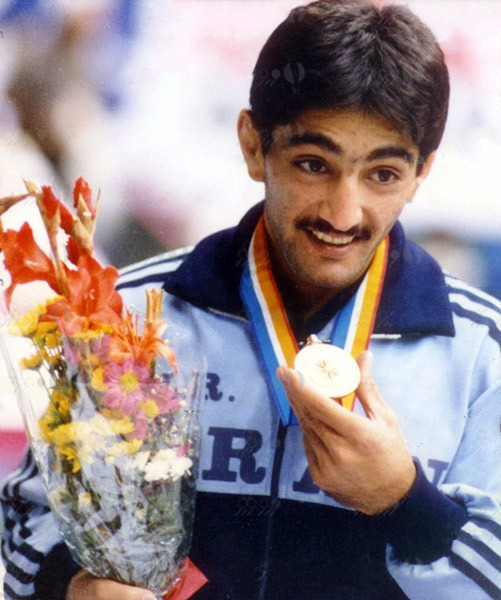


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: ایوان مارکوویچ هافبک ذوب‌آهن در فوتبال فعالیت خود را با چه تیمی آغاز کرد؟
نام انتخاب‌شده: ایوان مارکوویچ
گزینهٔ پیش‌بینی‌شده: ستاره سرخ بلگراد
شاهد (بخش استخراج‌شده):
مارکوویچ فعالیت خود را از سال ۲۰۰۳ با ستاره سرخ بلگراد آغاز کرد


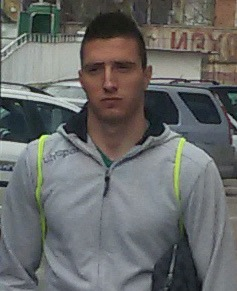


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: گلنوش خسروی در کدام شهر به متولد شده است؟
نام انتخاب‌شده: گلنوش خسروی
گزینهٔ پیش‌بینی‌شده: اصفهان
شاهد (بخش استخراج‌شده):
گلنوش خسروی، ورزشکار فوتبال، در تاریخ ۱۲ می ۲۰۰۱۲۲ اردیبهشت ۱۳۸۰ (۲۴ سال) در اصفهان،ایران متولد شده است


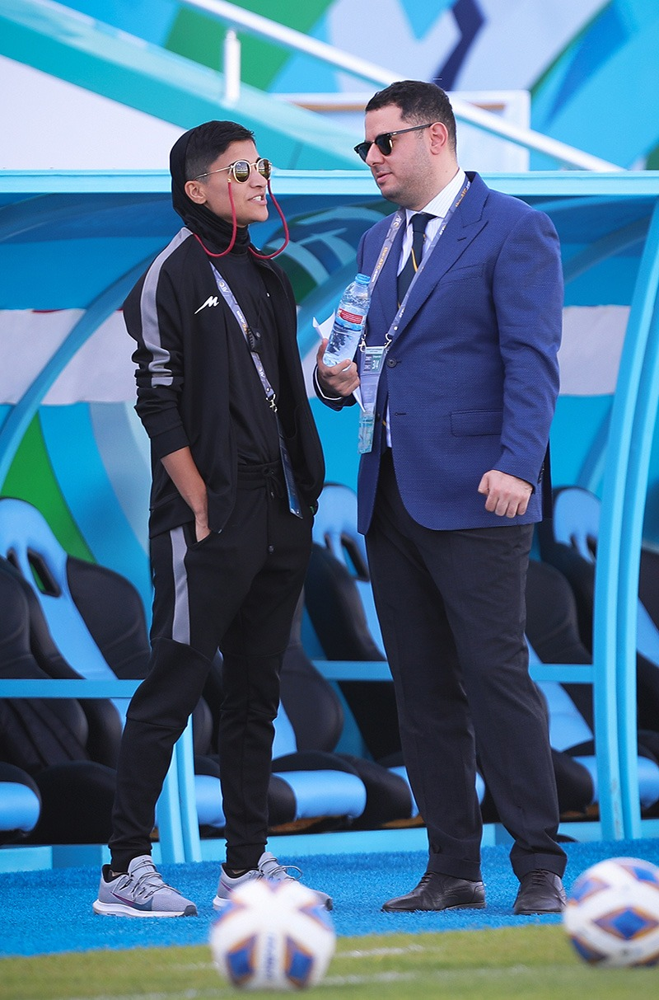


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: فرنوش شیخی در کدام رشته ورزشی فعالیت دارد؟
نام انتخاب‌شده: فرنوش شیخی
گزینهٔ پیش‌بینی‌شده: والیبال
شاهد (بخش استخراج‌شده):
فرنوش شیخی، ورزشکار والیبال، در تاریخ ۲۳ اردیبهشت ۱۳۶۹۱۳ مهٔ ۱۹۹۰ (۳۴ سال) در ایران متولد شده است


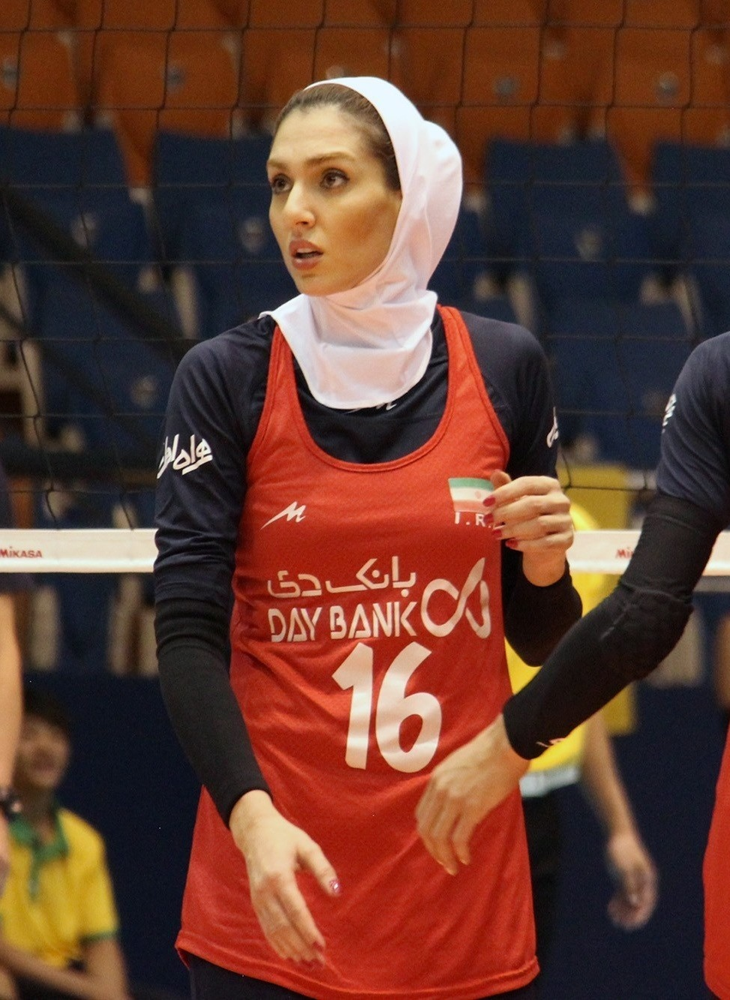


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: سارا شیربیگی ورزشکار کدام رشته است؟
نام انتخاب‌شده: سارا شیربیگی
گزینهٔ پیش‌بینی‌شده: فوتسال
شاهد (بخش استخراج‌شده):
سارا شیربیگی، ورزشکار فوتسال، در تاریخ ۱۵ مرداد ۱۳۷۰ در فوتسال زنان ایران متولد شده است، در تیم‌های سپیدرود رشت و نصرفردیس بازی کرده است.


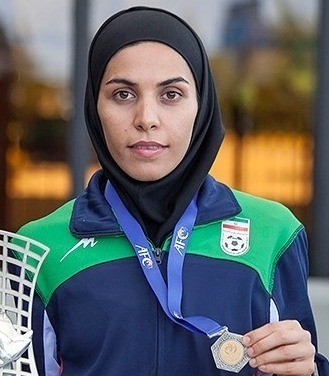


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: هاجر صفرزاده در کدام رقابت مدال گرفته است؟
نام انتخاب‌شده: هاجر صفرزاده
گزینهٔ پیش‌بینی‌شده: پارالمپیک پاریس ۲۰۲۴
شاهد (بخش استخراج‌شده):
مدال نقره بازی‌های پارالمپیک پاریس ۲۰۲۴


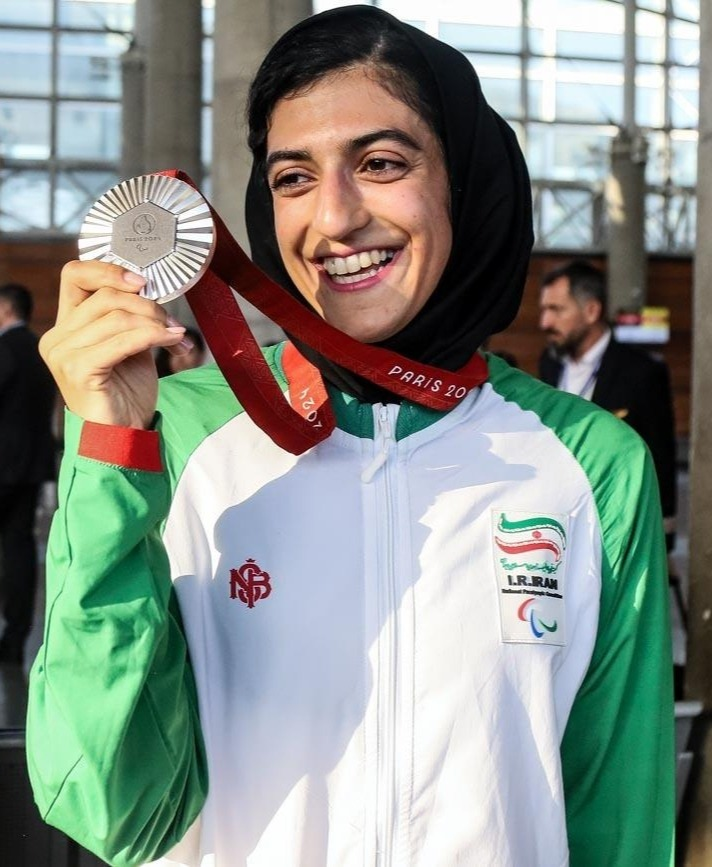


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: مهدی تیکدری سالاری در کدام رشته فعال است؟
نام انتخاب‌شده: مهدی تیکدری
گزینهٔ پیش‌بینی‌شده: فوتبال
شاهد (بخش استخراج‌شده):
مهدی تیکدری، ورزشکار فوتبال، در تاریخ ۲۳ تیر ۱۳۷۵ (۲۸ سال) در کرمان،ایران متولد شده است


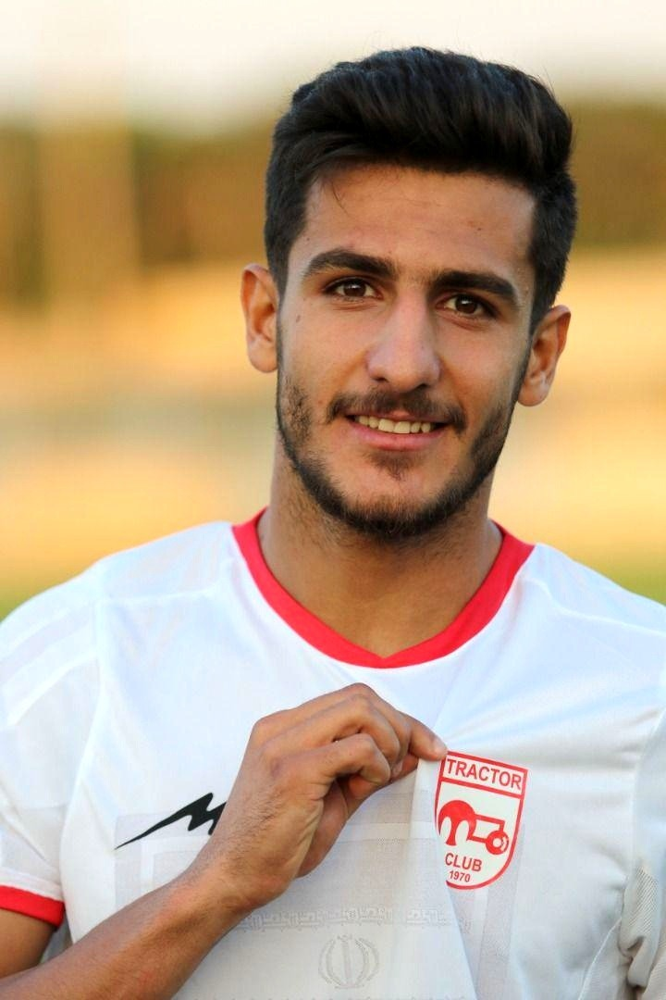


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: شجاع خلیل‌زاده در کدام تیم‌ها بازی کرده است؟
نام انتخاب‌شده: شجاع خلیل‌زاده
گزینهٔ پیش‌بینی‌شده: پرسپولیس و الریان
شاهد (بخش استخراج‌شده):
شجاع خلیل‌زاده... در تیم‌های مس رفسنجان، مس کرمان، سپاهان، ←تراکتور(قرضی)، پرسپولیس، الریان، الاهلی قطر و تراکتور بازی کرده است.


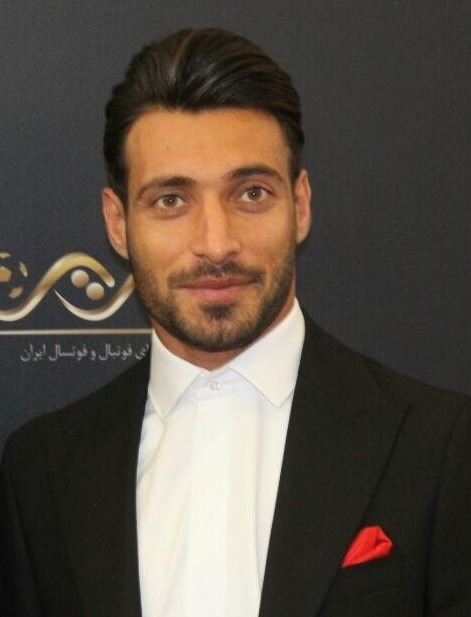


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: مهدی خدابخشی در چه رشته‌ای فعالیت دارد؟
نام انتخاب‌شده: مهدی خدابخشی
گزینهٔ پیش‌بینی‌شده: رزمی
شاهد (بخش استخراج‌شده):
مهدی خدابخشی، ورزشکار رزمی، در تاریخ ۱۰ اردیبهشت ۱۳۷۴ در اسلام آباد غرب متولد شده است


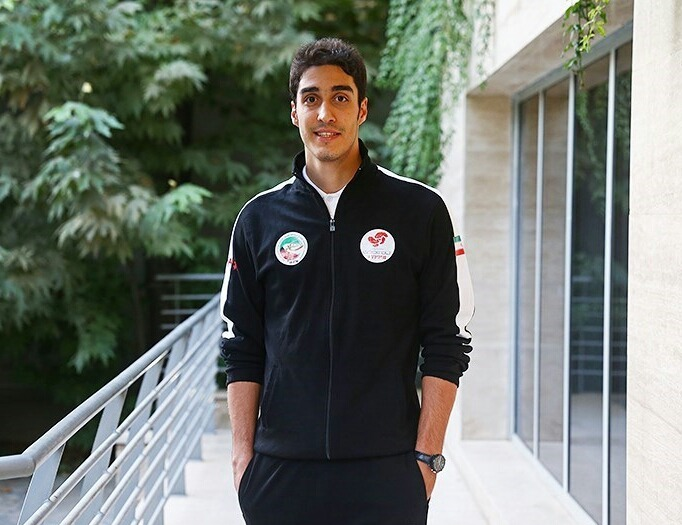


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: علی دایی در کدام تیم‌های اروپایی بازی کرده است؟
نام انتخاب‌شده: علی دایی
گزینهٔ پیش‌بینی‌شده: بایرن مونیخ و هرتابرلین
شاهد (بخش استخراج‌شده):
در تیم‌های استقلال اردبیل، تاکسیرانی، بانک تجارت، پرسپولیس، السد، آرمینیا بیله‌فلد، بایرن مونیخ، هرتابرلین، الشباب، پرسپولیس، صباباتری و سایپا بازی کرده است.


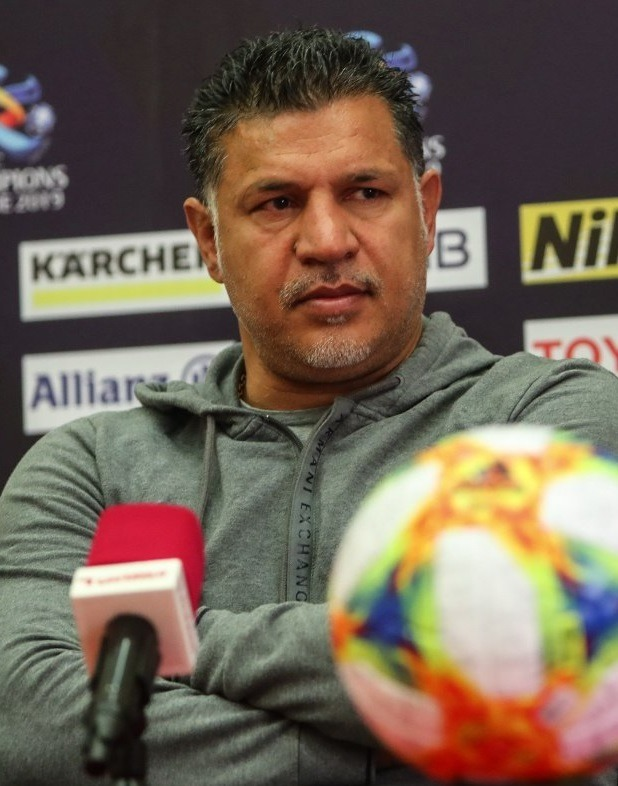


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: عباس زندی در کدام رشته ورزشی مدال‌های متعددی کسب کرده است؟
نام انتخاب‌شده: عباس زندی
گزینهٔ پیش‌بینی‌شده: کشتی
شاهد (بخش استخراج‌شده):
عباس زندی، متولد ۱۳۱۰ در سنگلج، تهران، ایران، ورزشکار کشتی آزاد و پهلوانی


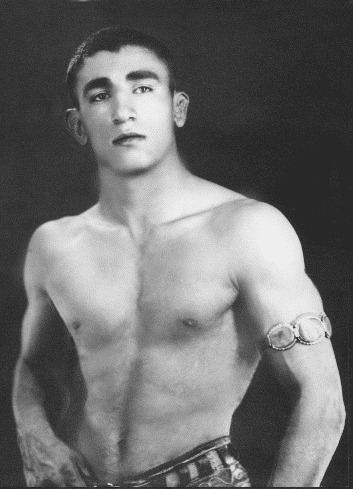


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: عزت‌الله اکبری در چه سالی متولد شده است؟
نام انتخاب‌شده: عزت‌الله اکبری
گزینهٔ پیش‌بینی‌شده: ۱۳۷۱
شاهد (بخش استخراج‌شده):
عزت‌الله اکبری، متولد ۲۰ آبان ۱۳۷۱ در جویبار، مازندران، ایران


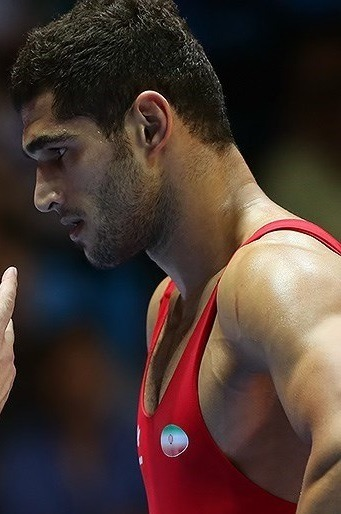


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: قد میربابک موسوی، ورزشکار والیبال چند است؟
نام انتخاب‌شده: میربابک موسوی
گزینهٔ پیش‌بینی‌شده: ۱٫۹۴
شاهد (بخش استخراج‌شده):
قد ایشان ۱٫۹۴ m (۶ ft۴۱⁄۲in) است


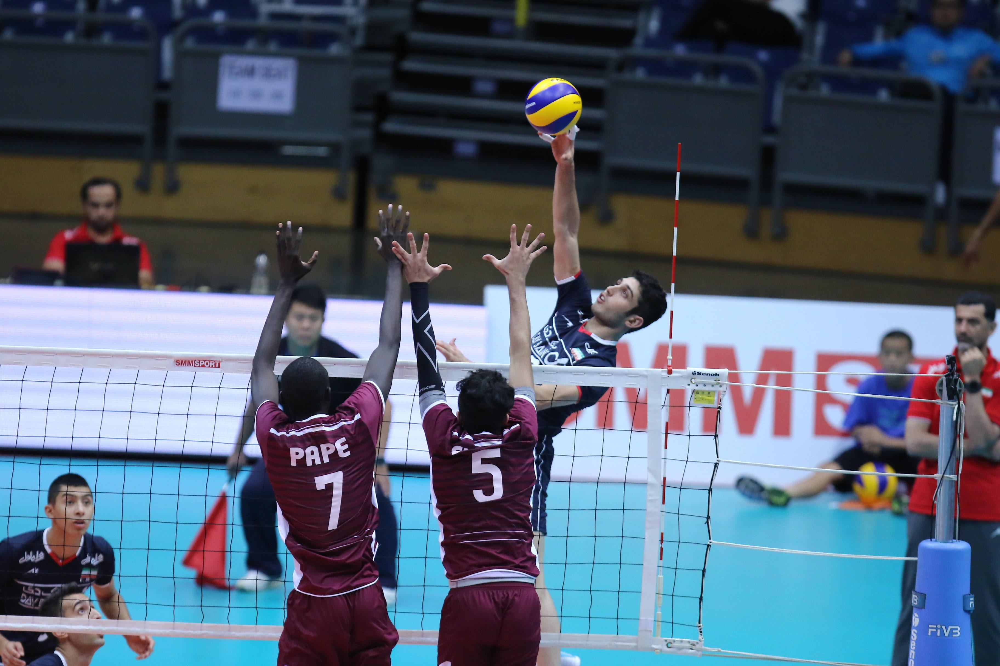


——————————————————————————————————————————————————————————————————————————————————————————
سؤال: کریم انصاری‌فرد در کدام کشور متولد شده است؟
نام انتخاب‌شده: کریم انصاری‌فرد
گزینهٔ پیش‌بینی‌شده: ایران
شاهد (بخش استخراج‌شده):
کریم انصاری‌فرد، ورزشکار فوتبال، در تاریخ ۱۴ فروردین ۱۳۶۹ (۳۵ سال) در اردبیل،ایران متولد شده است


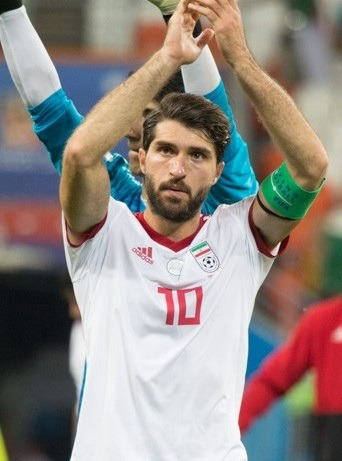

In [36]:
for r in out_rows:
    print("\n" + "—"*90)
    print("سؤال:", r["question"])
    print("نام انتخاب‌شده:", r["target_name"])
    print("گزینهٔ پیش‌بینی‌شده:", r["predicted_option"])
    print("شاهد (بخش استخراج‌شده):")
    print(r["evidence_span"] if r["evidence_span"] else "—")
    if r["image_path"]:
        try:
            display(IPImage(filename=r["image_path"]))
        except Exception:
            print(f"[تصویر در دسترس نیست] {r['image_path']}")
    else:
        print("[تصویر یافت نشد]")

# Generative phase for Multimodal (with image) questions set

In [41]:
import os, json, re, unicodedata, difflib
from pathlib import Path
import pandas as pd
from typing import List, Dict, Any
from IPython.display import display, Image as IPImage
from tqdm import tqdm
import httpx
from openai import OpenAI

In [42]:
BASE    = Path(os.getcwd() + "/Generative")
OUT_DIR = BASE / "rag_out"
OUT_DIR.mkdir(parents=True, exist_ok=True)

QA_JSON          = BASE / "qa_with_image_new.json"
RETR_TOP3_CSV    = OUT_DIR / "Multimodal_mcq_results_top3.csv"   # for top1_name
CATALOG_JSON     = BASE / "athlete_merged_with_bios_imaged_crawled.json"
IMAGES_DIR       = BASE / "athlete_images"
OUT_GEN_CSV      = OUT_DIR / "Multimodal_set_generative_outputs.csv"

print("Inputs exist:",
      QA_JSON.exists(), RETR_TOP3_CSV.exists(), CATALOG_JSON.exists(), IMAGES_DIR.exists())

Inputs exist: True True True True


In [62]:
ARABIC_TO_PERSIAN = str.maketrans({
    "ي":"ی","ك":"ک","ة":"ه","ۀ":"ه","ؤ":"و","إ":"ا","أ":"ا","ٱ":"ا","ى":"ی"
})
EASTERN_DIGITS = str.maketrans({
    "۰":"0","۱":"1","۲":"2","۳":"3","۴":"4","۵":"5","۶":"6","۷":"7","۸":"8","۹":"9",
    "٠":"0","١":"1","٢":"2","٣":"3","٤":"4","٥":"5","٦":"6","٧":"7","٨":"8","٩":"9",
})
CTRL_RE   = re.compile(r"[\u200c\u200d\u200e\u202a-\u202e]")
SEP_RE    = re.compile(r"[ \t\-\_]+")
NONAR_RE  = re.compile(r"[^0-9A-Za-z\u0600-\u06FF]+")
LATJUNK_RE= re.compile(r"\b(image|img|photo|avatar|value|crawled|face)\b", flags=re.I)

def norm_persian(s: str) -> str:
    if not isinstance(s, str): s = "" if s is None else str(s)
    s = s.translate(ARABIC_TO_PERSIAN)
    s = unicodedata.normalize("NFKC", s)
    s = s.translate(EASTERN_DIGITS)
    s = CTRL_RE.sub("", s)
    s = LATJUNK_RE.sub(" ", s)
    s = SEP_RE.sub(" ", s).strip()
    return s

def squeeze_letters(s: str) -> str:
    return NONAR_RE.sub("", s)

def tokens_ar(s: str):
    return [t for t in s.split() if t]

def build_image_index(img_dir: Path):
    IMG_EXTS = {".jpg",".jpeg",".png",".webp",".gif",".bmp",".tif",".tiff"}
    files = [p for p in Path(img_dir).iterdir() if p.is_file() and p.suffix.lower() in IMG_EXTS]
    index = []
    for p in files:
        stem = p.stem
        stem_core = re.sub(r"^\d+[ _-]*", "", stem)   # drop leading numeric ids
        nstem = norm_persian(stem_core)
        index.append({
            "path": str(p),
            "stem_norm": nstem,
            "stem_sq": squeeze_letters(nstem),
            "tokens": set(tokens_ar(nstem)),
        })
    return index

def make_query_variants(name: str):
    n = norm_persian(name)
    toks = tokens_ar(n)
    variants = set()
    for i, t in enumerate(toks):
        if t == "الله" and i > 0:
            variants.add(toks[i-1] + "الله")
    return {
        "norm": n,
        "sq": squeeze_letters(n),
        "tokens": set(toks) | variants | ({squeeze_letters("".join(toks))} if toks else set()),
    }

def score_match(qv, cand):
    if qv["sq"] and qv["sq"] == cand["stem_sq"]:
        return (0, 1.0)
    if qv["sq"] and (qv["sq"] in cand["stem_sq"] or cand["stem_sq"] in qv["sq"]):
        return (1, len(qv["sq"]) / max(1, len(cand["stem_sq"])))
    if qv["tokens"] and qv["tokens"].issubset(cand["tokens"]):
        return (2, len(qv["tokens"]) / max(1, len(cand["tokens"])))
    ratio = difflib.SequenceMatcher(None, qv["sq"], cand["stem_sq"]).ratio()
    if ratio >= 0.65:
        return (3, ratio)
    return (9, ratio)

def find_image_for_name(name: str, img_index) -> str:
    if not name: return ""
    qv = make_query_variants(name)
    best = None
    for cand in img_index:
        rk, rt = score_match(qv, cand)
        if best is None or (rk, rt, len(cand["stem_sq"])) < (best["rk"], best["rt"], len(best["stem_sq"])):
            best = {"rk": rk, "rt": rt, **cand}
    if best and (best["rk"] <= 2 or (best["rk"] == 3 and best["rt"] >= 0.8)):
        return best["path"]
    return ""

IMG_INDEX = build_image_index(IMAGES_DIR)

In [63]:
qa_items: List[Dict[str, Any]] = json.loads(QA_JSON.read_text(encoding="utf-8"))
retr_df: pd.DataFrame           = pd.read_csv(RETR_TOP3_CSV)
catalog: List[Dict[str, Any]]   = json.loads(CATALOG_JSON.read_text(encoding="utf-8"))

In [64]:
q2top1name = {
    (str(row["question"]).strip(), str(row["input_image_url"]).strip()): str(row["top1_name"]).strip()
    for _, row in retr_df.iterrows()
}
# optional: also a URL-only fallback map
url2top1name = {
    str(row["input_image_url"]).strip(): str(row["top1_name"]).strip()
    for _, row in retr_df.iterrows()
}

In [65]:
def normalize_text_field(x):
    if isinstance(x, str): return x
    if isinstance(x, list): return " | ".join([v for v in x if isinstance(v,str) and v.strip()])
    if isinstance(x, dict): return " | ".join([str(v) for v in x.values() if str(v).strip()])
    return "" if x is None else str(x)

In [66]:
name2summary: Dict[str,str] = {}
for r in catalog:
    nm = r.get("name","")
    if not nm: continue
    summ = normalize_text_field(r.get("summary","")).strip()
    if summ:
        prev = name2summary.get(nm, "")
        if len(summ) > len(prev):
            name2summary[nm] = summ

In [48]:
GAPGPT_API_KEY = "sk-vtrEXcBxhTAD0nJhr5zD7C0r9HGTscObM1EIQRkbPs195hza"
client = OpenAI(base_url="https://api.gapgpt.app/v1", api_key=GAPGPT_API_KEY)
MODEL  = "gpt-4o-mini"

In [49]:
response = client.chat.completions.create(
    model="gpt-4o",
    messages=[
        {"role": "user", "content": "سلام!"}
    ]
)

print(response.choices[0].message.content)

سلام! چطور می‌تونم کمکتون کنم؟ 😊


In [67]:
def call_api(messages: List[Dict[str,str]]) -> Dict[str,Any]:
    """Call GAPGPT and parse JSON. Falls back to raw text parse if needed."""
    try:
        resp = client.chat.completions.create(
            model=MODEL,
            messages=messages,
            temperature=0,
            response_format={"type":"json_object"}
        )
        txt = resp.choices[0].message.content
    except Exception as e:
        # retry once without response_format
        resp = client.chat.completions.create(
            model=MODEL,
            messages=messages,
            temperature=0
        )
        txt = resp.choices[0].message.content

    # Parse JSON robustly
    txt = (txt or "").strip()
    # If model wrapped code fences, strip them
    if txt.startswith("```"):
        txt = re.sub(r"^```(?:json)?\s*|\s*```$", "", txt, flags=re.DOTALL)

    try:
        obj = json.loads(txt)
    except Exception:
        # very rough fallback: try to extract a { ... } block
        m = re.search(r"\{.*\}", txt, flags=re.DOTALL)
        obj = json.loads(m.group(0)) if m else {"target_name":"","predicted_option":"","evidence_span":txt}
    # ensure keys exist
    obj.setdefault("target_name","")
    obj.setdefault("predicted_option","")
    obj.setdefault("evidence_span","")
    return obj

In [68]:
def build_prompt(top1_name: str, top1_summary: str, question: str, options: List[str]) -> List[Dict[str,str]]:
    # Your template:
    user_text = (
        "من یک سوال به مدل Multimodal RAG خود داده‌ام. اگر سوال فقط پرسیده است که تصویر مربوط به چه کسی است. "
        f"بگو تصویر مربوط به {top1_name or '—'} است. "
        "بیوگرافی مختصر او را هم از این متن بساز:\n"
        f"{top1_summary or '—'}\n"
        "اما اگر سوال چیزی به غیر از اینکه عکس مربوط به چه کسی است هم پرسیده بود لطفا از این متن جواب سوال را هم دربیاور:\n"
        f"{top1_summary or '—'}\n"
        "و در نهایت بگو که کدام گزینه از میان 4 گزینه درست است. "
        "در نهایت بخشی از متن را که شاهد و دلیل انتخاب گزینه است را هم بدون تغییر و توضیح اضافه بگو.\n\n"
        f"سوال:\n{question}\n\n"
        "گزینه ها:\n" + "\n".join(f"- {o}" for o in options) + "\n\n"
        "خروجی فقط JSON باشد با این کلیدها:\n"
        '{ "predicted_option": "...", "evidence": "...", "bio": "..." }'
    )
    return [
        {"role":"system", "content":"You are a helpful assistant. Respond ONLY in JSON."},
        {"role":"user",   "content": user_text}
    ]

In [69]:
QUESTION_LIMIT = 3
subset = qa_items[:QUESTION_LIMIT]

rows = []
for ex in tqdm(subset, desc=f"Generating (multimodal) first {QUESTION_LIMIT} questions "):
    q_text  = ex.get("question","").strip()
    options = list(ex.get("options", []))
    img_url = str(ex.get("image_url","")).strip()

    # LOOKUP with (question, image_url); then fall back to URL-only
    top1_name = q2top1name.get((q_text, img_url), "") or url2top1name.get(img_url, "")
    print(top1_name)
    top1_summary = name2summary.get(top1_name, "")

    msgs = build_prompt(top1_name, top1_summary, q_text, options)
    result = call_api(msgs)

    predicted_option = str(result.get("predicted_option","")).strip()
    evidence        = str(result.get("evidence","")).strip()
    bio_text        = str(result.get("bio","")).strip()

    # Ensure predicted_option matches one of the 4 (try normalized match)
    if predicted_option not in options:
        def norm(s):
            s = s.translate(ARABIC_TO_PERSIAN)
            s = unicodedata.normalize("NFKC", s)
            s = s.translate(EASTERN_DIGITS)
            return s.strip()
        opts_norm = [norm(o) for o in options]
        po_norm   = norm(predicted_option)
        if po_norm in opts_norm:
            predicted_option = options[opts_norm.index(po_norm)]

    # Find top-1 image by name
    image_path = find_image_for_name(top1_name, IMG_INDEX)

    rows.append({
        "question": q_text,
        "top1_name": top1_name,
        "top1_image_path": image_path,
        "predicted_option": predicted_option,
        "evidence": evidence,
        "bio": bio_text
    })

Generating (multimodal) first 3 questions :   0%|                                                | 0/3 [00:00<?, ?it/s]

علی دایی


Generating (multimodal) first 3 questions :  33%|█████████████▎                          | 1/3 [00:05<00:11,  5.66s/it]

امیر معماری


Generating (multimodal) first 3 questions :  67%|██████████████████████████▋             | 2/3 [00:07<00:03,  3.33s/it]

امیر عابدزاده


Generating (multimodal) first 3 questions : 100%|████████████████████████████████████████| 3/3 [00:13<00:00,  4.58s/it]


In [70]:
out_df = pd.DataFrame(rows, columns=["question","top1_name","top1_image_path","predicted_option","evidence","bio"])
out_df.to_csv(OUT_GEN_CSV, index=False, encoding="utf-8-sig")
print(f"\nSaved → {OUT_GEN_CSV}")


Saved → C:\Users\sinab\Desktop\NLP\HW3\Generative\rag_out\Multimodal_set_generative_outputs.csv



————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است؟
Top-1: علی دایی
گزینهٔ انتخابی: علی دایی
شاهد:
علی دایی، ورزشکار فوتبال، در تاریخ ۱ فروردین ۱۳۴۸ (۵۶ سال) در اردبیل متولد شده است، قد ایشان ۱٫۹۲ متر (۶ فوت ۴ اینچ) است، در تیم‌های استقلال اردبیل، تاکسیرانی، بانک تجارت، پرسپولیس، السد، آرمینیا بیله‌فلد، بایرن مونیخ، هرتابرلین، الشباب، پرسپولیس، صباباتری و سایپا بازی کرده است.


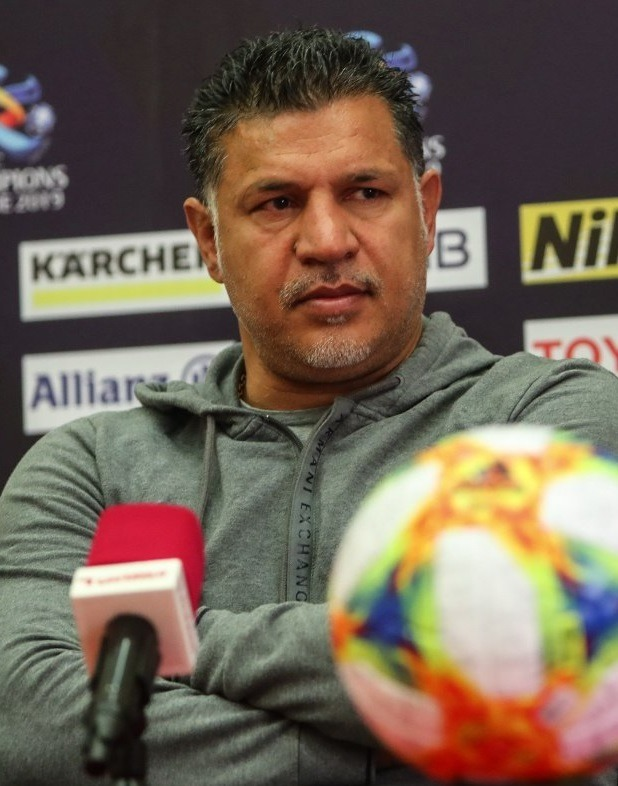


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است؟
Top-1: امیر معماری
گزینهٔ انتخابی: امیر عابدزاده، پرسپولیس
شاهد:
این چهره ی چه کسی است؟


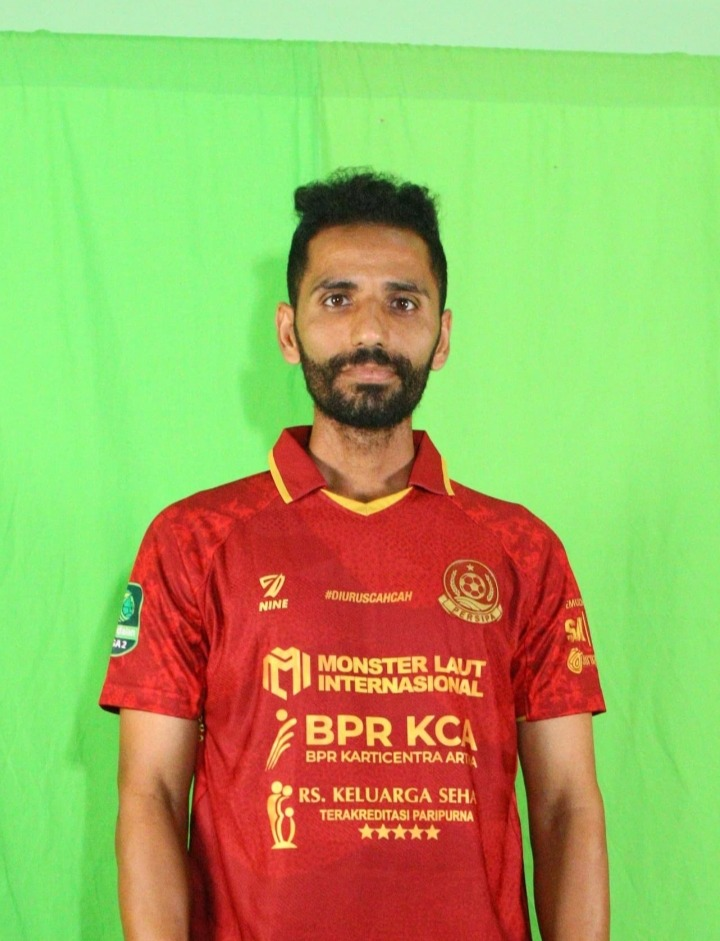


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است و در چه تیمی بازی کرده است؟
Top-1: امیر عابدزاده
گزینهٔ انتخابی: امیر عابدزاده، پرسپولیس
شاهد:
امیر عابدزاده، ورزشکار فوتبال، در تاریخ ۶ اردیبهشت ۱۳۷۲ (۳۲ سال)[۱] در تهران،ایران متولد شده است، قد ایشان ۱٫۸۵ متر (۶ فوت ۱ اینچ)[۱] است، در تیم‌های لس‌آنجلس بلوز، لس‌آنجلس، پرسپولیس، راه‌آهن، باریرنسه، ماریتیمو، پونفرادینا، ماریتیمو و کاستیون بازی کرده است.


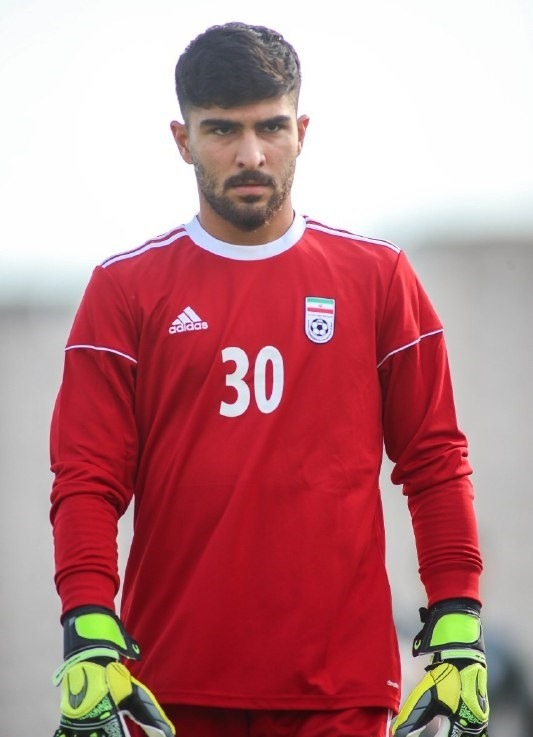

In [71]:
for r in rows:
    print("\n" + "—"*100)
    print("سؤال:", r["question"])
    print("Top-1:", r["top1_name"])
    print("گزینهٔ انتخابی:", r["predicted_option"])
    if r["evidence"]:
        print("شاهد:")
        print(r["evidence"])
    else:
        print("شاهد: —")
    if r["top1_image_path"]:
        try:
            display(IPImage(filename=r["top1_image_path"]))
        except Exception:
            print(f"[نمایش‌پذیر نیست] {r['top1_image_path']}")
    else:
        print("[تصویر یافت نشد]")

In [73]:
rows = []
for ex in tqdm(qa_items, desc=f"Generating (multimodal) "):
    q_text  = ex.get("question","").strip()
    options = list(ex.get("options", []))
    img_url = str(ex.get("image_url","")).strip()

    # LOOKUP with (question, image_url); then fall back to URL-only
    top1_name = q2top1name.get((q_text, img_url), "") or url2top1name.get(img_url, "")
    #print(top1_name)
    top1_summary = name2summary.get(top1_name, "")

    msgs = build_prompt(top1_name, top1_summary, q_text, options)
    result = call_api(msgs)

    predicted_option = str(result.get("predicted_option","")).strip()
    evidence        = str(result.get("evidence","")).strip()
    bio_text        = str(result.get("bio","")).strip()

    # Ensure predicted_option matches one of the 4 (try normalized match)
    if predicted_option not in options:
        def norm(s):
            s = s.translate(ARABIC_TO_PERSIAN)
            s = unicodedata.normalize("NFKC", s)
            s = s.translate(EASTERN_DIGITS)
            return s.strip()
        opts_norm = [norm(o) for o in options]
        po_norm   = norm(predicted_option)
        if po_norm in opts_norm:
            predicted_option = options[opts_norm.index(po_norm)]

    # Find top-1 image by name
    image_path = find_image_for_name(top1_name, IMG_INDEX)

    rows.append({
        "question": q_text,
        "top1_name": top1_name,
        "top1_image_path": image_path,
        "predicted_option": predicted_option,
        "evidence": evidence,
        "bio": bio_text
    })

Generating (multimodal) : 100%|████████████████████████████████████████████████████████| 20/20 [01:14<00:00,  3.74s/it]


In [74]:
out_df = pd.DataFrame(rows, columns=["question","top1_name","top1_image_path","predicted_option","evidence","bio"])
out_df.to_csv(OUT_GEN_CSV, index=False, encoding="utf-8-sig")
print(f"\nSaved → {OUT_GEN_CSV}")


Saved → C:\Users\sinab\Desktop\NLP\HW3\Generative\rag_out\Multimodal_set_generative_outputs.csv



————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است؟
Top-1: علی دایی
گزینهٔ انتخابی: علی دایی
شاهد:
علی دایی، ورزشکار فوتبال، در تاریخ ۱ فروردین ۱۳۴۸ (۵۶ سال) در اردبیل متولد شده است، قد ایشان ۱٫۹۲ متر (۶ فوت ۴ اینچ)[۱] است، در تیم‌های استقلال اردبیل، تاکسیرانی، بانک تجارت، پرسپولیس، السد، آرمینیا بیله‌فلد، بایرن مونیخ، هرتابرلین، الشباب، پرسپولیس، صباباتری و سایپا بازی کرده است.


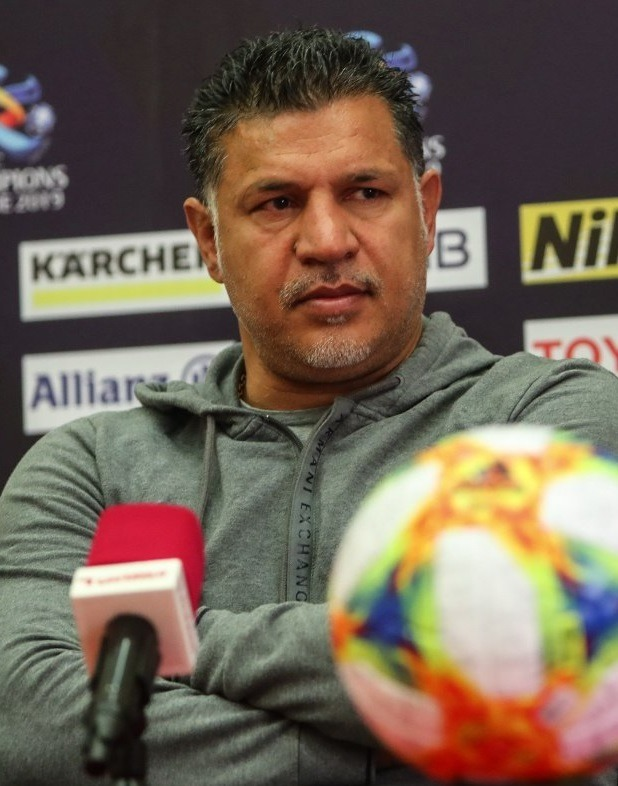


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است؟
Top-1: امیر معماری
گزینهٔ انتخابی: امیر یاوری
شاهد:
این چهره ی امیر یاوری است.


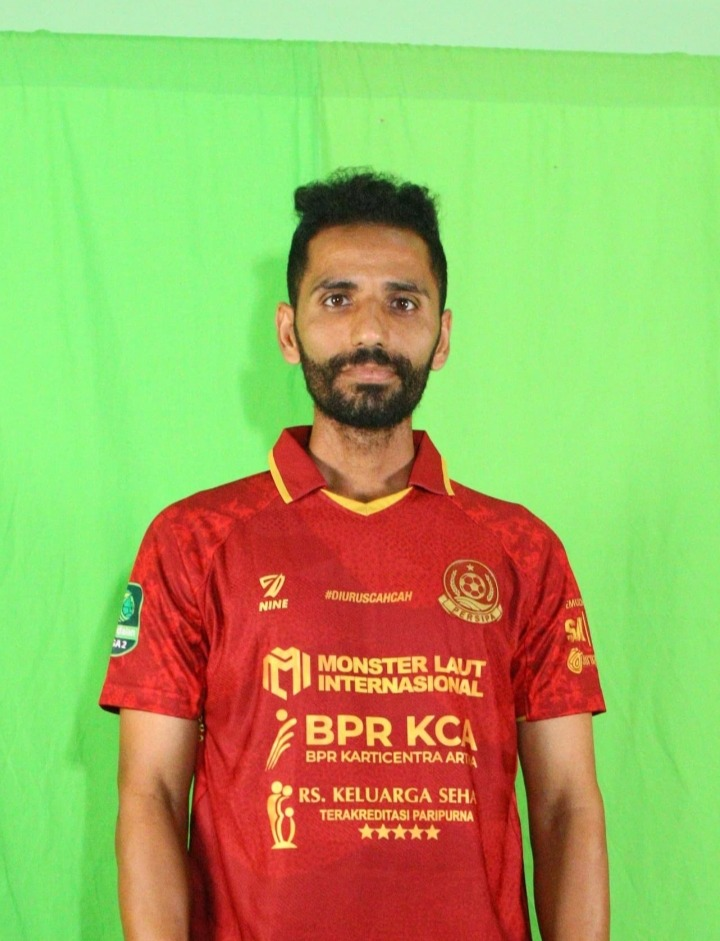


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است و در چه تیمی بازی کرده است؟
Top-1: امیر عابدزاده
گزینهٔ انتخابی: امیر عابدزاده، پرسپولیس
شاهد:
امیر عابدزاده، ورزشکار فوتبال، در تاریخ ۶ اردیبهشت ۱۳۷۲ (۳۲ سال) در تهران،ایران متولد شده است، قد ایشان ۱٫۸۵ متر (۶ فوت ۱ اینچ) است، در تیم‌های لس‌آنجلس بلوز، لس‌آنجلس، پرسپولیس، راه‌آهن، باریرنسه، ماریتیمو، پونفرادینا، ماریتیمو و کاستیون بازی کرده است.


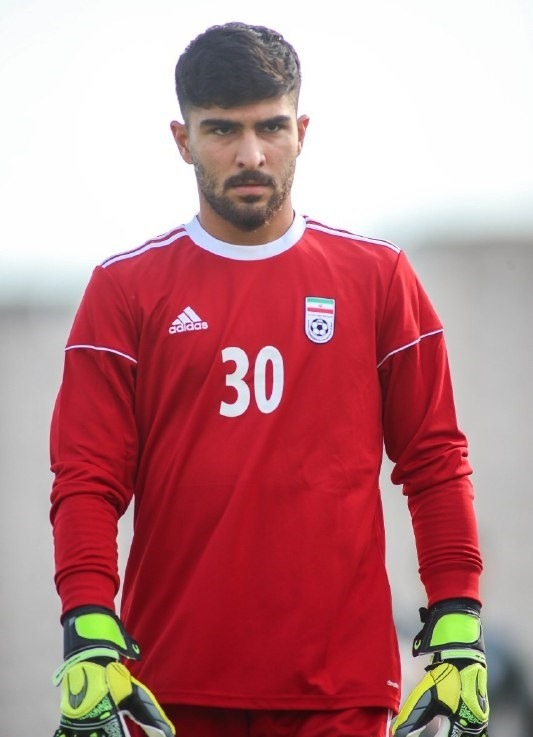


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است و در چه رشته ای فعالیت میکند؟
Top-1: رزیتا علی‌پور
گزینهٔ انتخابی: رزیتا علیپور، کاراته
شاهد:
رزیتا علی‌پور، متولد ۱۵ تیر ۱۳۶۸، کاراته‌کار در سبک کومیته با قد ۱٫۶۵ متر است که زیر نظر ستاره موسوی فعالیت می‌کند.


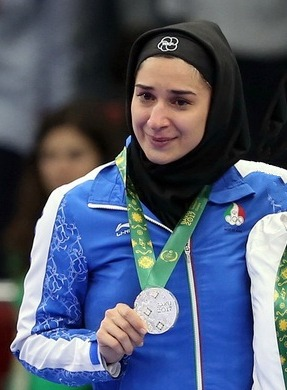


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است و در چه رشته ای فعالیت میکند؟
Top-1: حامد حدادی
گزینهٔ انتخابی: حامد حدادی ، بسکتبال
شاهد:
حامد حدادی، ورزشکار بسکتبال، در تاریخ ۲۹ اردیبهشت ۱۳۶۴ (۳۹ سال) در اهواز متولد شده است، قد ایشان ۷ فوت ۲ اینچ (۲٫۱۸ متر) است و وزن ایشان ۲۸۰ پوند (۱۲۷ کیلوگرم) است.


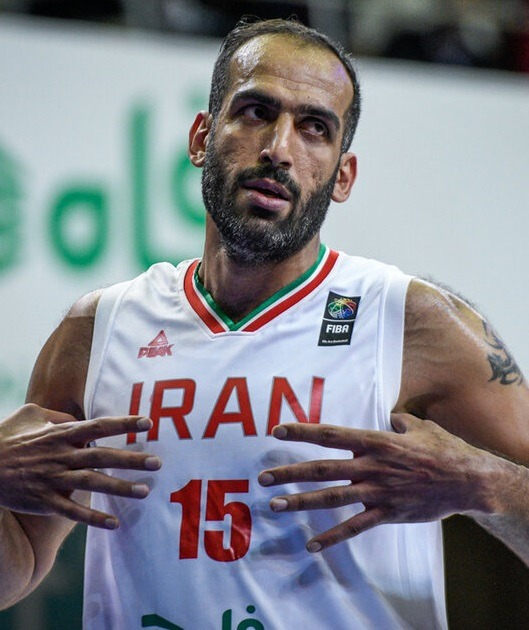


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است و در کجا متولد شده است؟
Top-1: بهروز مکوندی
گزینهٔ انتخابی: بهروز مکوندی، مسجدسلیمان
شاهد:
بهروز مکوندی، ورزشکار فوتبال، در تاریخ ۲۳ اوت ۱۹۶۳ (۶۱ سال) در مسجدسلیمان،ایران متولد شده است


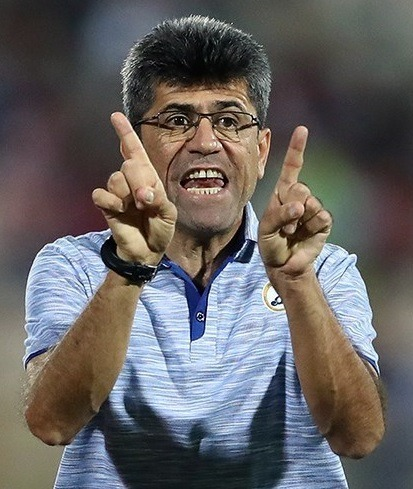


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این فرد چه کسی است و در چه تیمی بازی کرده است؟
Top-1: زهره کودایی
گزینهٔ انتخابی: زهره کودایی سپاهان
شاهد:
زهره کودایی، ورزشکار فوتبال، در تاریخ ۳ آذر ۱۳۶۸ در سپاهان متولد شده است، در تیم‌های شهرداری بم، شهرداری سنندج، پاس همدان، سپاهان و ذوب آهن بازی کرده است.


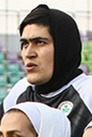


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این فرد چه کسی است؟
Top-1: رضا یزدانی
گزینهٔ انتخابی: رضا یزدانی
شاهد:
این فرد رضا یزدانی است.


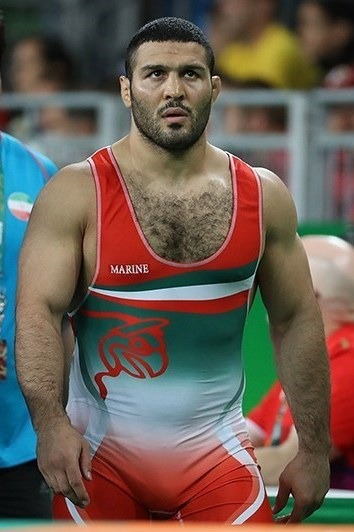


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این فرد چه کسی است و در چه رشته ای بازی میکند؟
Top-1: رضا حقیقی
گزینهٔ انتخابی: رضا حقیقی فوتبال
شاهد:
رضا حقیقی، ورزشکار فوتبال، در تاریخ ۱۲ بهمن ۱۳۶۷ (۳۶ سال) در پیام خراسان متولد شده است، قد ایشان ۱٫۹۳ متر (۶ فوت ۴ اینچ) است.


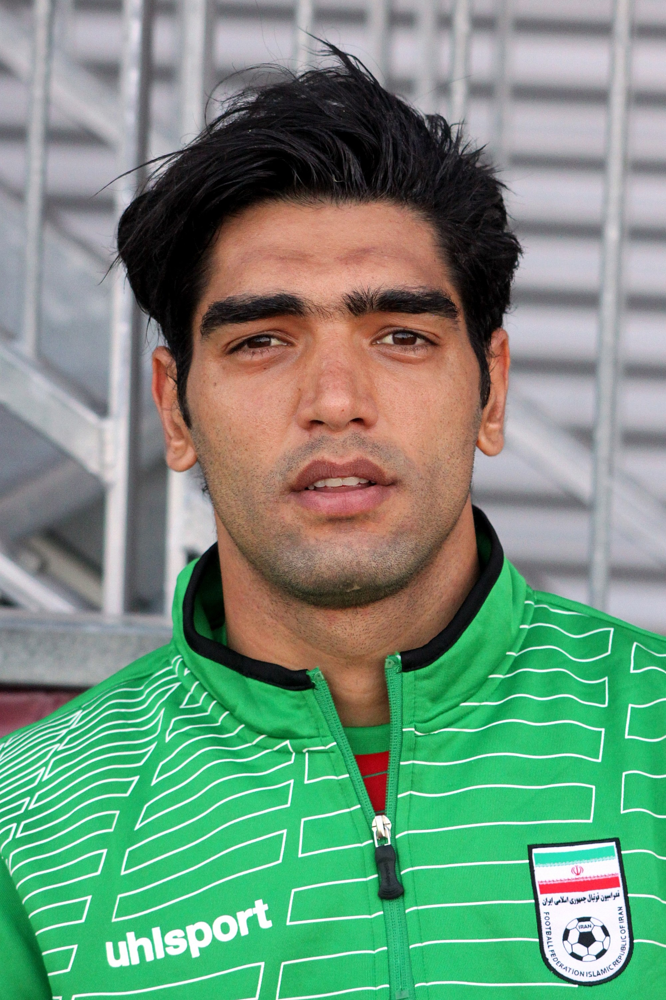


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این فرد چه کسی است و در کجا متولد شده است؟
Top-1: فرشاد احمدزاده
گزینهٔ انتخابی: فرشاد احمدزاده ارومیه
شاهد:
فرشاد احمدزاده، ورزشکار فوتبال، در تاریخ ۱ مهر ۱۳۷۱ (۳۲ سال) در ارومیه،ایران متولد شده است


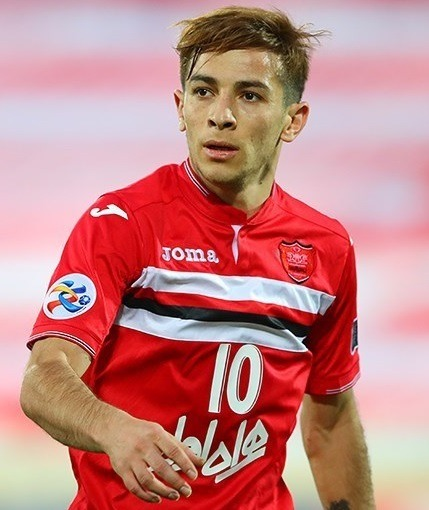


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: فردی که در تصویر است چه کسی است در چه تیم هایی بازی کرده است؟
Top-1: علیرضا منصوریان
گزینهٔ انتخابی: علیرضا منصوریان بالستیر گیلانگ
شاهد:
در تیم‌های پارس خودرو، استقلال تهران، بالستیر سنترال، گیلانگ یونایتد، استقلال تهران، اسکودا زانتی، آپولون اسمیرنیس، سن پائولی و استقلال تهران بازی کرده است.


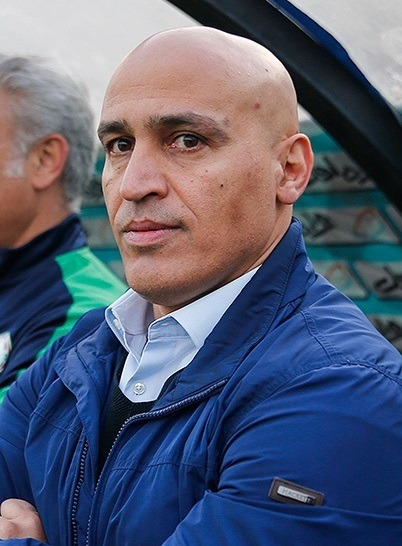


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این استادبزرگ شطرنج در کجا متولد  شده است؟
Top-1: سعید
گزینهٔ انتخابی: بابل
شاهد:
این استاد بزرگ شطرنج در بابل متولد شده است.


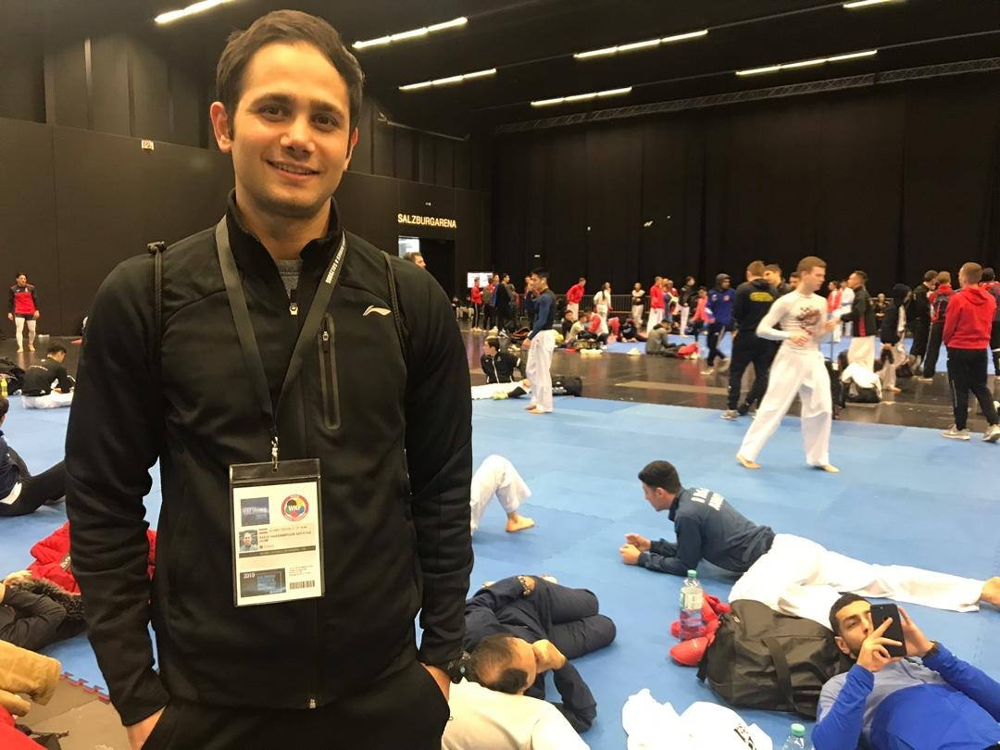


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: نام و رشته ی ورزشی این فرد چیست؟
Top-1: حامد رشیدی
گزینهٔ انتخابی: آریا داوری کشتی
شاهد:
حامد رشیدی، ورزشکار کشتی، در تاریخ کرمانشاه در ، متولد شده است، افتخارات مدال طلا جام جهانی کشتی جام جهانی کشتی ۲۰۱۷ کرمانشاه، مدال برنز جام جهانی کشتی قهرمانی کشتی دانشجویان جهان ۲۰۱۸ ترکیه، مدال نقره جام جهانی کشتی مسابقات قهرمانی کشتی نظامیان جهان۲۰۱۸ مسکو و مدال برنز قهرمانی کشتی آسیا ۲۰۱۷ دهلی نو را کسب کرده است.


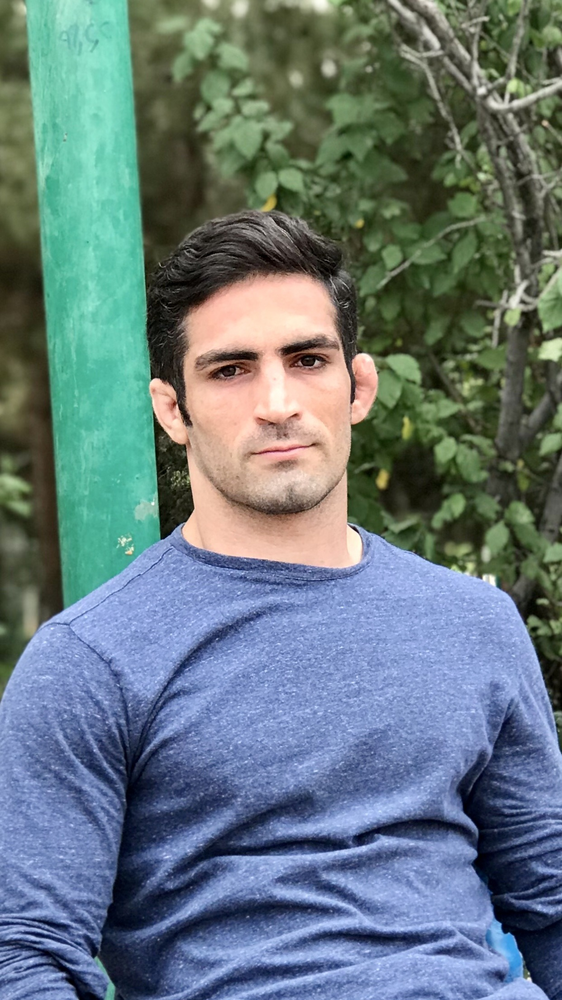


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: نام و سن این فرد چیست؟
Top-1: ارسلان مطهری
گزینهٔ انتخابی: حمید استیلی 44 سال
شاهد:
حمید استیلی 44 سال


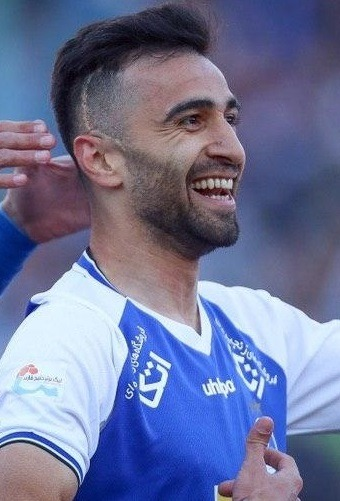


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: فردی که در تصویر است چه کسی است؟
Top-1: علی شفیعی
گزینهٔ انتخابی: علی شفیعی
شاهد:
علی شفیعی، متولد ۳۰ شهریور ۱۳۷۰ در آمل، مازندران، ایران، سرعتی‌زن و مدافع وسط والیبال با قد ۱٫۹۸ متر و وزن ۹۵ کیلوگرم است.


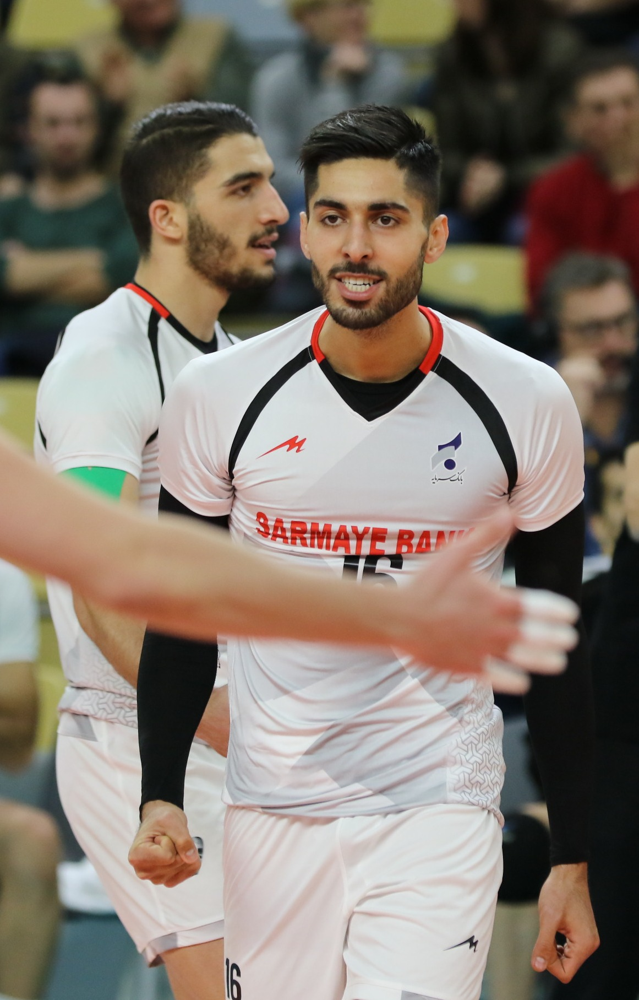


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: نام و رشته ی ورزشی این فرد چیست؟
Top-1: الهام فلاح
گزینهٔ انتخابی: الهام فلاح والیبال
شاهد:
الهام فلاح، ورزشکار والیبال، در تاریخ ۲۵ فروردین ۱۳۷۳ (۳۱ سال)شیراز در تیم ملی بزرگسالان ایران متولد شده است،


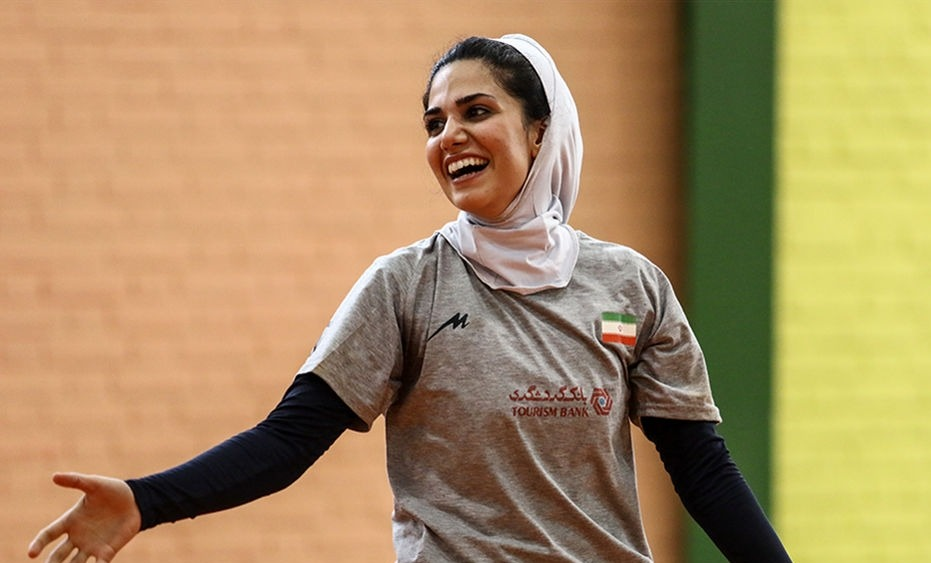


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: کدام گزینه درباره ی این فرد صحیح است؟
Top-1: علی انصاریان
گزینهٔ انتخابی: این فرد علی انصاریان است و در تیم استقلال بازی کرده است.
شاهد:
در تیم‌های فجر سپاسی، پرسپولیس، سایپا، پرسپولیس، استقلال، استیل‌آذین، استقلال اهواز، گسترش فولاد، شهرداری تبریز و شاهین بوشهر بازی کرده است.


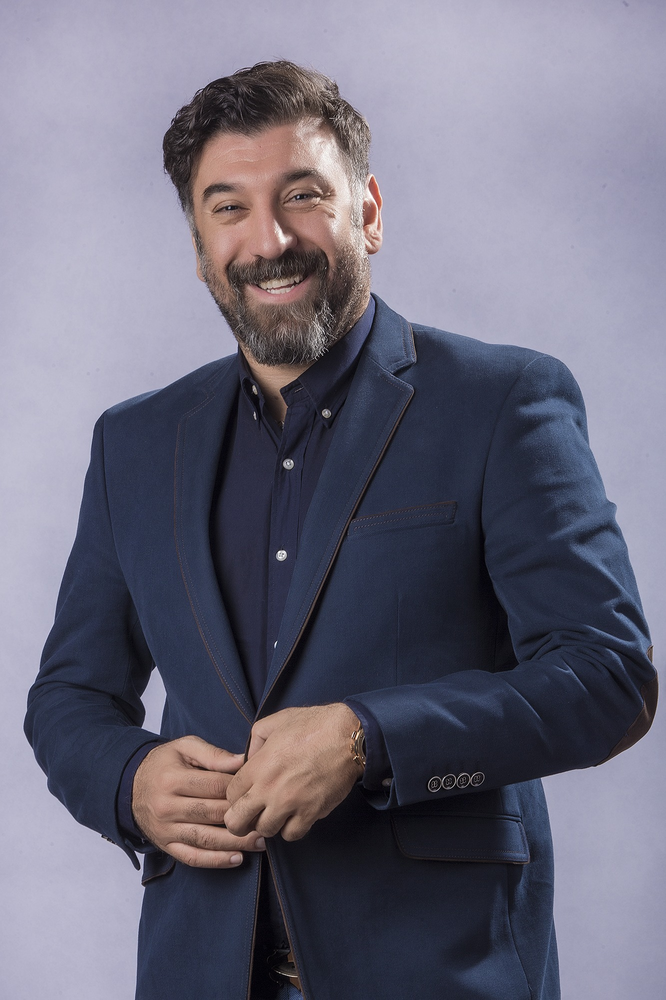


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است و در کجا متولد شده است؟
Top-1: احسان علوان‌زاده
گزینهٔ انتخابی: احسان علوانزاده خوزستان
شاهد:
احسان علوان‌زاده، ورزشکار فوتبال، در تاریخ ۲۹ فروردین ۱۳۷۳ (۳۱ سال) در دزفول، خوزستان،ایران متولد شده است


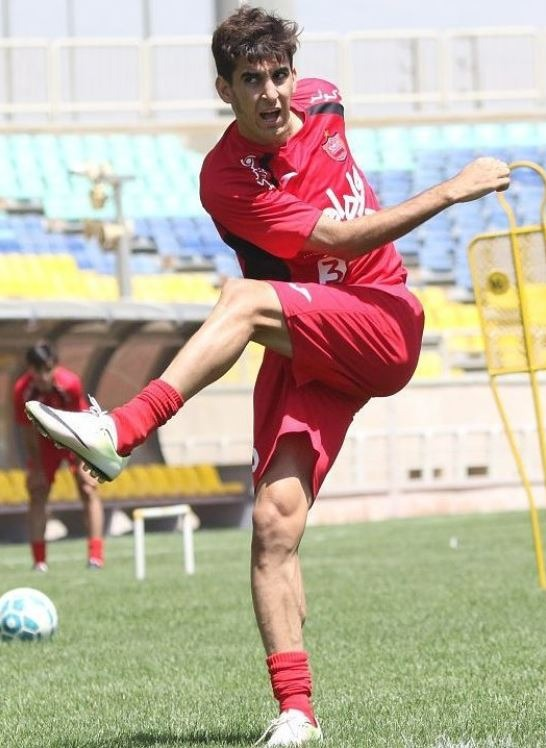


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: نام و رشته ی ورزشی این فرد چیست؟
Top-1: رامین رضاییان
گزینهٔ انتخابی: رامین رضاییان فوتبال
شاهد:
رامین رضاییان، ورزشکار فوتبال، در تاریخ ۱ فروردین ۱۳۶۹ (۳۵ سال) در سمسکنده علیا،ساری، مازندران،ایران متولد شده است، قد ایشان ۱٫۸۴ متر (۶ فوت۱⁄۲اینچ) است، در تیم‌های صبای قم، راه‌آهن، پرسپولیس، اوستنده، الشحانیه، الدحیل، ←السیلیه(قرضی)، پرسپولیس، سپاهان و استقلال بازی کرده است.


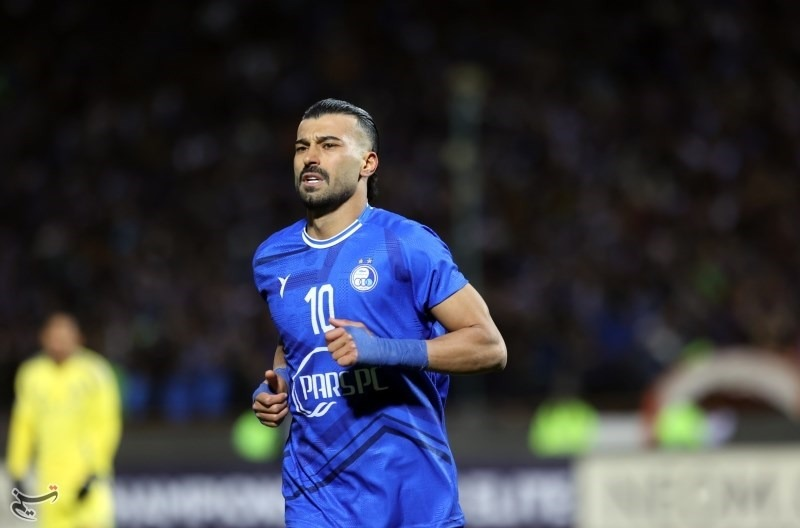


————————————————————————————————————————————————————————————————————————————————————————————————————
سؤال: این چهره ی چه کسی است؟
Top-1: رحمان احمدی
گزینهٔ انتخابی: رحمان احمدی
شاهد:
رحمان احمدی، ورزشکار فوتبال، در تاریخ ۸ مرداد ۱۳۵۹ (۴۴ سال) در نوشهر،ایران متولد شده است، قد ایشان ۱٫۸۴ متر (۶ فوت۱⁄۲اینچ) است.


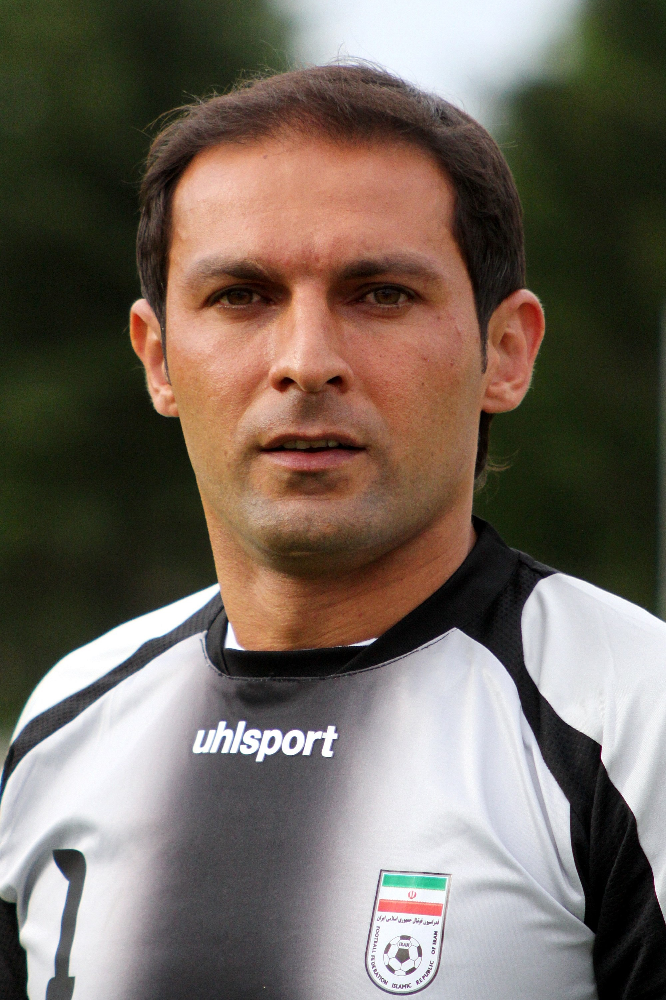

In [75]:
for r in rows:
    print("\n" + "—"*100)
    print("سؤال:", r["question"])
    print("Top-1:", r["top1_name"])
    print("گزینهٔ انتخابی:", r["predicted_option"])
    if r["evidence"]:
        print("شاهد:")
        print(r["evidence"])
    else:
        print("شاهد: —")
    if r["top1_image_path"]:
        try:
            display(IPImage(filename=r["top1_image_path"]))
        except Exception:
            print(f"[نمایش‌پذیر نیست] {r['top1_image_path']}")
    else:
        print("[تصویر یافت نشد]")

# Evaluation

In [121]:
import os, json, re, unicodedata
from pathlib import Path
from typing import List, Dict, Any
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [122]:
BASE    = Path(os.getcwd() + "/Generative")
OUT_DIR = BASE / "rag_out/"
EVAL_DIR = BASE / "rag_out/evaluation/"
OUT_DIR.mkdir(parents=True, exist_ok=True)

TEXT_Q_JSON   = BASE / "mcq_questions_full_new.json"
TEXT_GEN_CSV  = OUT_DIR / "Text_set_generative_outputs.csv"

MULTI_Q_JSON  = BASE / "qa_with_image_new.json"
MULTI_GEN_CSV = OUT_DIR / "Multimodal_set_generative_outputs.csv"
RETR_TOP3_CSV = OUT_DIR / "Multimodal_mcq_results_top3.csv"

print("Exists:",
      "\n  TEXT_Q_JSON:", TEXT_Q_JSON.exists(),
      "\n  TEXT_GEN_CSV:", TEXT_GEN_CSV.exists(),
      "\n  MULTI_Q_JSON:", MULTI_Q_JSON.exists(),
      "\n  MULTI_GEN_CSV:", MULTI_GEN_CSV.exists(),
      "\n  RETR_TOP3_CSV:", RETR_TOP3_CSV.exists())

Exists: 
  TEXT_Q_JSON: True 
  TEXT_GEN_CSV: True 
  MULTI_Q_JSON: True 
  MULTI_GEN_CSV: True 
  RETR_TOP3_CSV: True


In [123]:
ARABIC_TO_PERSIAN = str.maketrans({
    "ي":"ی","ك":"ک","ة":"ه","ۀ":"ه","ؤ":"و","إ":"ا","أ":"ا","ٱ":"ا","ى":"ی"
})
EASTERN_DIGITS = str.maketrans({
    "۰":"0","۱":"1","۲":"2","۳":"3","۴":"4","۵":"5","۶":"6","۷":"7","۸":"8","۹":"9",
    "٠":"0","١":"1","٢":"2","٣":"3","٤":"4","٥":"5","٦":"6","٧":"7","٨":"8","٩":"9",
})
CTRL_RE = re.compile(r"[\u200c\u200d\u200e\u202a-\u202e]")

def norm_str(s: str) -> str:
    if not isinstance(s, str):
        s = "" if s is None else str(s)
    s = s.translate(ARABIC_TO_PERSIAN)
    s = unicodedata.normalize("NFKC", s)
    s = s.translate(EASTERN_DIGITS)
    s = CTRL_RE.sub("", s)
    s = re.sub(r"\s+", " ", s).strip()
    return s

def eq_norm(a: str, b: str) -> bool:
    return norm_str(a) == norm_str(b)

In [124]:
def categorize_question(q: str) -> str:
    qn = norm_str(q)
    # Priority-ordered, pick the first that matches
    if re.search(r"(چه کسی|کیست|چه کسى|چه شخصی|چه فردی)", qn): return "who"
    if re.search(r"(کجا|در کجا|زادگاه|متولد|شهر|استان)", qn):  return "where/birthplace"
    if re.search(r"(چه سالی|سال تولد|سن|چند سال)", qn):        return "when/age"
    if re.search(r"(رشته|ورزشی|فعالیت میکند|ورزش)", qn):       return "sport"
    if re.search(r"(تیم|باشگاه|بازی کرده|بازی میکند)", qn):    return "team/club"
    if re.search(r"(کدام گزینه|درست است|صحیح است)", qn):       return "which-option"
    return "other"

In [125]:
text_q = json.loads(TEXT_Q_JSON.read_text(encoding="utf-8"))
text_q_df = pd.DataFrame(text_q)
assert {"question","answer"}.issubset(text_q_df.columns), "Text questions JSON missing fields."

text_pred_df = pd.read_csv(TEXT_GEN_CSV, dtype=str, keep_default_na=False)
# Expected cols: question,target_name,predicted_option,evidence_span,image_path
for col in ["question","predicted_option"]:
    if col not in text_pred_df.columns:
        raise KeyError(f"Missing column in Text_set_generative_outputs.csv: {col}")

# Merge on normalized question
text_q_df["_key"]      = text_q_df["question"].map(norm_str)
text_pred_df["_key"]   = text_pred_df["question"].map(norm_str)

# If duplicates, keep first occurrence per key in preds (or aggregate later)
text_pred_first = text_pred_df.drop_duplicates("_key", keep="first")

text_eval = text_q_df.merge(text_pred_first[["_key","predicted_option","evidence_span","target_name","image_path"]],
                            on="_key", how="left")
text_eval["predicted_option"] = text_eval["predicted_option"].fillna("")

# metrics
text_eval["is_correct"] = [eq_norm(p, a) for p, a in zip(text_eval["predicted_option"], text_eval["answer"])]
text_eval["category"]   = text_eval["question"].map(categorize_question)
text_eval["has_evidence"] = text_eval.get("evidence_span","").astype(str).str.strip().ne("")
# does evidence span include gold answer?
def contains_gold(e, a): 
    e = norm_str(e); a = norm_str(a)
    return bool(a) and a in e
text_eval["evidence_mentions_gold"] = [contains_gold(e, a) for e, a in zip(text_eval.get("evidence_span",""), text_eval["answer"])]

In [126]:
multi_q = json.loads(MULTI_Q_JSON.read_text(encoding="utf-8"))
multi_q_df = pd.DataFrame(multi_q)
assert {"question","answer","image_url"}.issubset(multi_q_df.columns), "Multimodal questions JSON missing fields."

multi_pred_df = pd.read_csv(MULTI_GEN_CSV, dtype=str, keep_default_na=False)
# Expected cols: question,top1_name,top1_image_path,predicted_option,evidence,bio
for col in ["question","top1_name","predicted_option"]:
    if col not in multi_pred_df.columns:
        raise KeyError(f"Missing column in Multimodal_set_generative_outputs.csv: {col}")

retr_df = pd.read_csv(RETR_TOP3_CSV, dtype=str, keep_default_na=False)
# Use retrieval file to recover image_url per (question, top1_name)
retr_pick = retr_df[["question","top1_name","input_image_url"]].copy() if "input_image_url" in retr_df.columns else retr_df.rename(columns={"input_image_url":"image_url"})
if "input_image_url" not in retr_pick.columns and "image_url" not in retr_pick.columns:
    # some earlier scripts named it 'input_image_url'
    if "input_image_url" in retr_df.columns:
        retr_pick = retr_df.rename(columns={"input_image_url":"image_url"})[["question","top1_name","image_url"]]
    else:
        raise KeyError("Retrieval CSV must include 'input_image_url' (or 'image_url').")

if "image_url" not in retr_pick.columns:
    retr_pick = retr_pick.rename(columns={"input_image_url":"image_url"})

# Normalize merge keys
multi_pred_df["_q"] = multi_pred_df["question"].map(norm_str)
multi_pred_df["_n"] = multi_pred_df["top1_name"].map(norm_str)
retr_pick["_q"]     = retr_pick["question"].map(norm_str)
retr_pick["_n"]     = retr_pick["top1_name"].map(norm_str)

# Merge to get image_url
multi_tmp = multi_pred_df.merge(retr_pick[["_q","_n","image_url"]].drop_duplicates(), on=["_q","_n"], how="left")
# Now merge with golds using (question, image_url)
multi_tmp["_q2"] = multi_tmp["question"].map(norm_str)
multi_tmp["_u2"] = multi_tmp["image_url"].map(norm_str)

multi_q_df["_q2"] = multi_q_df["question"].map(norm_str)
multi_q_df["_u2"] = multi_q_df["image_url"].map(norm_str)

multi_eval = multi_tmp.merge(multi_q_df[["_q2","_u2","answer"]].drop_duplicates(), on=["_q2","_u2"], how="left")
multi_eval["predicted_option"] = multi_eval["predicted_option"].fillna("")
multi_eval["is_correct"] = [eq_norm(p, a) for p, a in zip(multi_eval["predicted_option"], multi_eval["answer"])]
multi_eval["category"]   = multi_eval["question"].map(categorize_question)
multi_eval["has_evidence"] = multi_eval.get("evidence","").astype(str).str.strip().ne("")
def contains_gold_multi(e, a): 
    e = norm_str(e); a = norm_str(a)
    return bool(a) and a in e
multi_eval["evidence_mentions_gold"] = [contains_gold_multi(e, a) for e, a in zip(multi_eval.get("evidence",""), multi_eval["answer"])]

In [127]:
def summarize(df: pd.DataFrame, label: str) -> Dict[str, Any]:
    n = len(df)
    acc = float(df["is_correct"].mean()) if n else 0.0
    ev_rate = float(df["has_evidence"].mean()) if n else 0.0
    ev_gold = float(df["evidence_mentions_gold"].mean()) if n else 0.0
    by_cat = df.groupby("category")["is_correct"].mean().sort_values(ascending=False)
    return {"set": label, "n": n, "accuracy": round(acc, 4),
            "evidence_present_rate": round(ev_rate, 4),
            "evidence_mentions_gold_rate": round(ev_gold, 4),
            "by_category": by_cat}

text_sum  = summarize(text_eval, "text")
multi_sum = summarize(multi_eval, "multimodal")

In [128]:
text_eval_out  = OUT_DIR / "text_eval_detailed.csv"
multi_eval_out = OUT_DIR / "multi_eval_detailed.csv"
text_eval.to_csv(text_eval_out, index=False, encoding="utf-8-sig")
multi_eval.to_csv(multi_eval_out, index=False, encoding="utf-8-sig")

In [129]:
def top_confusions(df: pd.DataFrame, k=25):
    tmp = df.copy()
    tmp["gold"] = tmp["answer"].fillna("").map(norm_str)
    tmp["pred"] = tmp["predicted_option"].fillna("").map(norm_str)
    conf = (tmp[tmp["gold"]!=tmp["pred"]]
            .groupby(["gold","pred"])
            .size()
            .reset_index(name="count")
            .sort_values("count", ascending=False)
            .head(k))
    return conf

conf_text  = top_confusions(text_eval, 25)
conf_multi = top_confusions(multi_eval, 25)
conf_text.to_csv(EVAL_DIR / "confusions_text.csv", index=False, encoding="utf-8-sig")
conf_multi.to_csv(EVAL_DIR / "confusions_multi.csv", index=False, encoding="utf-8-sig")

In [130]:
summary_rows = [
    {"set":"text",
     "n": text_sum["n"],
     "accuracy": text_sum["accuracy"],
     "evidence_present_rate": text_sum["evidence_present_rate"],
     "evidence_mentions_gold_rate": text_sum["evidence_mentions_gold_rate"]},
    {"set":"multimodal",
     "n": multi_sum["n"],
     "accuracy": multi_sum["accuracy"],
     "evidence_present_rate": multi_sum["evidence_present_rate"],
     "evidence_mentions_gold_rate": multi_sum["evidence_mentions_gold_rate"]},
]
summary_df = pd.DataFrame(summary_rows)
summary_df.to_csv(EVAL_DIR / "eval_summary.csv", index=False, encoding="utf-8-sig")
print("Saved:",
      f"\n  {text_eval_out.name}",
      f"\n  {multi_eval_out.name}",
      "\n  confusions_text.csv",
      "\n  confusions_multi.csv",
      "\n  eval_summary.csv")

Saved: 
  text_eval_detailed.csv 
  multi_eval_detailed.csv 
  confusions_text.csv 
  confusions_multi.csv 
  eval_summary.csv


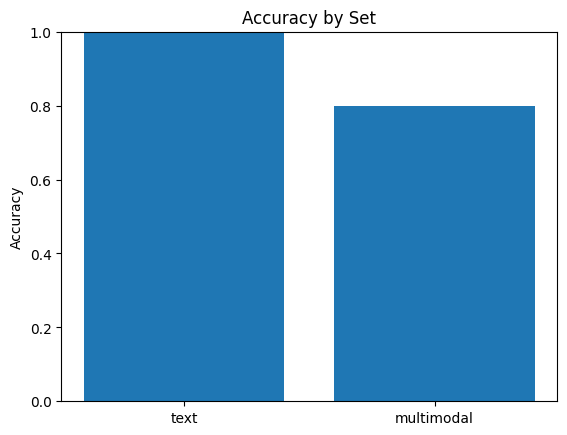

In [131]:
plt.figure()
plt.bar(summary_df["set"], summary_df["accuracy"])
plt.title("Accuracy by Set")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.savefig(EVAL_DIR / "accuracy_overview.png", bbox_inches="tight", dpi=150)
plt.show()

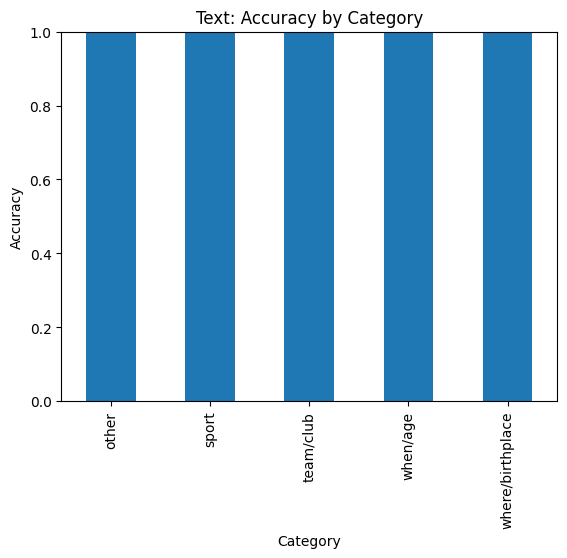

In [132]:
tcat = (text_eval.groupby("category")["is_correct"].mean().sort_values(ascending=False) if len(text_eval) else pd.Series(dtype=float))
plt.figure()
tcat.plot(kind="bar")
plt.title("Text: Accuracy by Category")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.xlabel("Category")
plt.savefig(EVAL_DIR / "text_accuracy_by_category.png", bbox_inches="tight", dpi=150)
plt.show()

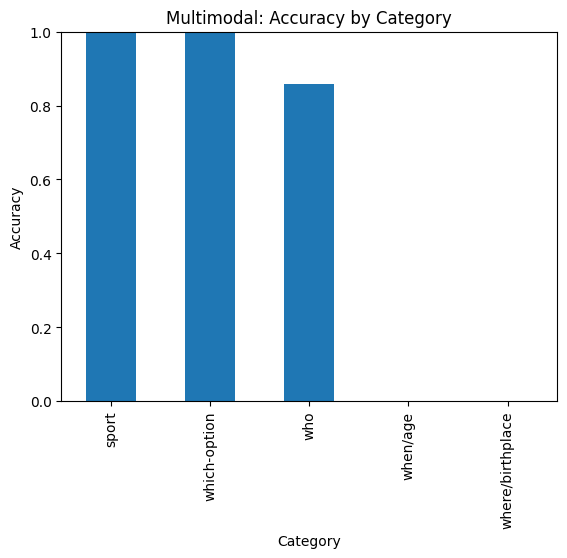

In [133]:
mcat = (multi_eval.groupby("category")["is_correct"].mean().sort_values(ascending=False) if len(multi_eval) else pd.Series(dtype=float))
plt.figure()
mcat.plot(kind="bar")
plt.title("Multimodal: Accuracy by Category")
plt.ylabel("Accuracy")
plt.ylim(0, 1)
plt.xlabel("Category")
plt.savefig(EVAL_DIR / "multi_accuracy_by_category.png", bbox_inches="tight", dpi=150)
plt.show()

In [134]:
def pct(x): return f"{x*100:.1f}%"
print("\n=== EVALUATION SUMMARY ===")
print(summary_df.to_string(index=False))
if len(tcat):
    print("\nText by category:")
    print((tcat.apply(pct)).to_string())
if len(mcat):
    print("\nMultimodal by category:")
    print((mcat.apply(pct)).to_string())

print("\nArtifacts saved in:", EVAL_DIR)


=== EVALUATION SUMMARY ===
       set  n  accuracy  evidence_present_rate  evidence_mentions_gold_rate
      text 48       1.0                    1.0                       0.8125
multimodal 20       0.8                    1.0                       0.2000

Text by category:
category
other               100.0%
sport               100.0%
team/club           100.0%
when/age            100.0%
where/birthplace    100.0%

Multimodal by category:
category
sport               100.0%
which-option        100.0%
who                  85.7%
when/age              0.0%
where/birthplace      0.0%

Artifacts saved in: C:\Users\sinab\Desktop\NLP\HW3\Generative\rag_out\evaluation


In [135]:
text_cat_counts  = (text_eval["category"].value_counts()
                    .rename_axis("category").reset_index(name="count"))
multi_cat_counts = (multi_eval["category"].value_counts()
                    .rename_axis("category").reset_index(name="count"))

In [136]:
text_cat_counts.to_csv(EVAL_DIR / "text_category_counts.csv",  index=False, encoding="utf-8-sig")
multi_cat_counts.to_csv(EVAL_DIR / "multi_category_counts.csv", index=False, encoding="utf-8-sig")

In [137]:
both_counts = pd.concat([
    text_cat_counts.assign(set="text"),
    multi_cat_counts.assign(set="multimodal")
], ignore_index=True)
both_counts.to_csv(EVAL_DIR / "category_counts_both.csv", index=False, encoding="utf-8-sig")

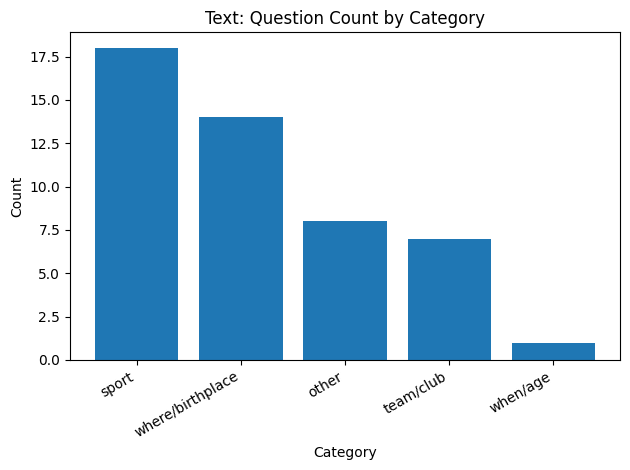

In [138]:
plt.figure()
plt.bar(text_cat_counts["category"], text_cat_counts["count"])
plt.title("Text: Question Count by Category")
plt.ylabel("Count")
plt.xlabel("Category")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(EVAL_DIR / "text_category_counts.png", dpi=150)
plt.show()

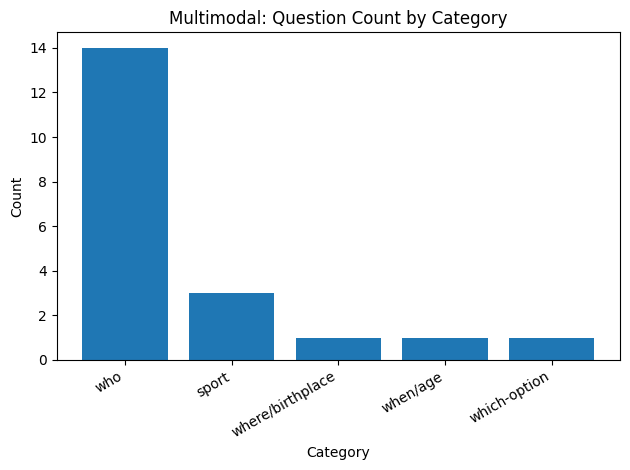

In [139]:
plt.figure()
plt.bar(multi_cat_counts["category"], multi_cat_counts["count"])
plt.title("Multimodal: Question Count by Category")
plt.ylabel("Count")
plt.xlabel("Category")
plt.xticks(rotation=30, ha="right")
plt.tight_layout()
plt.savefig(EVAL_DIR / "multi_category_counts.png", dpi=150)
plt.show()

In [140]:
print("\nCategory counts — Text:")
print(text_cat_counts.to_string(index=False))
print("\nCategory counts — Multimodal:")
print(multi_cat_counts.to_string(index=False))


Category counts — Text:
        category  count
           sport     18
where/birthplace     14
           other      8
       team/club      7
        when/age      1

Category counts — Multimodal:
        category  count
             who     14
           sport      3
where/birthplace      1
        when/age      1
    which-option      1
